In [1]:
import numpy as np
import pandas as pd
import tensorflow as tf
import tensorflow.keras as keras
from tensorflow.keras.utils import plot_model
import matplotlib.pyplot as plt
from tensorflow.keras.datasets import mnist
from tensorflow.keras.layers import Dense, Reshape, Flatten, BatchNormalization, LeakyReLU, Dropout, Input, Conv2DTranspose, Conv2D
from tensorflow.keras.models import Sequential, load_model
import tensorflow.keras.backend as K
from keras import Model, Input, callbacks
from keras.metrics import Mean
from tensorflow.keras.optimizers import Adam

In [2]:
ROWS = 28
COLS = 28
CHANNELS = 1
IMG_SHAPE = (ROWS, COLS, CHANNELS)
BATCH_SIZE = 128
NOISE_SIZE = 32
EPOCHS = 50
EPOCHS_TO_SAVE = 3

In [3]:
def show_images(images, n_cols, title, filename):
    n_rows = (len(images) - 1) // n_cols + 1
    
    fig = plt.figure(figsize = (n_cols, n_rows))
    for index, img in enumerate(images):
        plt.subplot(n_rows, n_cols, index + 1)
        plt.imshow(img, cmap = "binary")
        plt.axis("off")
    plt.suptitle(title)
    
    fig.savefig(filename +".png")
    plt.show()

In [4]:
def prepare_mnist_dataset():
    (x_train, y_train), (x_test, y_test) = mnist.load_data()
    
    x_full = np.concatenate([x_train, x_test])
    y_full = np.concatenate([y_train, y_test])
    
    x_full = x_full.astype(np.float32) / 255
    x_full = x_full.reshape(-1, 28, 28, 1) * 2. - 1.
    
    return x_full, y_full

In [5]:
def prepare_mnist_batch(x_full, y_full,  num_label, batch_size):
    x_label = x_full[np.where(y_full == num_label)]
    
    dataset = tf.data.Dataset.from_tensor_slices(x_label)
    dataset = dataset.shuffle(1024)
    
    dataset = dataset.batch(batch_size, drop_remainder = True).prefetch(1) 
    
    return dataset

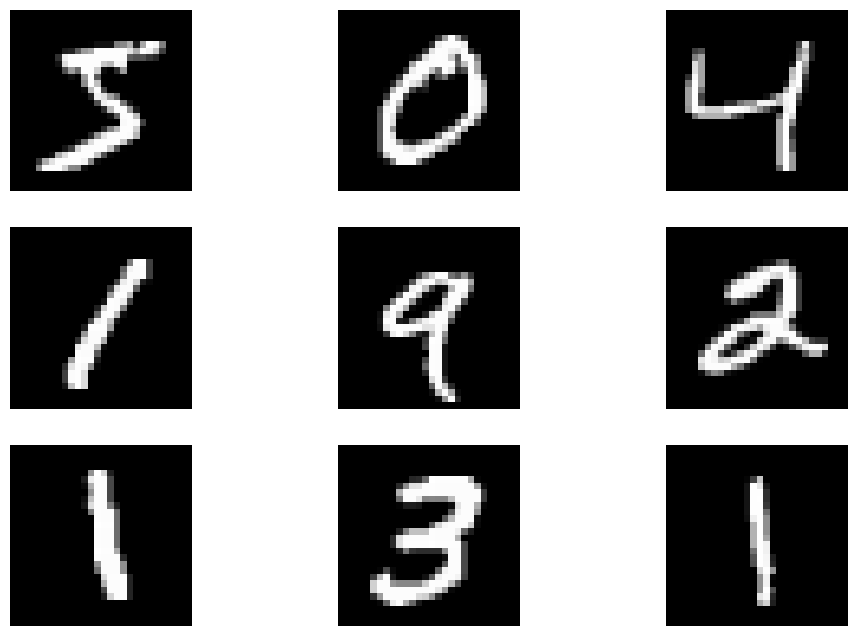

In [6]:
x_train, y_train = prepare_mnist_dataset()

plt.figure(figsize=(12, 8))
for i in range(9):
    plt.subplot(3, 3, i + 1)
    plt.imshow(x_train[i], cmap="gray")
    plt.axis("off")
plt.show()

In [7]:
def build_generator(): 
    return keras.models.Sequential([ 
    Dense(7 * 7 * 256, input_shape=[NOISE_SIZE]),
    BatchNormalization(momentum = 0.8), 
    LeakyReLU(alpha = 0.2),
    Reshape([7, 7, 256]),
    
    Conv2DTranspose(128, kernel_size = 4, strides = 1, padding = 'same'),
    BatchNormalization(momentum = 0.8), 
    LeakyReLU(alpha = 0.2), 
    
    Conv2DTranspose(64, kernel_size = 4, strides = 2, padding = 'same'),
    BatchNormalization(momentum = 0.8), 
    LeakyReLU(alpha = 0.2), 
    
    Conv2DTranspose(1, kernel_size = 4, strides = 2, padding = 'same', activation = 'tanh'),
    
], name = 'generator')

In [8]:
def build_discriminator():
    return keras.models.Sequential([
        
    Conv2D(64, kernel_size = 4, strides = 2, padding = 'same', input_shape = IMG_SHAPE),
    LeakyReLU(alpha = 0.2),
    Dropout(rate = 0.3),
    
    Conv2D(128, kernel_size = 4, strides = 2, padding = 'same'),     
    LeakyReLU(alpha = 0.2), 
    Dropout(rate = 0.3), 
        
    Conv2D(256, kernel_size = 4, strides = 2, padding = 'same'),     
    LeakyReLU(alpha = 0.2), 
    Dropout(rate = 0.3), 
        
    Flatten(),
    Dense(1, activation = 'sigmoid')
], name = 'discriminator')

In [9]:
class DCGAN(Model):
    def __init__(self, discriminator, generator, latent_dim):
        super().__init__()
        self.discriminator = discriminator
        self.generator = generator
        self.latent_dim = latent_dim

    def compile(self, discriminator_optimizer, generator_optimizer, loss_fn):
        super().compile()
        self.discriminator_optimizer = discriminator_optimizer
        self.generator_optimizer = generator_optimizer
        self.loss_fn = loss_fn
        self.discriminator_loss_metric = keras.metrics.Mean(name = "discriminator_loss")
        self.generator_loss_metric = keras.metrics.Mean(name = "generator_loss")

    @property
    def metrics(self):
        return [self.discriminator_loss_metric, self.generator_loss_metric]

    def train_step(self, real_images):
        
        batch_size = tf.shape(real_images)[0]
        random_latent_vectors = tf.random.normal(shape = (batch_size, self.latent_dim))
        
        generated_images = self.generator(random_latent_vectors) 
        combined_images = tf.concat([generated_images, real_images], axis = 0)
        labels = tf.concat(
            [tf.ones((batch_size, 1)), tf.zeros((batch_size, 1))], axis = 0
        )
        labels += 0.05 * tf.random.uniform(tf.shape(labels))

        
        with tf.GradientTape() as tape:
            predictions = self.discriminator(combined_images) 
            discriminator_loss = self.loss_fn(labels, predictions)
        gradients = tape.gradient(discriminator_loss, self.discriminator.trainable_weights)
        self.discriminator_optimizer.apply_gradients(zip(gradients, self.discriminator.trainable_weights))

        random_latent_vectors = tf.random.normal(shape = (batch_size, self.latent_dim))
        misleading_labels = tf.zeros((batch_size, 1))

        
        with tf.GradientTape() as tape:
            predictions = self.discriminator(self.generator(random_latent_vectors))
            generator_loss = self.loss_fn(misleading_labels, predictions)
        gradients = tape.gradient(generator_loss, self.generator.trainable_weights)
        self.generator_optimizer.apply_gradients(zip(gradients, self.generator.trainable_weights))

        
        self.generator_loss_metric.update_state(generator_loss)
        self.discriminator_loss_metric.update_state(discriminator_loss)
        
        return {
            "discriminator_loss": self.discriminator_loss_metric.result(),
            "generator_loss": self.generator_loss_metric.result(),
        }

Model: "generator"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 12544)             413952    
                                                                 
 batch_normalization (BatchN  (None, 12544)            50176     
 ormalization)                                                   
                                                                 
 leaky_re_lu (LeakyReLU)     (None, 12544)             0         
                                                                 
 reshape (Reshape)           (None, 7, 7, 256)         0         
                                                                 
 conv2d_transpose (Conv2DTra  (None, 7, 7, 128)        524416    
 nspose)                                                         
                                                                 
 batch_normalization_1 (Batc  (None, 7, 7, 128)        51

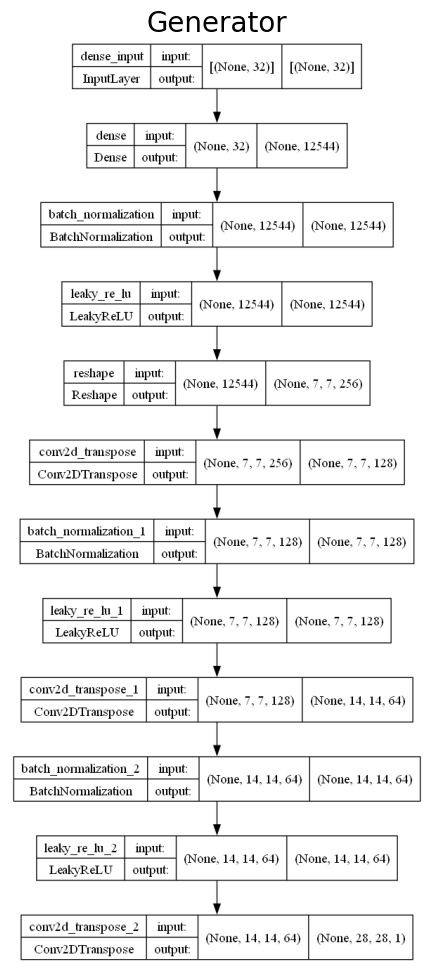

Model: "discriminator"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 14, 14, 64)        1088      
                                                                 
 leaky_re_lu_3 (LeakyReLU)   (None, 14, 14, 64)        0         
                                                                 
 dropout (Dropout)           (None, 14, 14, 64)        0         
                                                                 
 conv2d_1 (Conv2D)           (None, 7, 7, 128)         131200    
                                                                 
 leaky_re_lu_4 (LeakyReLU)   (None, 7, 7, 128)         0         
                                                                 
 dropout_1 (Dropout)         (None, 7, 7, 128)         0         
                                                                 
 conv2d_2 (Conv2D)           (None, 4, 4, 256)       

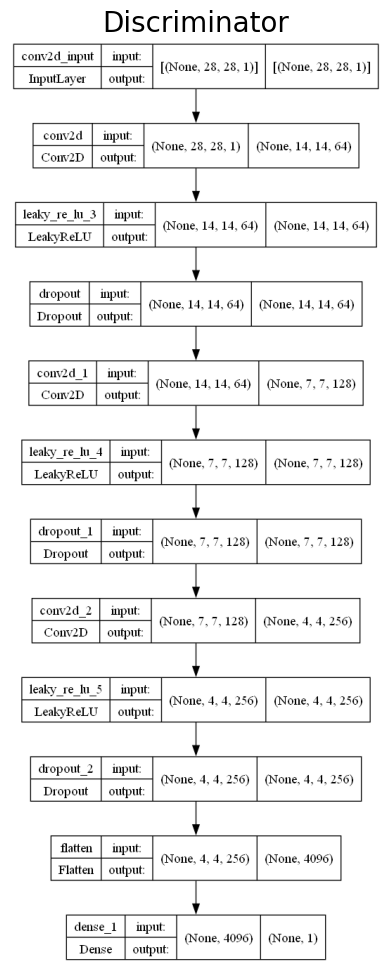

In [10]:
generator = build_generator()
generator.summary()
plot_model(generator, show_shapes = True, expand_nested = True, to_file = 'generator_scheme.png')
fig, ax = plt.subplots(1, 1, figsize = (20, 12))
ax.imshow(plt.imread('generator_scheme.png'))
ax.set_title('Generator', fontsize = 20)
ax.axis('off')
plt.show()

discriminator = build_discriminator()
discriminator.summary()
plot_model(discriminator, show_shapes = True, expand_nested = True, to_file = 'discriminator_scheme.png')
fig, ax = plt.subplots(1, 1, figsize = (20, 12))
ax.imshow(plt.imread('discriminator_scheme.png'))
ax.set_title('Discriminator', fontsize = 20)
ax.axis('off')
plt.show()

In [11]:
class save_imgs(callbacks.Callback):
    def on_epoch_end(self, epoch, logs=None):
        if ((int(epoch) + 1) % EPOCHS_TO_SAVE) == 0:
            fake_images = generator(tf.random.normal([64, NOISE_SIZE]))
            show_images(fake_images, 16, 'Images generated after {} epochs for class {}'.format(int(epoch) + 1, i), "gen_imgs_{}_{}".format(i, int(epoch) + 1))

Epoch 1/50
53/53 [==============================] - 10s 182ms/step - discriminator_loss: 0.3477 - generator_loss: 1.0909
Epoch 2/50
53/53 [==============================] - 10s 186ms/step - discriminator_loss: 0.2063 - generator_loss: 3.8318
Epoch 3/50
53/53 [==============================] - ETA: 0s - discriminator_loss: 0.3107 - generator_loss: 2.7485

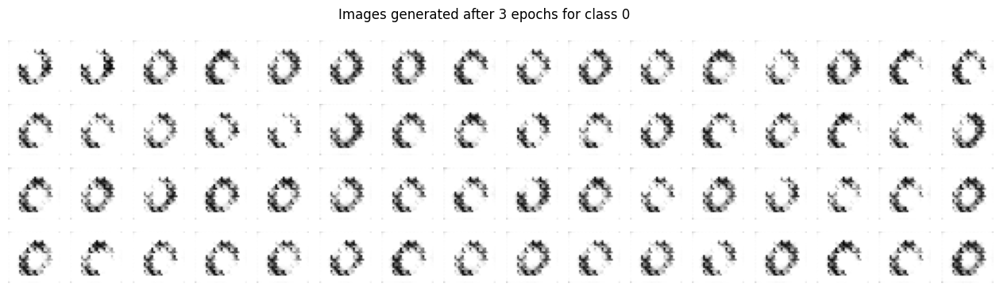

53/53 [==============================] - 11s 201ms/step - discriminator_loss: 0.3107 - generator_loss: 2.7485
Epoch 4/50
53/53 [==============================] - 10s 183ms/step - discriminator_loss: 0.4128 - generator_loss: 2.1149
Epoch 5/50
53/53 [==============================] - 10s 182ms/step - discriminator_loss: 0.5282 - generator_loss: 1.5431
Epoch 6/50
53/53 [==============================] - ETA: 0s - discriminator_loss: 0.6304 - generator_loss: 1.1798

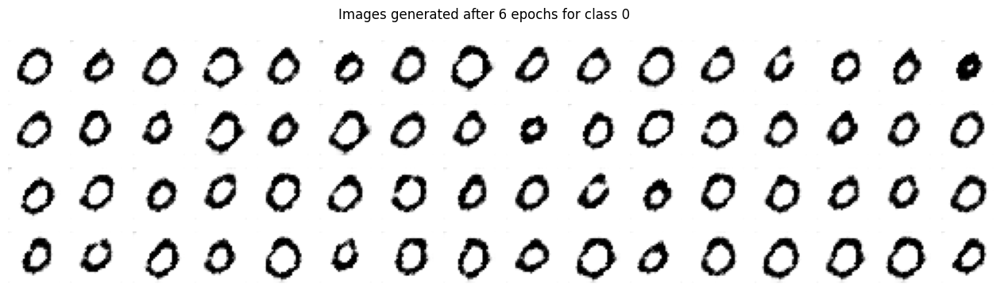

53/53 [==============================] - 11s 202ms/step - discriminator_loss: 0.6304 - generator_loss: 1.1798
Epoch 7/50
53/53 [==============================] - 10s 185ms/step - discriminator_loss: 0.6104 - generator_loss: 0.9802
Epoch 8/50
53/53 [==============================] - 10s 183ms/step - discriminator_loss: 0.4934 - generator_loss: 1.1619
Epoch 9/50
53/53 [==============================] - ETA: 0s - discriminator_loss: 0.5231 - generator_loss: 1.2317

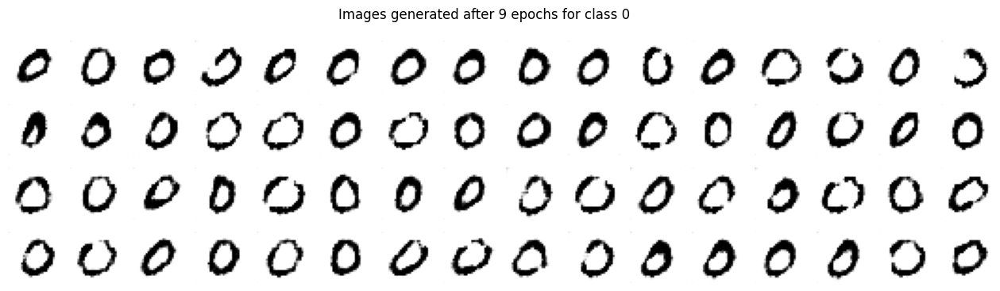

53/53 [==============================] - 11s 203ms/step - discriminator_loss: 0.5231 - generator_loss: 1.2317
Epoch 10/50
53/53 [==============================] - 10s 184ms/step - discriminator_loss: 0.5629 - generator_loss: 1.2518
Epoch 11/50
53/53 [==============================] - 10s 190ms/step - discriminator_loss: 0.5950 - generator_loss: 1.2186
Epoch 12/50
53/53 [==============================] - ETA: 0s - discriminator_loss: 0.6022 - generator_loss: 1.0812

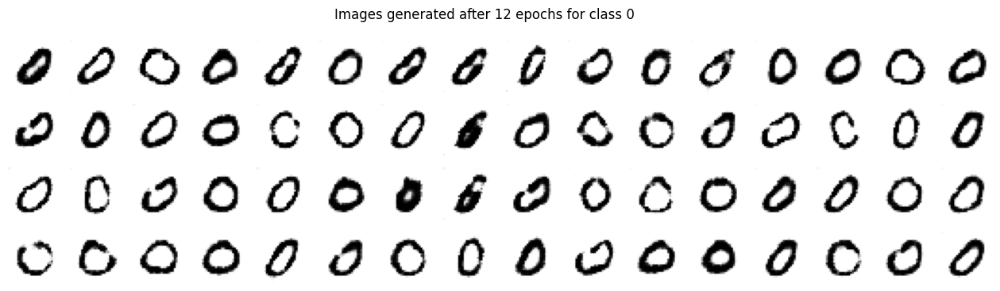

53/53 [==============================] - 11s 207ms/step - discriminator_loss: 0.6022 - generator_loss: 1.0812
Epoch 13/50
53/53 [==============================] - 10s 186ms/step - discriminator_loss: 0.5892 - generator_loss: 1.0255
Epoch 14/50
53/53 [==============================] - 10s 183ms/step - discriminator_loss: 0.6007 - generator_loss: 0.9827
Epoch 15/50
53/53 [==============================] - ETA: 0s - discriminator_loss: 0.6482 - generator_loss: 0.9432

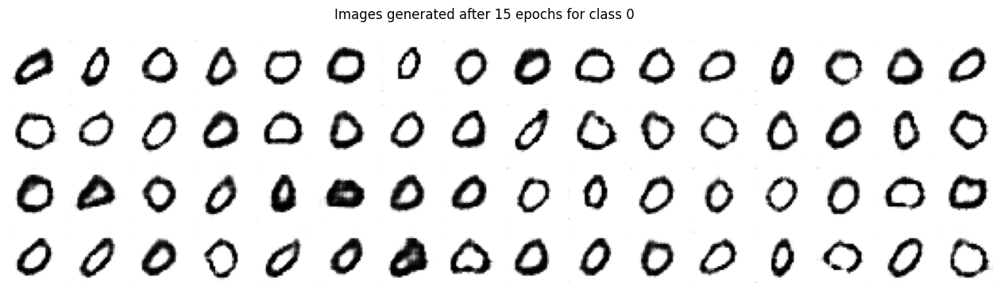

53/53 [==============================] - 11s 200ms/step - discriminator_loss: 0.6482 - generator_loss: 0.9432
Epoch 16/50
53/53 [==============================] - 10s 184ms/step - discriminator_loss: 0.6254 - generator_loss: 0.9593
Epoch 17/50
53/53 [==============================] - 10s 181ms/step - discriminator_loss: 0.6256 - generator_loss: 0.9266
Epoch 18/50
53/53 [==============================] - ETA: 0s - discriminator_loss: 0.6363 - generator_loss: 0.9238

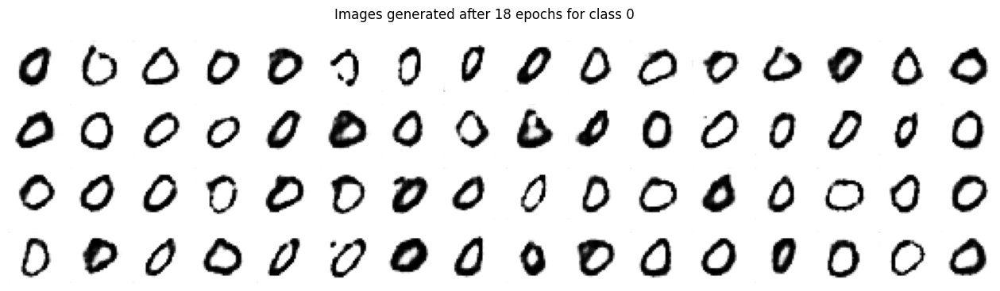

53/53 [==============================] - 11s 209ms/step - discriminator_loss: 0.6363 - generator_loss: 0.9238
Epoch 19/50
53/53 [==============================] - 10s 189ms/step - discriminator_loss: 0.6340 - generator_loss: 0.9224
Epoch 20/50
53/53 [==============================] - 10s 187ms/step - discriminator_loss: 0.6382 - generator_loss: 0.9005
Epoch 21/50
53/53 [==============================] - ETA: 0s - discriminator_loss: 0.6371 - generator_loss: 0.9176

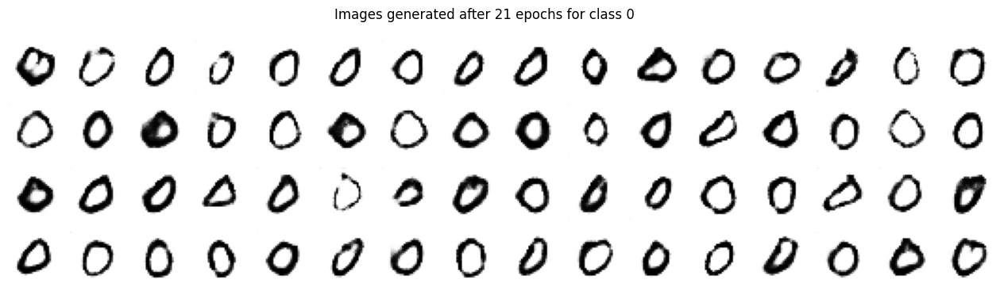

53/53 [==============================] - 11s 205ms/step - discriminator_loss: 0.6371 - generator_loss: 0.9176
Epoch 22/50
53/53 [==============================] - 10s 185ms/step - discriminator_loss: 0.6360 - generator_loss: 0.9133
Epoch 23/50
53/53 [==============================] - 10s 192ms/step - discriminator_loss: 0.6402 - generator_loss: 0.8956
Epoch 24/50
53/53 [==============================] - ETA: 0s - discriminator_loss: 0.6452 - generator_loss: 0.8785

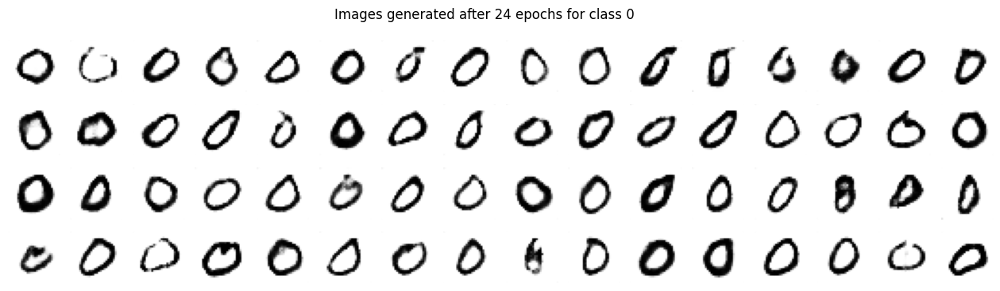

53/53 [==============================] - 11s 209ms/step - discriminator_loss: 0.6452 - generator_loss: 0.8785
Epoch 25/50
53/53 [==============================] - 10s 192ms/step - discriminator_loss: 0.6402 - generator_loss: 0.8861
Epoch 26/50
53/53 [==============================] - 10s 190ms/step - discriminator_loss: 0.6402 - generator_loss: 0.8925
Epoch 27/50
53/53 [==============================] - ETA: 0s - discriminator_loss: 0.6491 - generator_loss: 0.9002

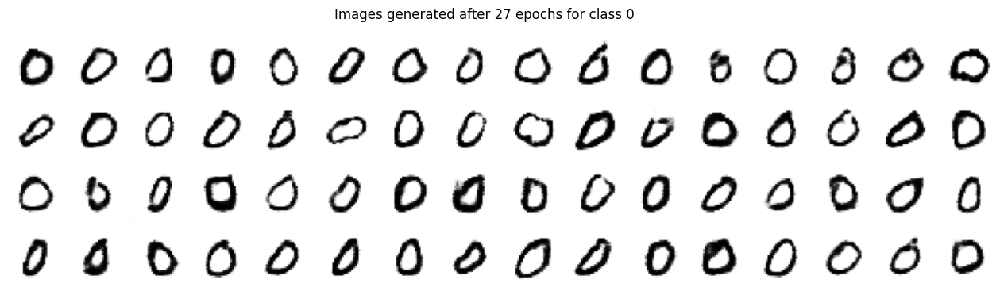

53/53 [==============================] - 11s 205ms/step - discriminator_loss: 0.6491 - generator_loss: 0.9002
Epoch 28/50
53/53 [==============================] - 10s 194ms/step - discriminator_loss: 0.6523 - generator_loss: 0.9013
Epoch 29/50
53/53 [==============================] - 11s 199ms/step - discriminator_loss: 0.6517 - generator_loss: 0.8747
Epoch 30/50
53/53 [==============================] - ETA: 0s - discriminator_loss: 0.6620 - generator_loss: 0.8972

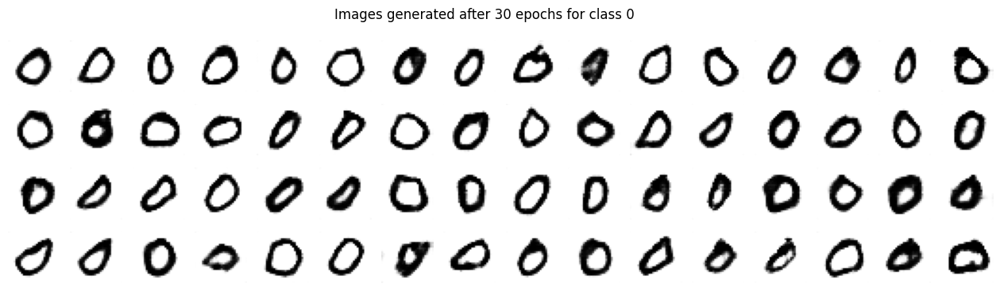

53/53 [==============================] - 11s 209ms/step - discriminator_loss: 0.6620 - generator_loss: 0.8972
Epoch 31/50
53/53 [==============================] - 10s 183ms/step - discriminator_loss: 0.6662 - generator_loss: 0.9180
Epoch 32/50
53/53 [==============================] - 10s 184ms/step - discriminator_loss: 0.6598 - generator_loss: 0.9318
Epoch 33/50
53/53 [==============================] - ETA: 0s - discriminator_loss: 0.6610 - generator_loss: 0.8947

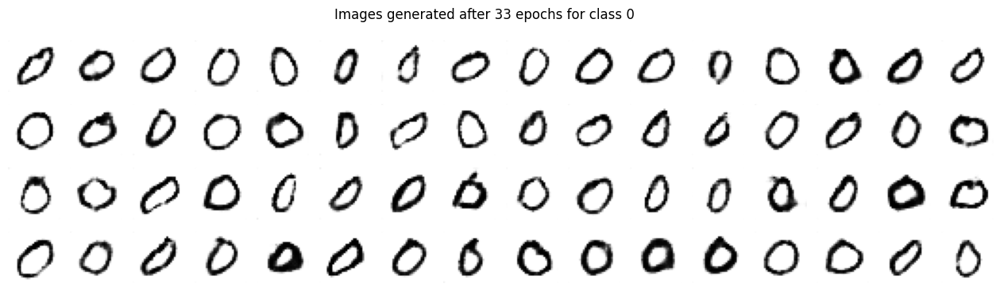

53/53 [==============================] - 11s 201ms/step - discriminator_loss: 0.6610 - generator_loss: 0.8947
Epoch 34/50
53/53 [==============================] - 10s 189ms/step - discriminator_loss: 0.6543 - generator_loss: 0.8780
Epoch 35/50
53/53 [==============================] - 10s 187ms/step - discriminator_loss: 0.6461 - generator_loss: 0.8813
Epoch 36/50
53/53 [==============================] - ETA: 0s - discriminator_loss: 0.6489 - generator_loss: 0.8781

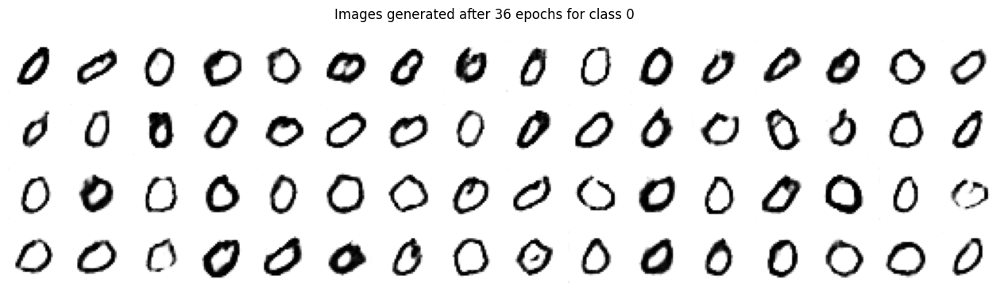

53/53 [==============================] - 11s 203ms/step - discriminator_loss: 0.6489 - generator_loss: 0.8781
Epoch 37/50
53/53 [==============================] - 10s 187ms/step - discriminator_loss: 0.6479 - generator_loss: 0.8691
Epoch 38/50
53/53 [==============================] - 10s 186ms/step - discriminator_loss: 0.6458 - generator_loss: 0.8682
Epoch 39/50
53/53 [==============================] - ETA: 0s - discriminator_loss: 0.6475 - generator_loss: 0.8782

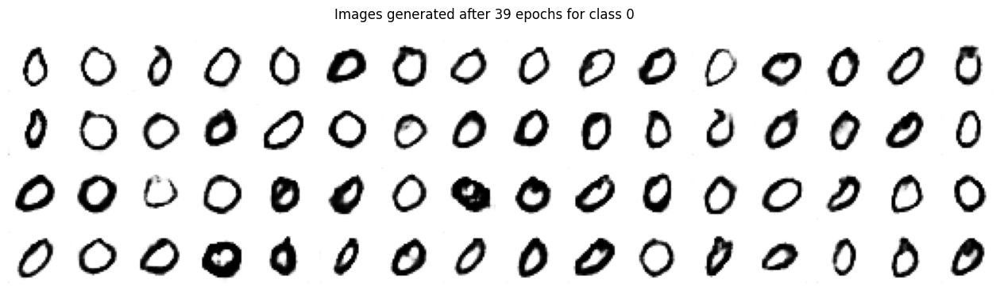

53/53 [==============================] - 11s 205ms/step - discriminator_loss: 0.6475 - generator_loss: 0.8782
Epoch 40/50
53/53 [==============================] - 10s 187ms/step - discriminator_loss: 0.6503 - generator_loss: 0.8990
Epoch 41/50
53/53 [==============================] - 10s 186ms/step - discriminator_loss: 0.6481 - generator_loss: 0.8950
Epoch 42/50
53/53 [==============================] - ETA: 0s - discriminator_loss: 0.6460 - generator_loss: 0.8946

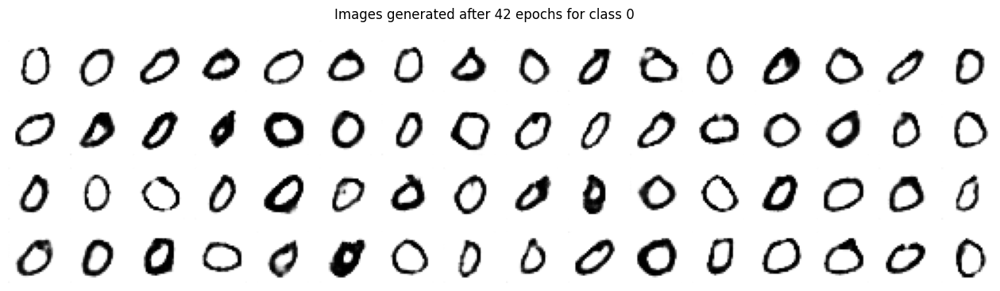

53/53 [==============================] - 11s 201ms/step - discriminator_loss: 0.6460 - generator_loss: 0.8946
Epoch 43/50
53/53 [==============================] - 10s 188ms/step - discriminator_loss: 0.6490 - generator_loss: 0.8953
Epoch 44/50
53/53 [==============================] - 10s 185ms/step - discriminator_loss: 0.6504 - generator_loss: 0.8920
Epoch 45/50
53/53 [==============================] - ETA: 0s - discriminator_loss: 0.6518 - generator_loss: 0.8900

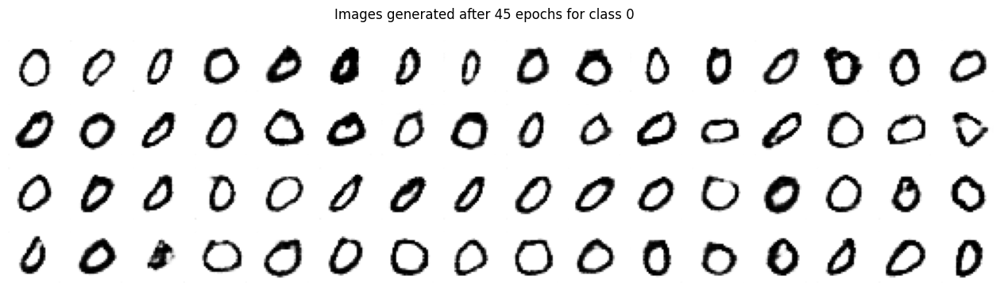

53/53 [==============================] - 11s 203ms/step - discriminator_loss: 0.6518 - generator_loss: 0.8900
Epoch 46/50
53/53 [==============================] - 10s 185ms/step - discriminator_loss: 0.6462 - generator_loss: 0.8977
Epoch 47/50
53/53 [==============================] - 10s 187ms/step - discriminator_loss: 0.6520 - generator_loss: 0.8981
Epoch 48/50
53/53 [==============================] - ETA: 0s - discriminator_loss: 0.6435 - generator_loss: 0.8921

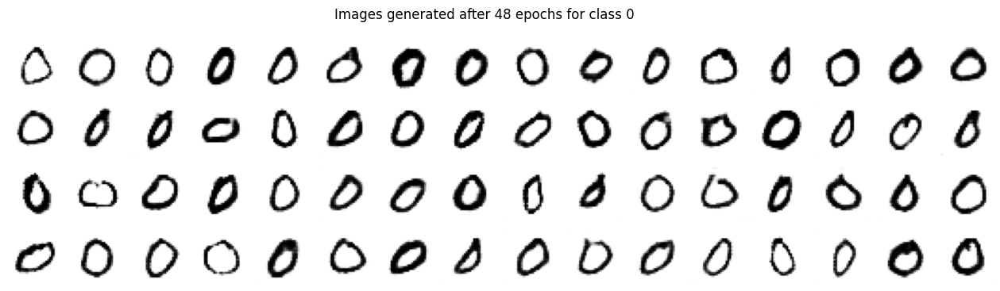

53/53 [==============================] - 11s 205ms/step - discriminator_loss: 0.6435 - generator_loss: 0.8921
Epoch 49/50
53/53 [==============================] - 10s 185ms/step - discriminator_loss: 0.6484 - generator_loss: 0.8890
Epoch 50/50
53/53 [==============================] - 10s 184ms/step - discriminator_loss: 0.6479 - generator_loss: 0.8947
Epoch 1/50
61/61 [==============================] - 12s 187ms/step - discriminator_loss: 0.3688 - generator_loss: 1.2239
Epoch 2/50
61/61 [==============================] - 12s 190ms/step - discriminator_loss: 0.4664 - generator_loss: 1.5623
Epoch 3/50
61/61 [==============================] - ETA: 0s - discriminator_loss: 0.6591 - generator_loss: 1.0401

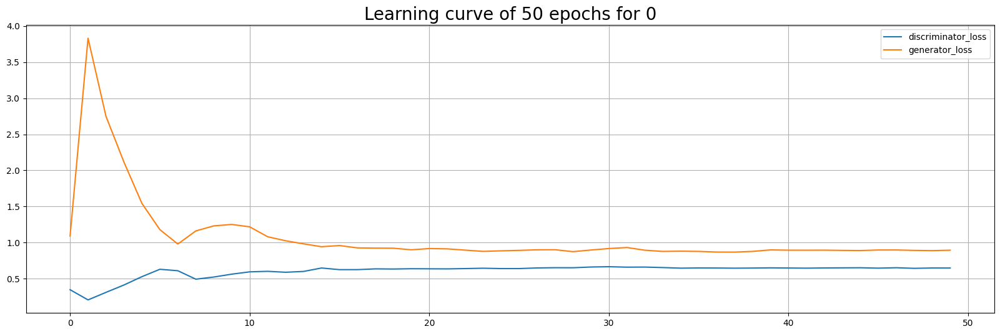

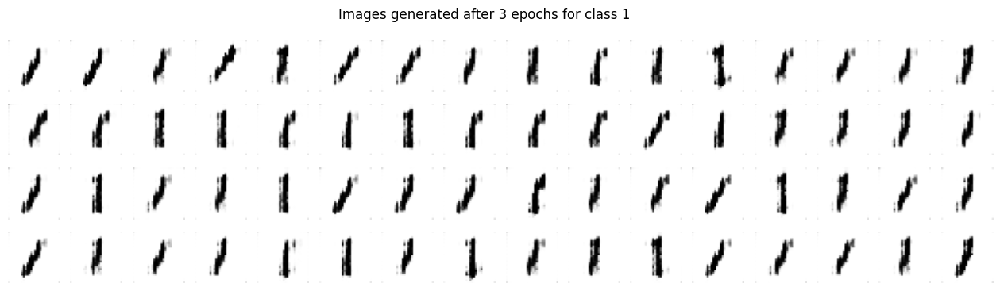

61/61 [==============================] - 12s 203ms/step - discriminator_loss: 0.6591 - generator_loss: 1.0401
Epoch 4/50
61/61 [==============================] - 11s 184ms/step - discriminator_loss: 0.6691 - generator_loss: 0.9045
Epoch 5/50
61/61 [==============================] - 11s 185ms/step - discriminator_loss: 0.6540 - generator_loss: 0.8723
Epoch 6/50
61/61 [==============================] - ETA: 0s - discriminator_loss: 0.6617 - generator_loss: 0.8442

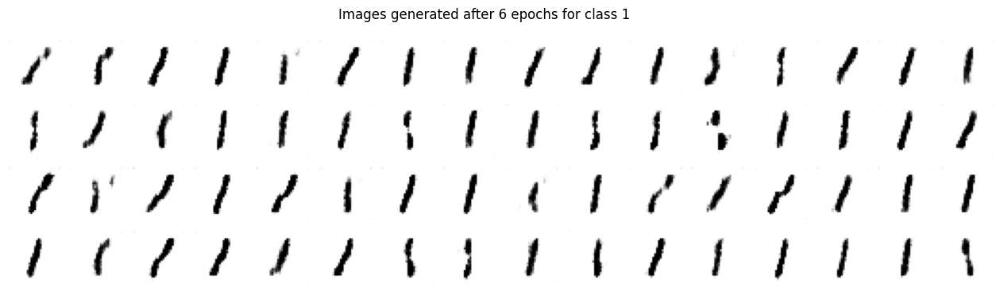

61/61 [==============================] - 12s 200ms/step - discriminator_loss: 0.6617 - generator_loss: 0.8442
Epoch 7/50
61/61 [==============================] - 11s 187ms/step - discriminator_loss: 0.6656 - generator_loss: 0.8276
Epoch 8/50
61/61 [==============================] - 11s 184ms/step - discriminator_loss: 0.6812 - generator_loss: 0.8045
Epoch 9/50
61/61 [==============================] - ETA: 0s - discriminator_loss: 0.6813 - generator_loss: 0.7980

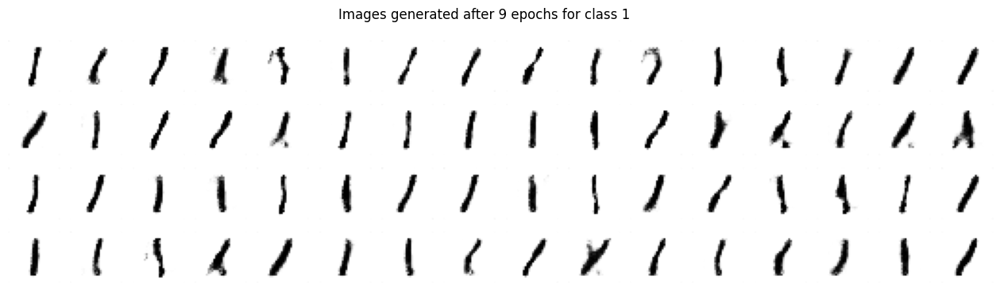

61/61 [==============================] - 12s 198ms/step - discriminator_loss: 0.6813 - generator_loss: 0.7980
Epoch 10/50
61/61 [==============================] - 12s 189ms/step - discriminator_loss: 0.6825 - generator_loss: 0.7981
Epoch 11/50
61/61 [==============================] - 11s 187ms/step - discriminator_loss: 0.6728 - generator_loss: 0.8239
Epoch 12/50
61/61 [==============================] - ETA: 0s - discriminator_loss: 0.6741 - generator_loss: 0.8190

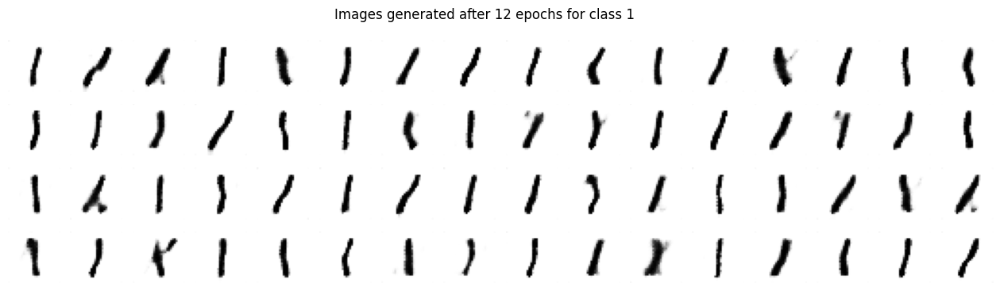

61/61 [==============================] - 12s 205ms/step - discriminator_loss: 0.6741 - generator_loss: 0.8190
Epoch 13/50
61/61 [==============================] - 11s 186ms/step - discriminator_loss: 0.6783 - generator_loss: 0.8186
Epoch 14/50
61/61 [==============================] - 11s 186ms/step - discriminator_loss: 0.6735 - generator_loss: 0.8237
Epoch 15/50
61/61 [==============================] - ETA: 0s - discriminator_loss: 0.6727 - generator_loss: 0.8206

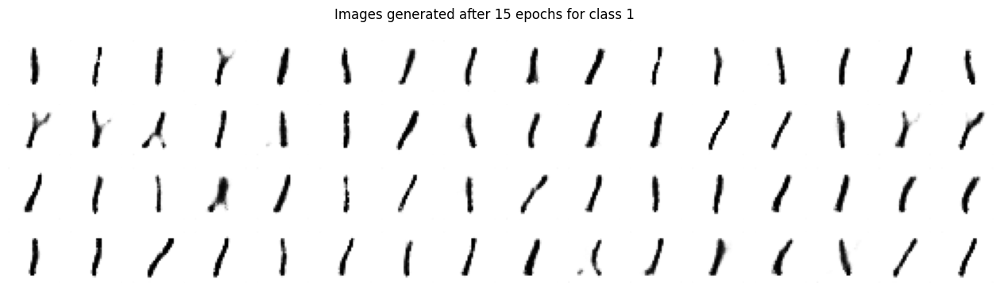

61/61 [==============================] - 12s 201ms/step - discriminator_loss: 0.6727 - generator_loss: 0.8206
Epoch 16/50
61/61 [==============================] - 11s 188ms/step - discriminator_loss: 0.6739 - generator_loss: 0.8110
Epoch 17/50
61/61 [==============================] - 11s 185ms/step - discriminator_loss: 0.6789 - generator_loss: 0.7997
Epoch 18/50
61/61 [==============================] - ETA: 0s - discriminator_loss: 0.6830 - generator_loss: 0.8093

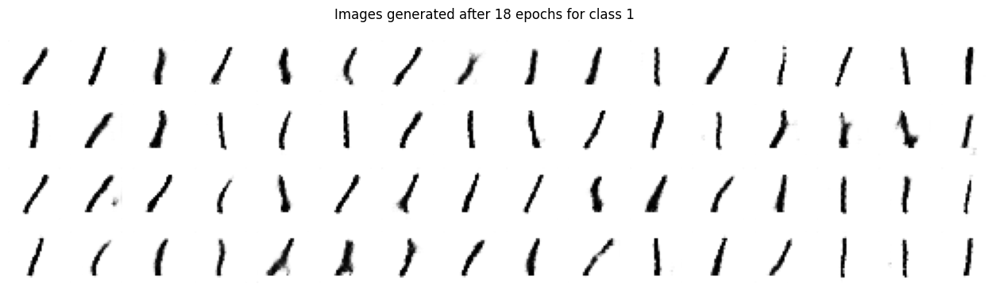

61/61 [==============================] - 12s 199ms/step - discriminator_loss: 0.6830 - generator_loss: 0.8093
Epoch 19/50
61/61 [==============================] - 11s 184ms/step - discriminator_loss: 0.6819 - generator_loss: 0.8094
Epoch 20/50
61/61 [==============================] - 11s 186ms/step - discriminator_loss: 0.6829 - generator_loss: 0.8089
Epoch 21/50
61/61 [==============================] - ETA: 0s - discriminator_loss: 0.6794 - generator_loss: 0.8072

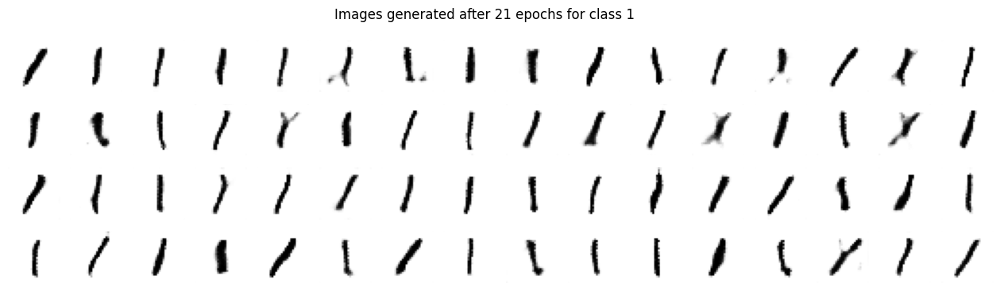

61/61 [==============================] - 12s 203ms/step - discriminator_loss: 0.6794 - generator_loss: 0.8072
Epoch 22/50
61/61 [==============================] - 11s 186ms/step - discriminator_loss: 0.6807 - generator_loss: 0.8092
Epoch 23/50
61/61 [==============================] - 11s 183ms/step - discriminator_loss: 0.6739 - generator_loss: 0.8073
Epoch 24/50
61/61 [==============================] - ETA: 0s - discriminator_loss: 0.6805 - generator_loss: 0.7989

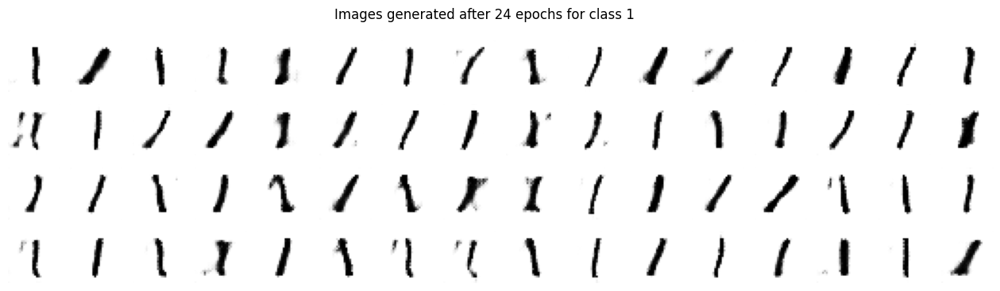

61/61 [==============================] - 12s 196ms/step - discriminator_loss: 0.6805 - generator_loss: 0.7989
Epoch 25/50
61/61 [==============================] - 11s 182ms/step - discriminator_loss: 0.6789 - generator_loss: 0.8099
Epoch 26/50
61/61 [==============================] - 11s 182ms/step - discriminator_loss: 0.6871 - generator_loss: 0.8013
Epoch 27/50
61/61 [==============================] - ETA: 0s - discriminator_loss: 0.6785 - generator_loss: 0.8049

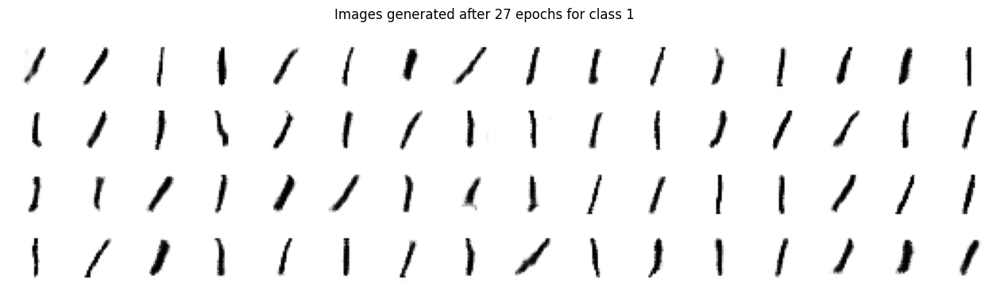

61/61 [==============================] - 12s 195ms/step - discriminator_loss: 0.6785 - generator_loss: 0.8049
Epoch 28/50
61/61 [==============================] - 11s 184ms/step - discriminator_loss: 0.6814 - generator_loss: 0.7936
Epoch 29/50
61/61 [==============================] - 11s 182ms/step - discriminator_loss: 0.6795 - generator_loss: 0.8034
Epoch 30/50
61/61 [==============================] - ETA: 0s - discriminator_loss: 0.6801 - generator_loss: 0.8012

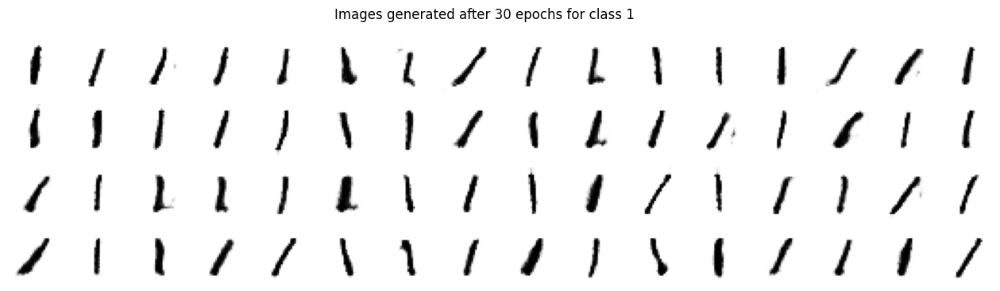

61/61 [==============================] - 12s 196ms/step - discriminator_loss: 0.6801 - generator_loss: 0.8012
Epoch 31/50
61/61 [==============================] - 11s 182ms/step - discriminator_loss: 0.6797 - generator_loss: 0.7958
Epoch 32/50
61/61 [==============================] - 11s 182ms/step - discriminator_loss: 0.6825 - generator_loss: 0.8045
Epoch 33/50
61/61 [==============================] - ETA: 0s - discriminator_loss: 0.6792 - generator_loss: 0.8050

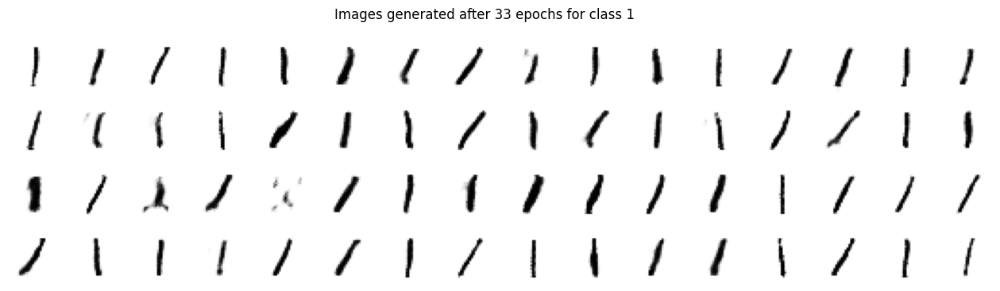

61/61 [==============================] - 12s 196ms/step - discriminator_loss: 0.6792 - generator_loss: 0.8050
Epoch 34/50
61/61 [==============================] - 11s 181ms/step - discriminator_loss: 0.6783 - generator_loss: 0.8026
Epoch 35/50
61/61 [==============================] - 11s 181ms/step - discriminator_loss: 0.6803 - generator_loss: 0.8021
Epoch 36/50
61/61 [==============================] - ETA: 0s - discriminator_loss: 0.6769 - generator_loss: 0.8042

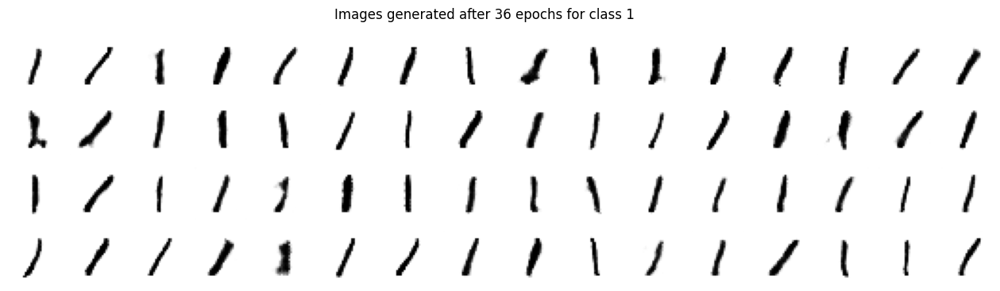

61/61 [==============================] - 12s 195ms/step - discriminator_loss: 0.6769 - generator_loss: 0.8042
Epoch 37/50
61/61 [==============================] - 11s 183ms/step - discriminator_loss: 0.6822 - generator_loss: 0.8038
Epoch 38/50
61/61 [==============================] - 11s 182ms/step - discriminator_loss: 0.6750 - generator_loss: 0.8051
Epoch 39/50
61/61 [==============================] - ETA: 0s - discriminator_loss: 0.6807 - generator_loss: 0.8137

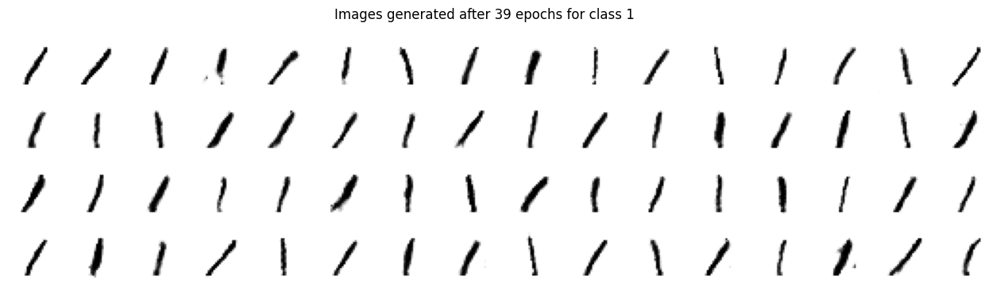

61/61 [==============================] - 12s 195ms/step - discriminator_loss: 0.6807 - generator_loss: 0.8137
Epoch 40/50
61/61 [==============================] - 11s 182ms/step - discriminator_loss: 0.6788 - generator_loss: 0.8152
Epoch 41/50
61/61 [==============================] - 11s 182ms/step - discriminator_loss: 0.6785 - generator_loss: 0.8440
Epoch 42/50
61/61 [==============================] - ETA: 0s - discriminator_loss: 0.6739 - generator_loss: 0.8029

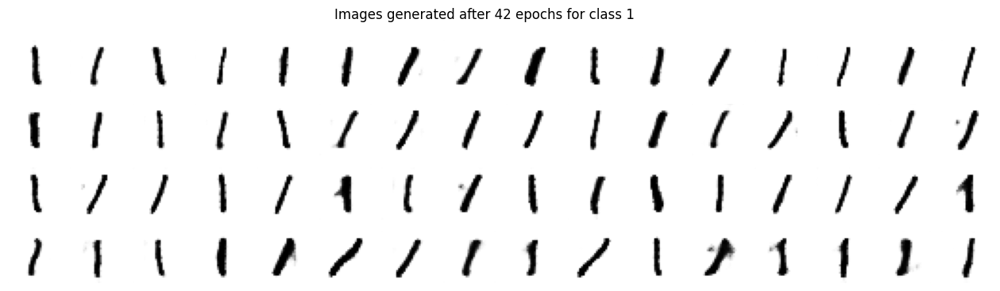

61/61 [==============================] - 12s 197ms/step - discriminator_loss: 0.6739 - generator_loss: 0.8029
Epoch 43/50
61/61 [==============================] - 11s 182ms/step - discriminator_loss: 0.6758 - generator_loss: 0.8096
Epoch 44/50
61/61 [==============================] - 11s 182ms/step - discriminator_loss: 0.6757 - generator_loss: 0.8081
Epoch 45/50
61/61 [==============================] - ETA: 0s - discriminator_loss: 0.6760 - generator_loss: 0.8119

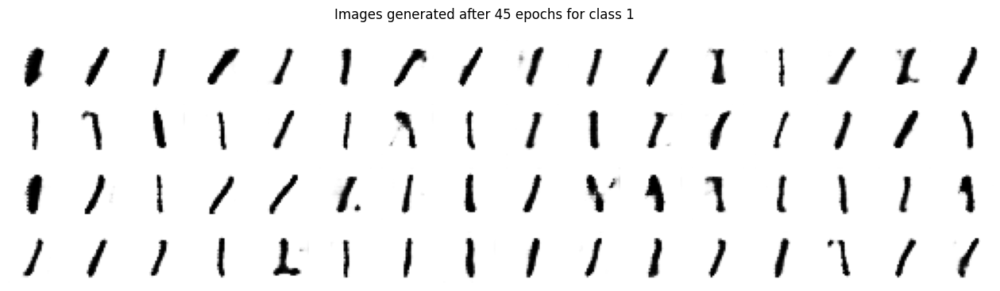

61/61 [==============================] - 12s 197ms/step - discriminator_loss: 0.6760 - generator_loss: 0.8119
Epoch 46/50
61/61 [==============================] - 11s 182ms/step - discriminator_loss: 0.6771 - generator_loss: 0.8254
Epoch 47/50
61/61 [==============================] - 11s 181ms/step - discriminator_loss: 0.6752 - generator_loss: 0.8090
Epoch 48/50
61/61 [==============================] - ETA: 0s - discriminator_loss: 0.6747 - generator_loss: 0.8151

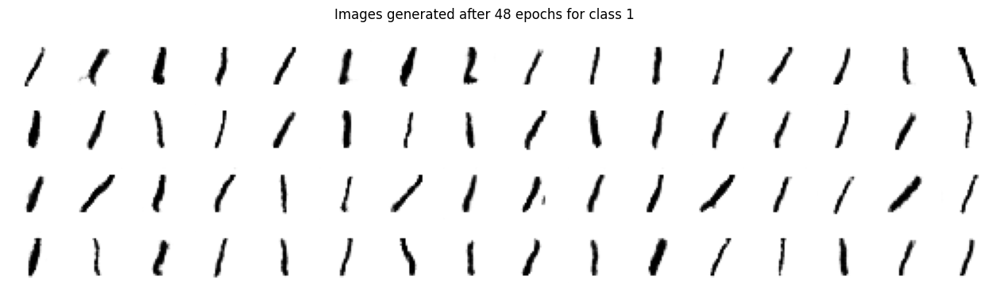

61/61 [==============================] - 12s 195ms/step - discriminator_loss: 0.6747 - generator_loss: 0.8151
Epoch 49/50
61/61 [==============================] - 11s 182ms/step - discriminator_loss: 0.6713 - generator_loss: 0.8179
Epoch 50/50
61/61 [==============================] - 11s 182ms/step - discriminator_loss: 0.6718 - generator_loss: 0.8319
Epoch 1/50
54/54 [==============================] - 10s 181ms/step - discriminator_loss: 0.3728 - generator_loss: 0.9513
Epoch 2/50
54/54 [==============================] - 10s 181ms/step - discriminator_loss: 0.3314 - generator_loss: 2.5900
Epoch 3/50
54/54 [==============================] - ETA: 0s - discriminator_loss: 0.4078 - generator_loss: 1.9385

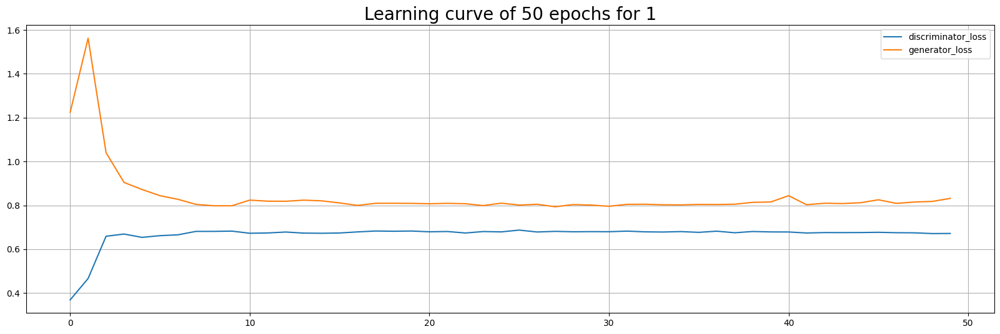

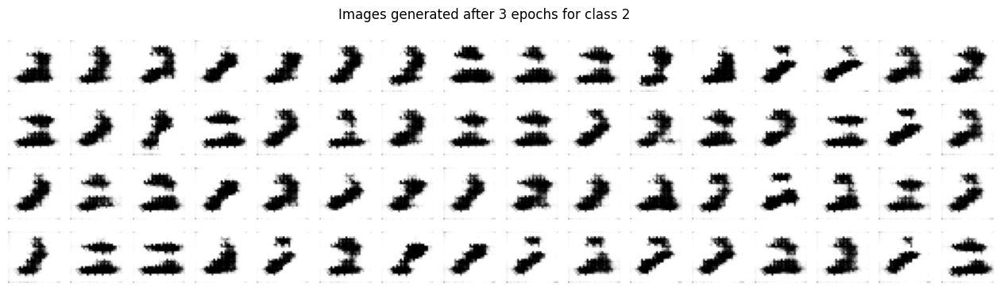

54/54 [==============================] - 11s 200ms/step - discriminator_loss: 0.4078 - generator_loss: 1.9385
Epoch 4/50
54/54 [==============================] - 10s 182ms/step - discriminator_loss: 0.3589 - generator_loss: 2.1050
Epoch 5/50
54/54 [==============================] - 10s 187ms/step - discriminator_loss: 0.4040 - generator_loss: 2.4272
Epoch 6/50
54/54 [==============================] - ETA: 0s - discriminator_loss: 0.1991 - generator_loss: 3.6215

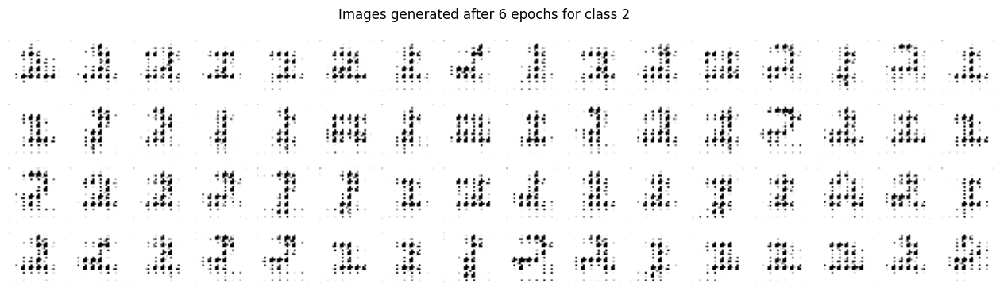

54/54 [==============================] - 11s 205ms/step - discriminator_loss: 0.1991 - generator_loss: 3.6215
Epoch 7/50
54/54 [==============================] - 10s 185ms/step - discriminator_loss: 0.0191 - generator_loss: 7.0944
Epoch 8/50
54/54 [==============================] - 10s 188ms/step - discriminator_loss: 0.0698 - generator_loss: 10.9592
Epoch 9/50
54/54 [==============================] - ETA: 0s - discriminator_loss: 0.3186 - generator_loss: 2.7863

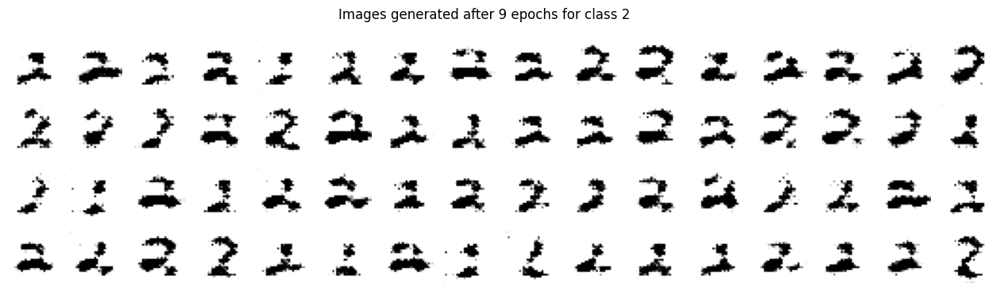

54/54 [==============================] - 11s 199ms/step - discriminator_loss: 0.3186 - generator_loss: 2.7863
Epoch 10/50
54/54 [==============================] - 10s 183ms/step - discriminator_loss: 0.4121 - generator_loss: 1.8226
Epoch 11/50
54/54 [==============================] - 10s 188ms/step - discriminator_loss: 0.4094 - generator_loss: 1.6105
Epoch 12/50
54/54 [==============================] - ETA: 0s - discriminator_loss: 0.4601 - generator_loss: 1.5286

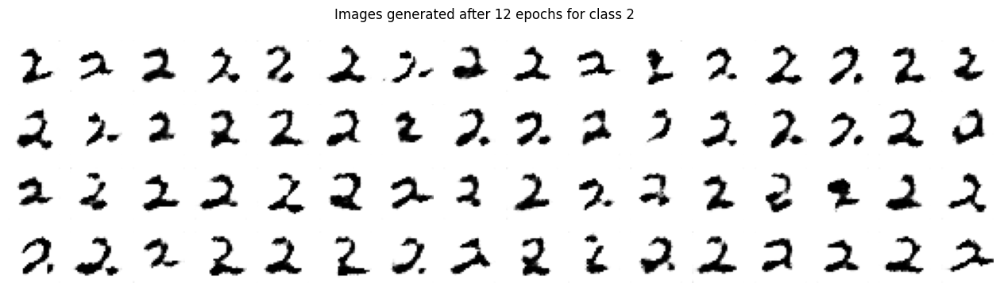

54/54 [==============================] - 11s 198ms/step - discriminator_loss: 0.4601 - generator_loss: 1.5286
Epoch 13/50
54/54 [==============================] - 10s 184ms/step - discriminator_loss: 0.4439 - generator_loss: 1.4580
Epoch 14/50
54/54 [==============================] - 10s 186ms/step - discriminator_loss: 0.4802 - generator_loss: 1.3980
Epoch 15/50
54/54 [==============================] - ETA: 0s - discriminator_loss: 0.5319 - generator_loss: 1.4265

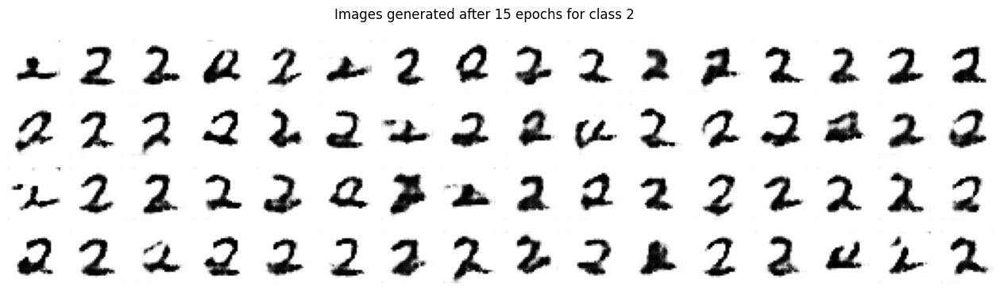

54/54 [==============================] - 11s 204ms/step - discriminator_loss: 0.5319 - generator_loss: 1.4265
Epoch 16/50
54/54 [==============================] - 10s 187ms/step - discriminator_loss: 0.5435 - generator_loss: 1.3750
Epoch 17/50
54/54 [==============================] - 10s 186ms/step - discriminator_loss: 0.5350 - generator_loss: 1.2612
Epoch 18/50
54/54 [==============================] - ETA: 0s - discriminator_loss: 0.5334 - generator_loss: 1.2160

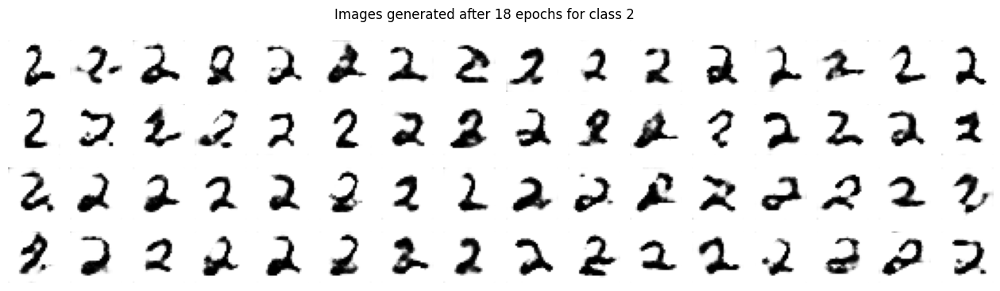

54/54 [==============================] - 11s 203ms/step - discriminator_loss: 0.5334 - generator_loss: 1.2160
Epoch 19/50
54/54 [==============================] - 10s 186ms/step - discriminator_loss: 0.5221 - generator_loss: 1.2171
Epoch 20/50
54/54 [==============================] - 10s 186ms/step - discriminator_loss: 0.5326 - generator_loss: 1.1535
Epoch 21/50
54/54 [==============================] - ETA: 0s - discriminator_loss: 0.5405 - generator_loss: 1.1176

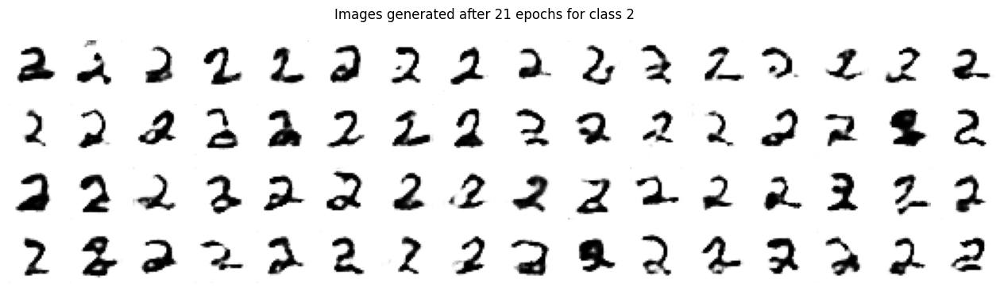

54/54 [==============================] - 11s 203ms/step - discriminator_loss: 0.5405 - generator_loss: 1.1176
Epoch 22/50
54/54 [==============================] - 10s 186ms/step - discriminator_loss: 0.5471 - generator_loss: 1.1054
Epoch 23/50
54/54 [==============================] - 10s 188ms/step - discriminator_loss: 0.5482 - generator_loss: 1.1550
Epoch 24/50
54/54 [==============================] - ETA: 0s - discriminator_loss: 0.5483 - generator_loss: 1.1980

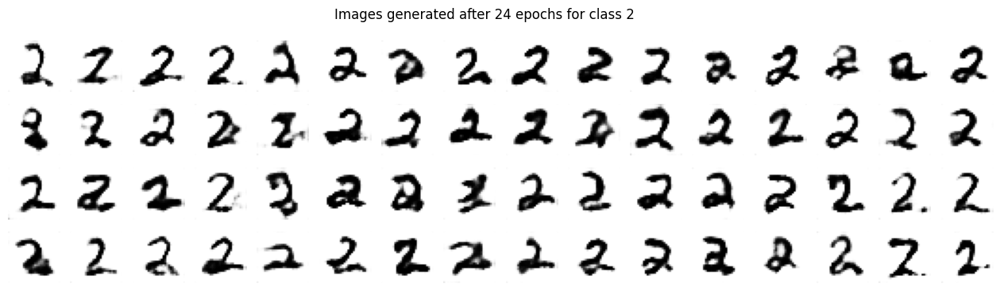

54/54 [==============================] - 11s 206ms/step - discriminator_loss: 0.5483 - generator_loss: 1.1980
Epoch 25/50
54/54 [==============================] - 10s 185ms/step - discriminator_loss: 0.5599 - generator_loss: 1.2999
Epoch 26/50
54/54 [==============================] - 10s 186ms/step - discriminator_loss: 0.5672 - generator_loss: 1.2454
Epoch 27/50
54/54 [==============================] - ETA: 0s - discriminator_loss: 0.5466 - generator_loss: 1.1264

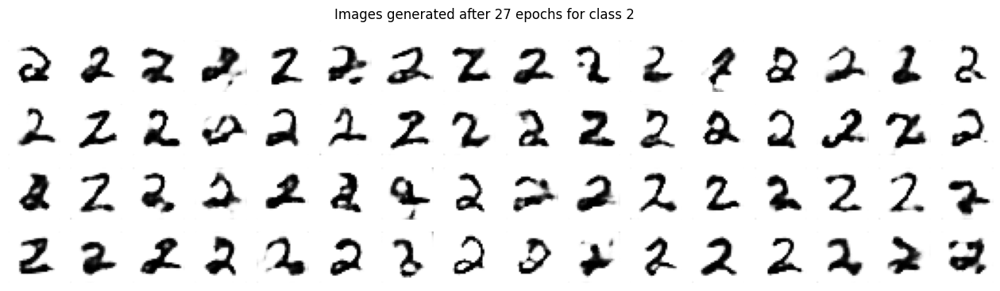

54/54 [==============================] - 11s 203ms/step - discriminator_loss: 0.5466 - generator_loss: 1.1264
Epoch 28/50
54/54 [==============================] - 10s 186ms/step - discriminator_loss: 0.5390 - generator_loss: 1.1570
Epoch 29/50
54/54 [==============================] - 10s 186ms/step - discriminator_loss: 0.5496 - generator_loss: 1.1340
Epoch 30/50
54/54 [==============================] - ETA: 0s - discriminator_loss: 0.5625 - generator_loss: 1.1019

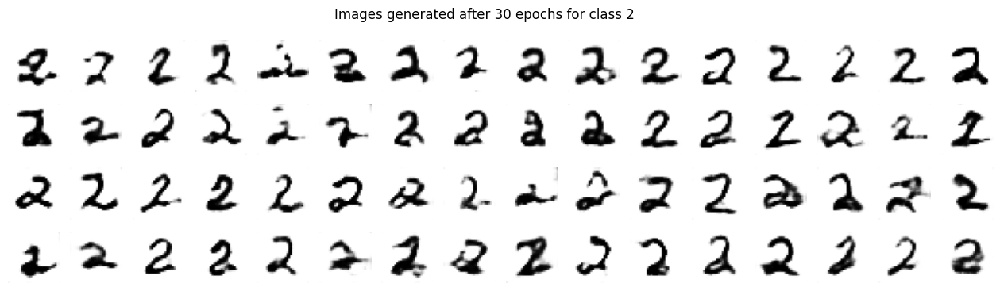

54/54 [==============================] - 11s 204ms/step - discriminator_loss: 0.5625 - generator_loss: 1.1019
Epoch 31/50
54/54 [==============================] - 10s 185ms/step - discriminator_loss: 0.5519 - generator_loss: 1.0950
Epoch 32/50
54/54 [==============================] - 10s 186ms/step - discriminator_loss: 0.5653 - generator_loss: 1.1160
Epoch 33/50
54/54 [==============================] - ETA: 0s - discriminator_loss: 0.5705 - generator_loss: 1.1151

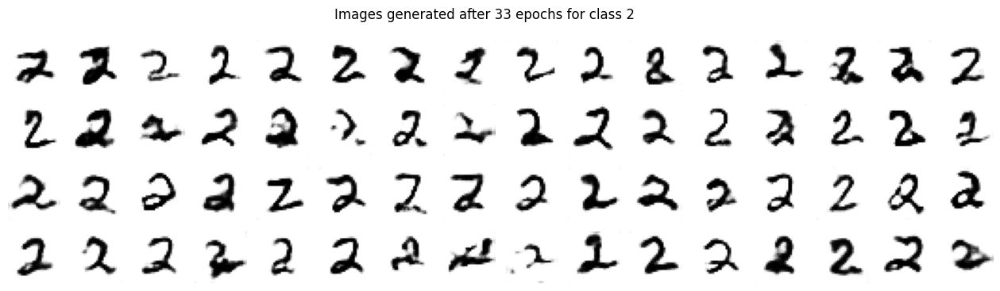

54/54 [==============================] - 11s 202ms/step - discriminator_loss: 0.5705 - generator_loss: 1.1151
Epoch 34/50
54/54 [==============================] - 10s 188ms/step - discriminator_loss: 0.5745 - generator_loss: 1.1040
Epoch 35/50
54/54 [==============================] - 10s 186ms/step - discriminator_loss: 0.5753 - generator_loss: 1.0710
Epoch 36/50
54/54 [==============================] - ETA: 0s - discriminator_loss: 0.5792 - generator_loss: 1.0705

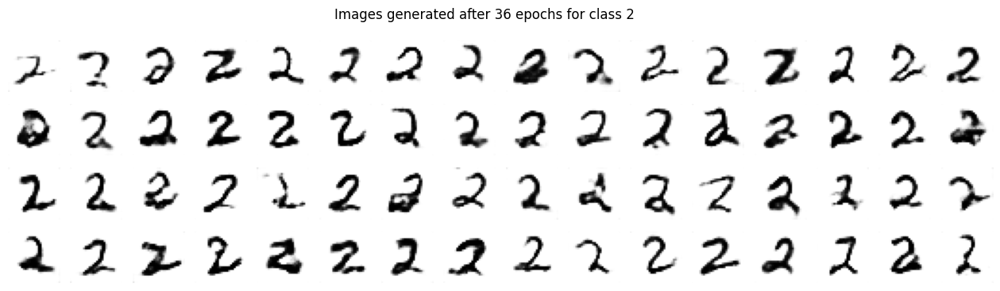

54/54 [==============================] - 11s 200ms/step - discriminator_loss: 0.5792 - generator_loss: 1.0705
Epoch 37/50
54/54 [==============================] - 10s 182ms/step - discriminator_loss: 0.5721 - generator_loss: 1.0780
Epoch 38/50
54/54 [==============================] - 10s 185ms/step - discriminator_loss: 0.5848 - generator_loss: 1.0900
Epoch 39/50
54/54 [==============================] - ETA: 0s - discriminator_loss: 0.5788 - generator_loss: 1.0782

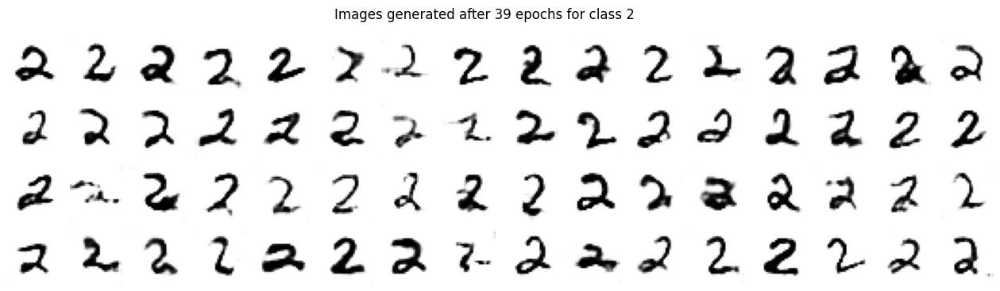

54/54 [==============================] - 11s 202ms/step - discriminator_loss: 0.5788 - generator_loss: 1.0782
Epoch 40/50
54/54 [==============================] - 10s 185ms/step - discriminator_loss: 0.5776 - generator_loss: 1.0676
Epoch 41/50
54/54 [==============================] - 10s 185ms/step - discriminator_loss: 0.5810 - generator_loss: 1.0926
Epoch 42/50
54/54 [==============================] - ETA: 0s - discriminator_loss: 0.5852 - generator_loss: 1.1201

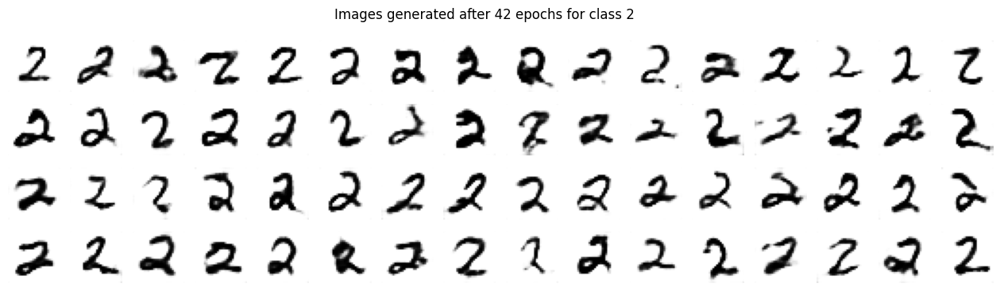

54/54 [==============================] - 11s 202ms/step - discriminator_loss: 0.5852 - generator_loss: 1.1201
Epoch 43/50
54/54 [==============================] - 10s 185ms/step - discriminator_loss: 0.5833 - generator_loss: 1.0635
Epoch 44/50
54/54 [==============================] - 10s 186ms/step - discriminator_loss: 0.5856 - generator_loss: 1.0340
Epoch 45/50
54/54 [==============================] - ETA: 0s - discriminator_loss: 0.5877 - generator_loss: 1.0558

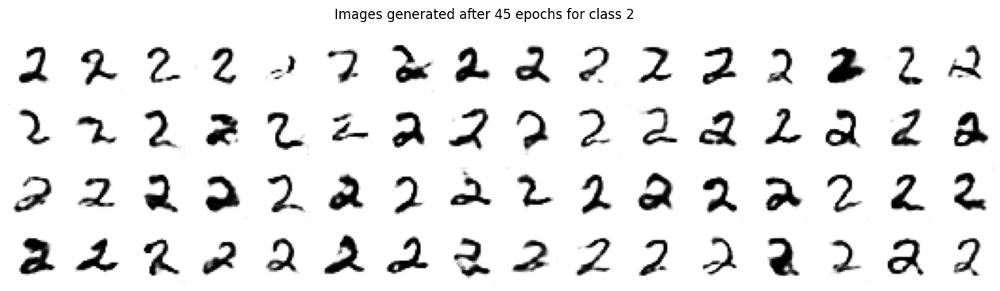

54/54 [==============================] - 11s 202ms/step - discriminator_loss: 0.5877 - generator_loss: 1.0558
Epoch 46/50
54/54 [==============================] - 10s 186ms/step - discriminator_loss: 0.5922 - generator_loss: 1.1187
Epoch 47/50
54/54 [==============================] - 10s 186ms/step - discriminator_loss: 0.5809 - generator_loss: 1.0781
Epoch 48/50
54/54 [==============================] - ETA: 0s - discriminator_loss: 0.5782 - generator_loss: 1.0579

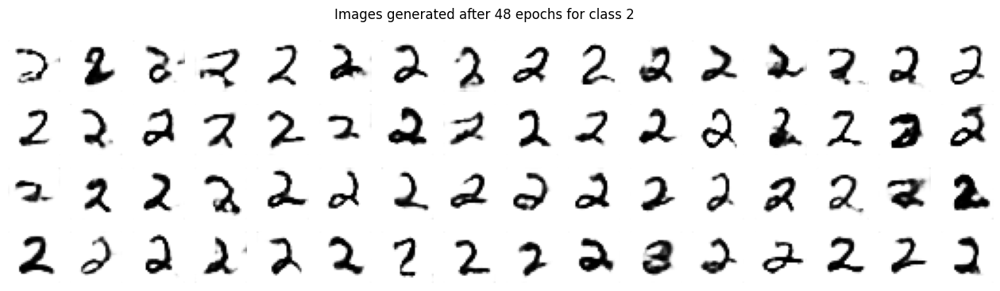

54/54 [==============================] - 11s 202ms/step - discriminator_loss: 0.5782 - generator_loss: 1.0579
Epoch 49/50
54/54 [==============================] - 10s 186ms/step - discriminator_loss: 0.5927 - generator_loss: 1.0743
Epoch 50/50
54/54 [==============================] - 10s 185ms/step - discriminator_loss: 0.5823 - generator_loss: 1.0417
Epoch 1/50
55/55 [==============================] - 11s 186ms/step - discriminator_loss: 0.3452 - generator_loss: 1.1626
Epoch 2/50
55/55 [==============================] - 10s 189ms/step - discriminator_loss: 0.3492 - generator_loss: 2.6963
Epoch 3/50
55/55 [==============================] - ETA: 0s - discriminator_loss: 0.2960 - generator_loss: 2.7211

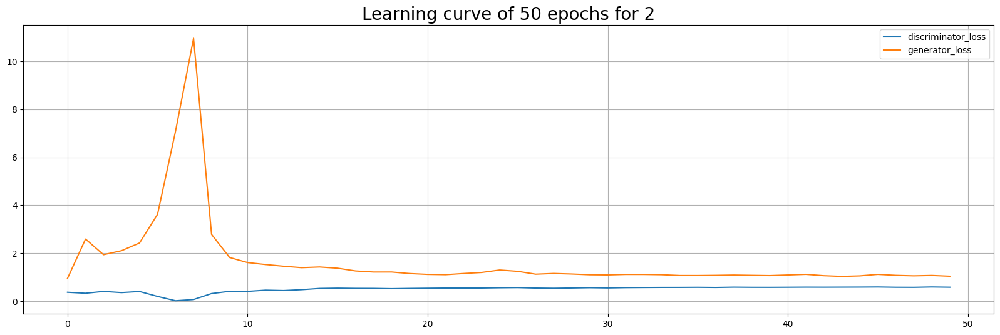

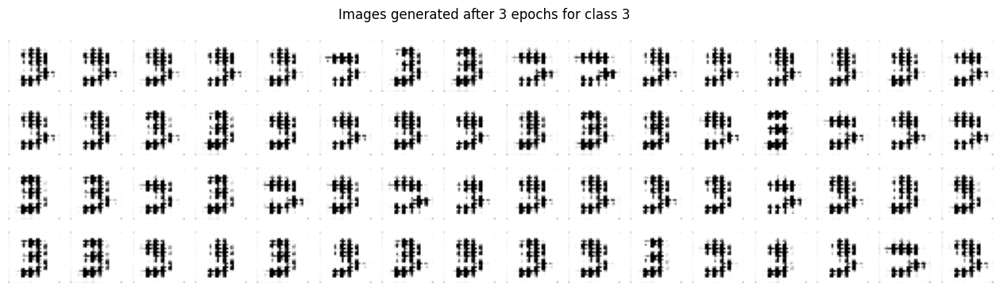

55/55 [==============================] - 11s 203ms/step - discriminator_loss: 0.2960 - generator_loss: 2.7211
Epoch 4/50
55/55 [==============================] - 10s 182ms/step - discriminator_loss: 0.3534 - generator_loss: 2.9611
Epoch 5/50
55/55 [==============================] - 10s 181ms/step - discriminator_loss: 0.3623 - generator_loss: 2.1532
Epoch 6/50
55/55 [==============================] - ETA: 0s - discriminator_loss: 0.3986 - generator_loss: 1.7924

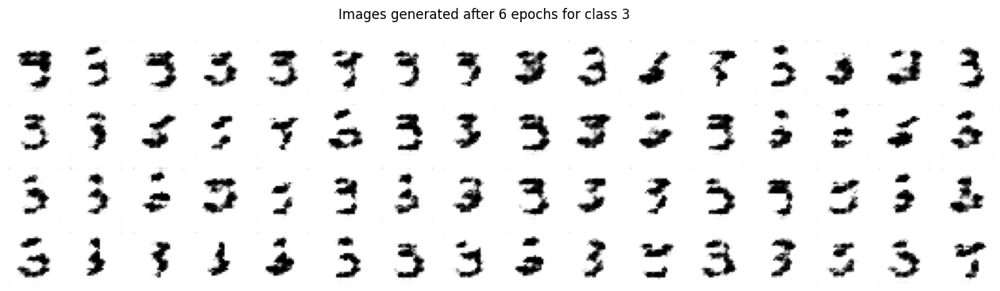

55/55 [==============================] - 11s 197ms/step - discriminator_loss: 0.3986 - generator_loss: 1.7924
Epoch 7/50
55/55 [==============================] - 10s 181ms/step - discriminator_loss: 0.4533 - generator_loss: 1.5938
Epoch 8/50
55/55 [==============================] - 10s 180ms/step - discriminator_loss: 0.5140 - generator_loss: 1.3755
Epoch 9/50
55/55 [==============================] - ETA: 0s - discriminator_loss: 0.4469 - generator_loss: 1.4728

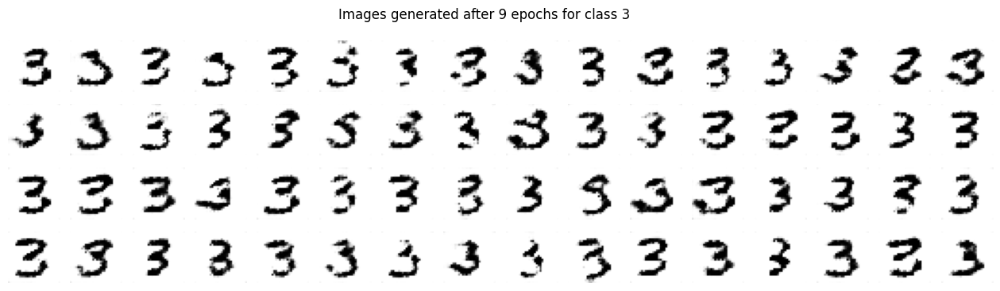

55/55 [==============================] - 11s 199ms/step - discriminator_loss: 0.4469 - generator_loss: 1.4728
Epoch 10/50
55/55 [==============================] - 10s 181ms/step - discriminator_loss: 0.5079 - generator_loss: 1.4224
Epoch 11/50
55/55 [==============================] - 10s 184ms/step - discriminator_loss: 0.4824 - generator_loss: 1.4149
Epoch 12/50
55/55 [==============================] - ETA: 0s - discriminator_loss: 0.5203 - generator_loss: 1.3358

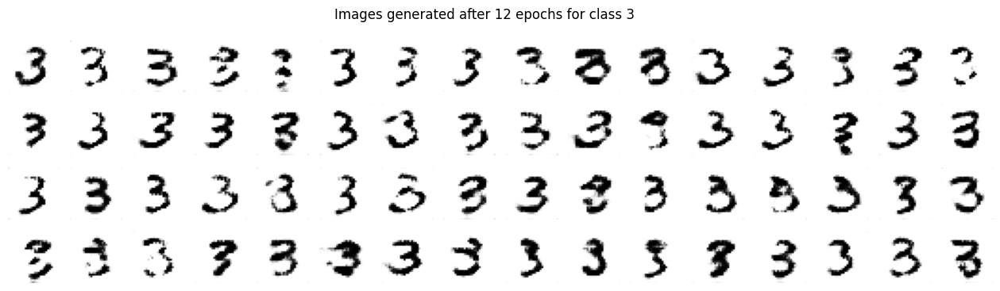

55/55 [==============================] - 11s 200ms/step - discriminator_loss: 0.5203 - generator_loss: 1.3358
Epoch 13/50
55/55 [==============================] - 10s 189ms/step - discriminator_loss: 0.5795 - generator_loss: 1.1684
Epoch 14/50
55/55 [==============================] - 10s 188ms/step - discriminator_loss: 0.5657 - generator_loss: 1.1193
Epoch 15/50
55/55 [==============================] - ETA: 0s - discriminator_loss: 0.5791 - generator_loss: 1.1186

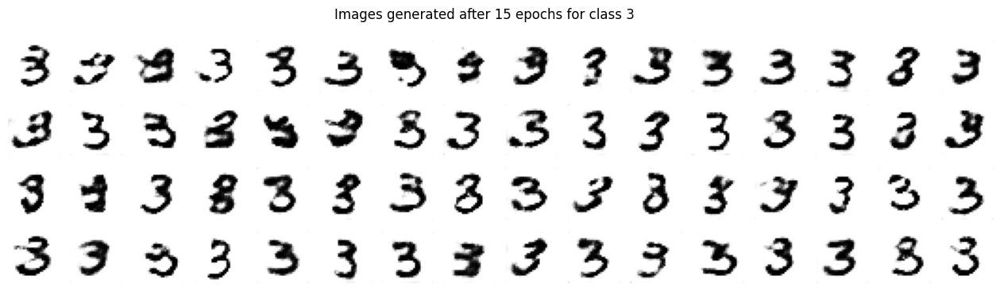

55/55 [==============================] - 11s 203ms/step - discriminator_loss: 0.5791 - generator_loss: 1.1186
Epoch 16/50
55/55 [==============================] - 11s 197ms/step - discriminator_loss: 0.5930 - generator_loss: 1.0879
Epoch 17/50
55/55 [==============================] - 10s 187ms/step - discriminator_loss: 0.5876 - generator_loss: 1.0871
Epoch 18/50
55/55 [==============================] - ETA: 0s - discriminator_loss: 0.5922 - generator_loss: 1.0340

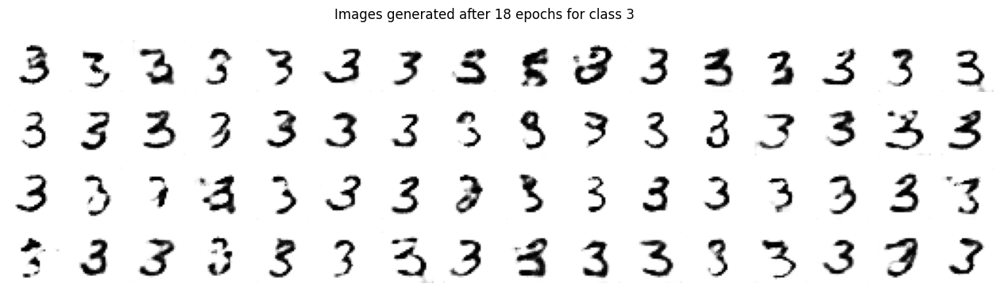

55/55 [==============================] - 13s 228ms/step - discriminator_loss: 0.5922 - generator_loss: 1.0340
Epoch 19/50
55/55 [==============================] - 10s 187ms/step - discriminator_loss: 0.5850 - generator_loss: 1.0015
Epoch 20/50
55/55 [==============================] - 10s 189ms/step - discriminator_loss: 0.5943 - generator_loss: 0.9946
Epoch 21/50
55/55 [==============================] - ETA: 0s - discriminator_loss: 0.6090 - generator_loss: 1.0029

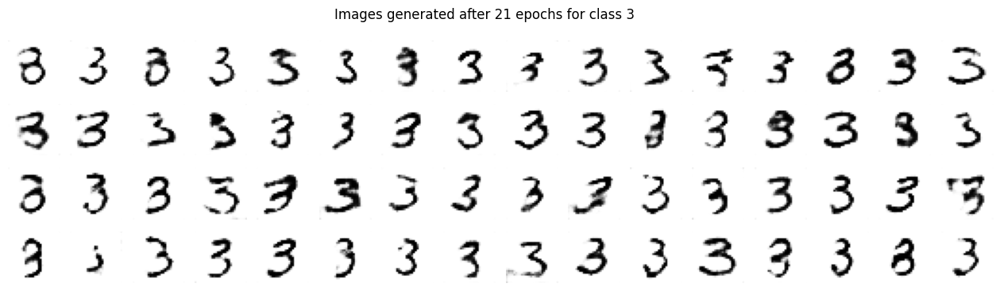

55/55 [==============================] - 11s 209ms/step - discriminator_loss: 0.6090 - generator_loss: 1.0029
Epoch 22/50
55/55 [==============================] - 11s 194ms/step - discriminator_loss: 0.6115 - generator_loss: 1.0116
Epoch 23/50
55/55 [==============================] - 10s 187ms/step - discriminator_loss: 0.6204 - generator_loss: 1.0419
Epoch 24/50
55/55 [==============================] - ETA: 0s - discriminator_loss: 0.6210 - generator_loss: 0.9693

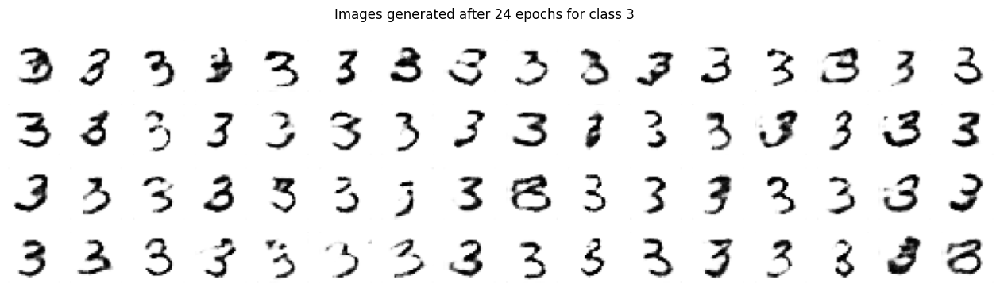

55/55 [==============================] - 12s 211ms/step - discriminator_loss: 0.6210 - generator_loss: 0.9693
Epoch 25/50
55/55 [==============================] - 10s 190ms/step - discriminator_loss: 0.6194 - generator_loss: 0.9882
Epoch 26/50
55/55 [==============================] - 11s 191ms/step - discriminator_loss: 0.6249 - generator_loss: 0.9784
Epoch 27/50
55/55 [==============================] - ETA: 0s - discriminator_loss: 0.6246 - generator_loss: 0.9688

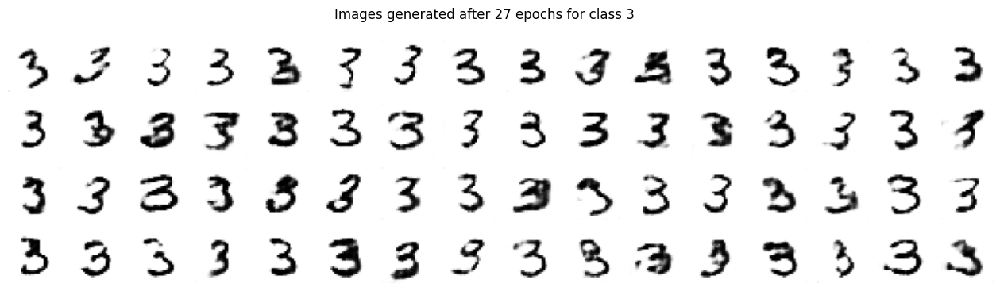

55/55 [==============================] - 11s 203ms/step - discriminator_loss: 0.6246 - generator_loss: 0.9688
Epoch 28/50
55/55 [==============================] - 10s 186ms/step - discriminator_loss: 0.6220 - generator_loss: 0.9509
Epoch 29/50
55/55 [==============================] - 10s 187ms/step - discriminator_loss: 0.6189 - generator_loss: 0.9806
Epoch 30/50
55/55 [==============================] - ETA: 0s - discriminator_loss: 0.6290 - generator_loss: 0.9559

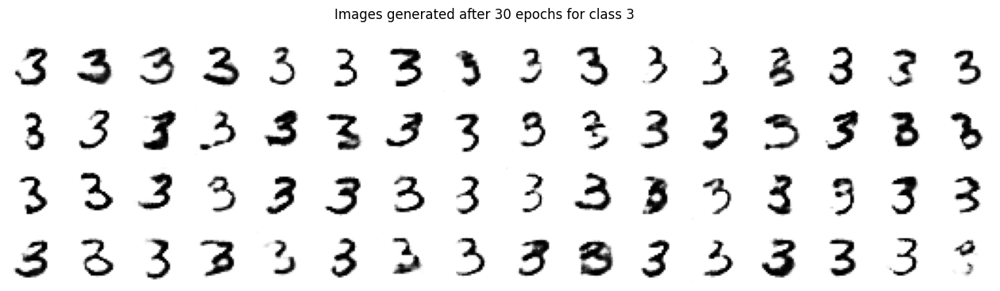

55/55 [==============================] - 11s 199ms/step - discriminator_loss: 0.6290 - generator_loss: 0.9559
Epoch 31/50
55/55 [==============================] - 10s 184ms/step - discriminator_loss: 0.6251 - generator_loss: 0.9349
Epoch 32/50
55/55 [==============================] - 10s 182ms/step - discriminator_loss: 0.6256 - generator_loss: 0.9393
Epoch 33/50
55/55 [==============================] - ETA: 0s - discriminator_loss: 0.6217 - generator_loss: 0.9491

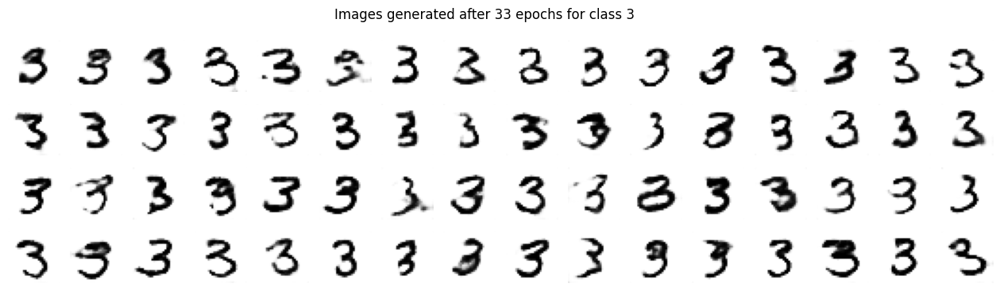

55/55 [==============================] - 11s 197ms/step - discriminator_loss: 0.6217 - generator_loss: 0.9491
Epoch 34/50
55/55 [==============================] - 10s 183ms/step - discriminator_loss: 0.6258 - generator_loss: 0.9608
Epoch 35/50
55/55 [==============================] - 10s 181ms/step - discriminator_loss: 0.6285 - generator_loss: 0.9982
Epoch 36/50
55/55 [==============================] - ETA: 0s - discriminator_loss: 0.6442 - generator_loss: 1.0451

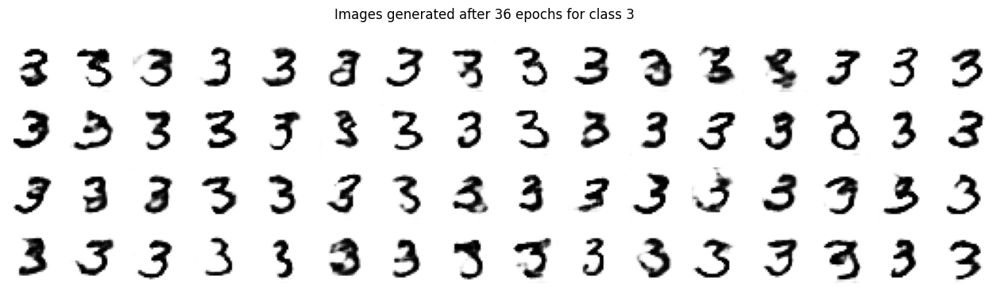

55/55 [==============================] - 11s 199ms/step - discriminator_loss: 0.6442 - generator_loss: 1.0451
Epoch 37/50
55/55 [==============================] - 10s 186ms/step - discriminator_loss: 0.6244 - generator_loss: 0.9832
Epoch 38/50
55/55 [==============================] - 10s 185ms/step - discriminator_loss: 0.6227 - generator_loss: 0.9787
Epoch 39/50
55/55 [==============================] - ETA: 0s - discriminator_loss: 0.6192 - generator_loss: 0.9691

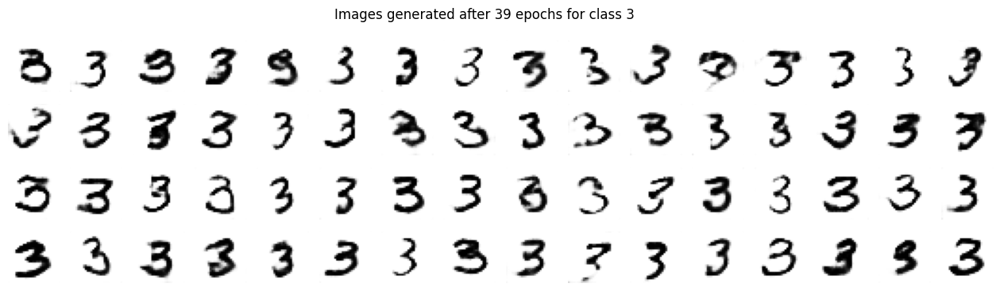

55/55 [==============================] - 11s 199ms/step - discriminator_loss: 0.6192 - generator_loss: 0.9691
Epoch 40/50
55/55 [==============================] - 10s 189ms/step - discriminator_loss: 0.6150 - generator_loss: 0.9602
Epoch 41/50
55/55 [==============================] - 11s 191ms/step - discriminator_loss: 0.6190 - generator_loss: 0.9603
Epoch 42/50
55/55 [==============================] - ETA: 0s - discriminator_loss: 0.6149 - generator_loss: 0.9844

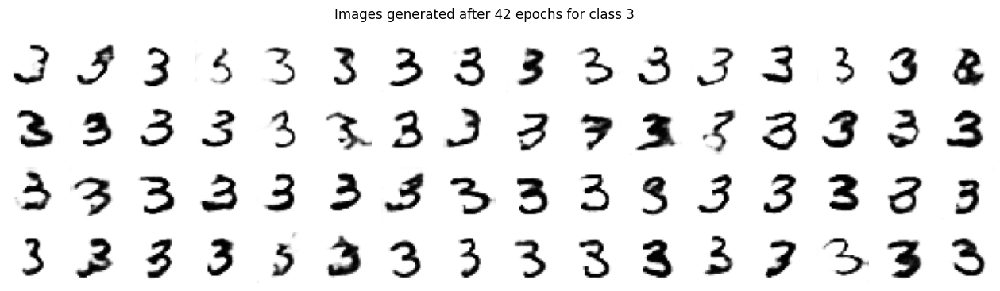

55/55 [==============================] - 11s 204ms/step - discriminator_loss: 0.6149 - generator_loss: 0.9844
Epoch 43/50
55/55 [==============================] - 10s 190ms/step - discriminator_loss: 0.6154 - generator_loss: 0.9565
Epoch 44/50
55/55 [==============================] - 11s 191ms/step - discriminator_loss: 0.6166 - generator_loss: 0.9781
Epoch 45/50
55/55 [==============================] - ETA: 0s - discriminator_loss: 0.6162 - generator_loss: 0.9796

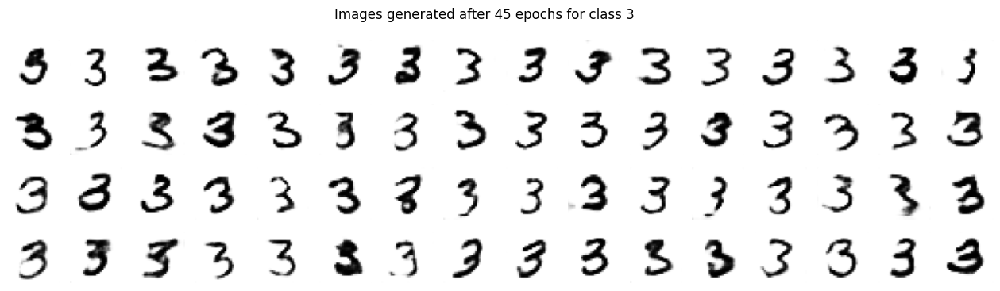

55/55 [==============================] - 11s 205ms/step - discriminator_loss: 0.6162 - generator_loss: 0.9796
Epoch 46/50
55/55 [==============================] - 10s 188ms/step - discriminator_loss: 0.6148 - generator_loss: 0.9980
Epoch 47/50
55/55 [==============================] - 10s 184ms/step - discriminator_loss: 0.6172 - generator_loss: 1.0050
Epoch 48/50
55/55 [==============================] - ETA: 0s - discriminator_loss: 0.6129 - generator_loss: 0.9848

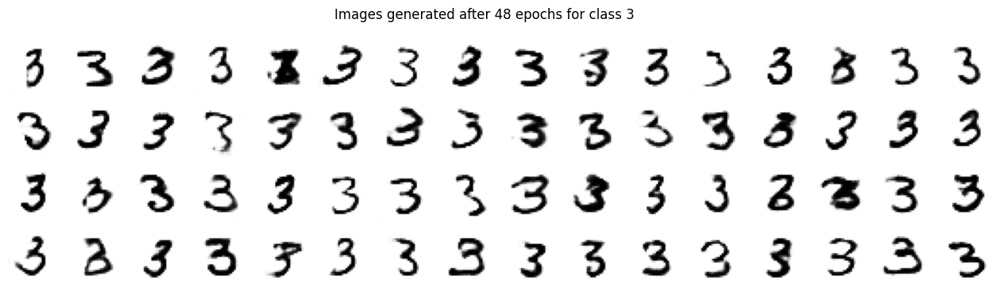

55/55 [==============================] - 11s 202ms/step - discriminator_loss: 0.6129 - generator_loss: 0.9848
Epoch 49/50
55/55 [==============================] - 10s 186ms/step - discriminator_loss: 0.6158 - generator_loss: 1.0025
Epoch 50/50
55/55 [==============================] - 10s 185ms/step - discriminator_loss: 0.6156 - generator_loss: 0.9970
Epoch 1/50
53/53 [==============================] - 10s 184ms/step - discriminator_loss: 0.3642 - generator_loss: 1.0149
Epoch 2/50
53/53 [==============================] - 10s 191ms/step - discriminator_loss: 0.3349 - generator_loss: 2.6923
Epoch 3/50
53/53 [==============================] - ETA: 0s - discriminator_loss: 0.4327 - generator_loss: 1.8830

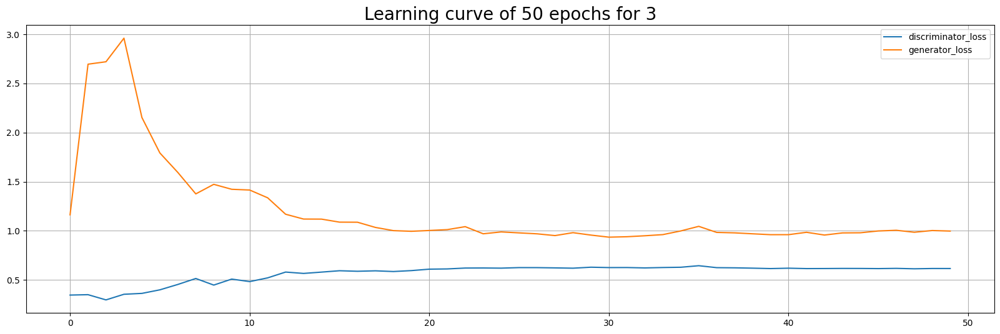

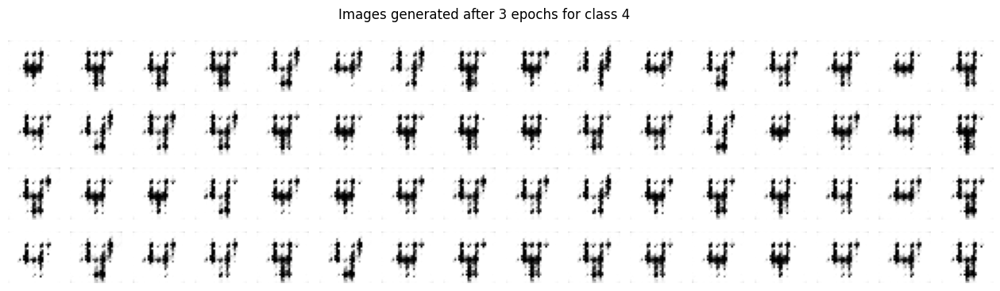

53/53 [==============================] - 11s 210ms/step - discriminator_loss: 0.4327 - generator_loss: 1.8830
Epoch 4/50
53/53 [==============================] - 10s 191ms/step - discriminator_loss: 0.2710 - generator_loss: 2.8443
Epoch 5/50
53/53 [==============================] - 10s 191ms/step - discriminator_loss: 0.3951 - generator_loss: 2.7202
Epoch 6/50
53/53 [==============================] - ETA: 0s - discriminator_loss: 0.4692 - generator_loss: 1.6540

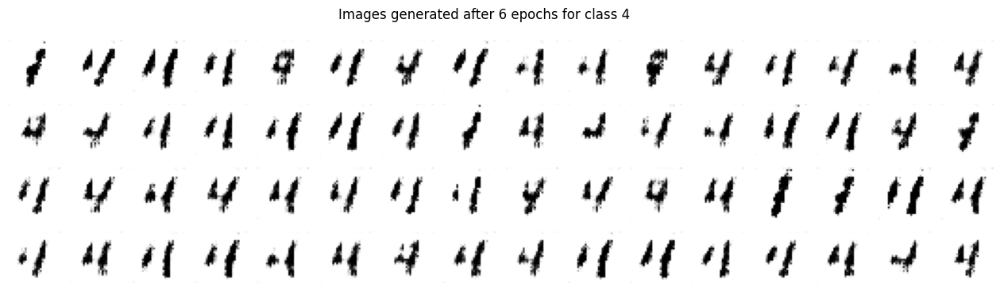

53/53 [==============================] - 11s 207ms/step - discriminator_loss: 0.4692 - generator_loss: 1.6540
Epoch 7/50
53/53 [==============================] - 10s 188ms/step - discriminator_loss: 0.3994 - generator_loss: 1.7228
Epoch 8/50
53/53 [==============================] - 10s 188ms/step - discriminator_loss: 0.3789 - generator_loss: 1.6886
Epoch 9/50
53/53 [==============================] - ETA: 0s - discriminator_loss: 0.4343 - generator_loss: 1.7621

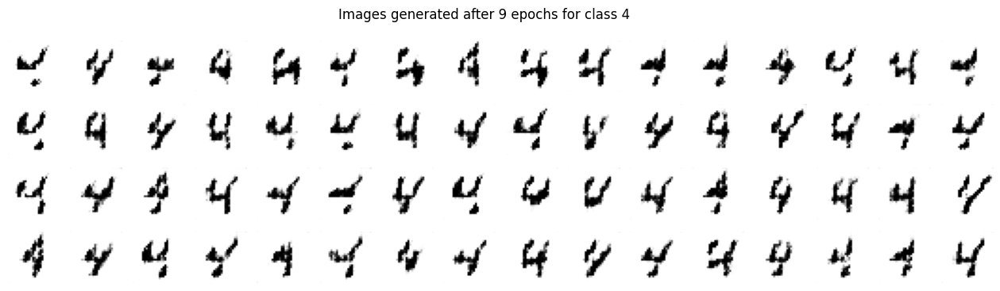

53/53 [==============================] - 11s 205ms/step - discriminator_loss: 0.4343 - generator_loss: 1.7621
Epoch 10/50
53/53 [==============================] - 10s 187ms/step - discriminator_loss: 0.5432 - generator_loss: 1.3968
Epoch 11/50
53/53 [==============================] - 10s 184ms/step - discriminator_loss: 0.5474 - generator_loss: 1.2266
Epoch 12/50
53/53 [==============================] - ETA: 0s - discriminator_loss: 0.5300 - generator_loss: 1.1618

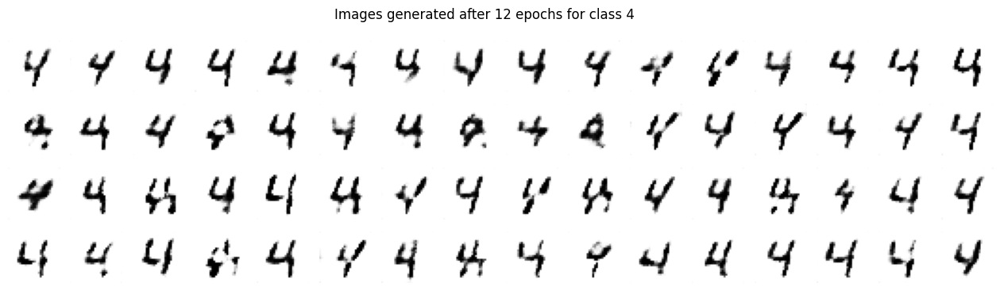

53/53 [==============================] - 11s 202ms/step - discriminator_loss: 0.5300 - generator_loss: 1.1618
Epoch 13/50
53/53 [==============================] - 10s 184ms/step - discriminator_loss: 0.5274 - generator_loss: 1.1987
Epoch 14/50
53/53 [==============================] - 10s 186ms/step - discriminator_loss: 0.5753 - generator_loss: 1.2526
Epoch 15/50
53/53 [==============================] - ETA: 0s - discriminator_loss: 0.5417 - generator_loss: 1.2096

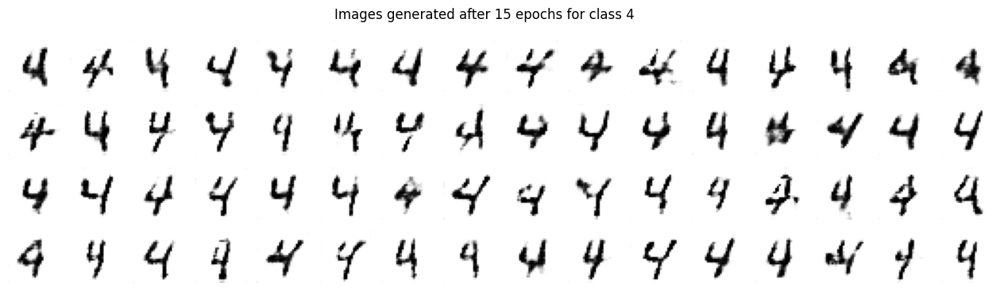

53/53 [==============================] - 11s 203ms/step - discriminator_loss: 0.5417 - generator_loss: 1.2096
Epoch 16/50
53/53 [==============================] - 10s 187ms/step - discriminator_loss: 0.5591 - generator_loss: 1.1556
Epoch 17/50
53/53 [==============================] - 10s 188ms/step - discriminator_loss: 0.5785 - generator_loss: 1.0988
Epoch 18/50
53/53 [==============================] - ETA: 0s - discriminator_loss: 0.5696 - generator_loss: 1.1200

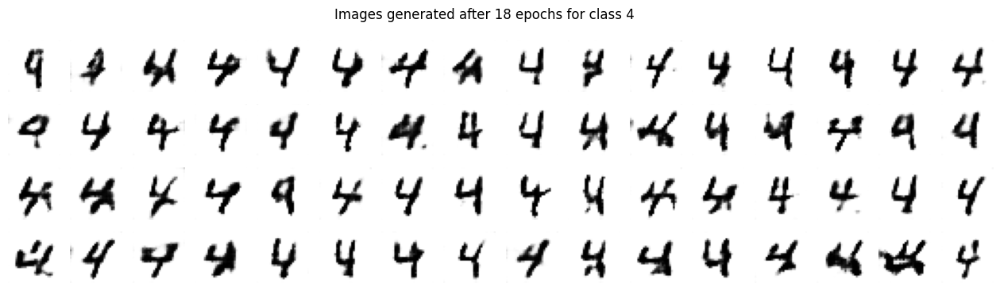

53/53 [==============================] - 11s 204ms/step - discriminator_loss: 0.5696 - generator_loss: 1.1200
Epoch 19/50
53/53 [==============================] - 10s 182ms/step - discriminator_loss: 0.5709 - generator_loss: 1.0809
Epoch 20/50
53/53 [==============================] - 10s 184ms/step - discriminator_loss: 0.5880 - generator_loss: 1.0633
Epoch 21/50
53/53 [==============================] - ETA: 0s - discriminator_loss: 0.5984 - generator_loss: 1.0513

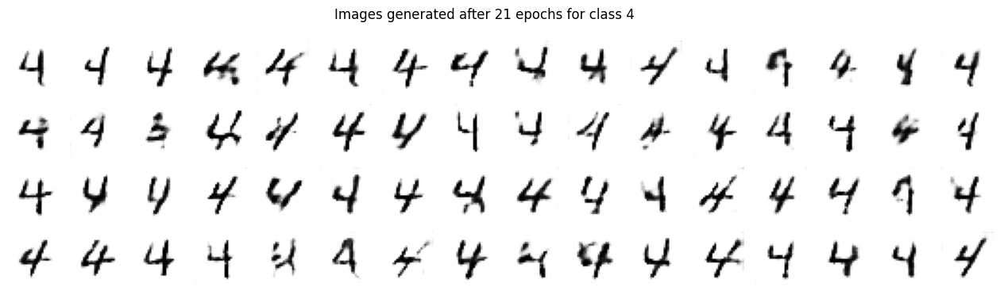

53/53 [==============================] - 11s 203ms/step - discriminator_loss: 0.5984 - generator_loss: 1.0513
Epoch 22/50
53/53 [==============================] - 10s 190ms/step - discriminator_loss: 0.6075 - generator_loss: 1.0419
Epoch 23/50
53/53 [==============================] - 10s 186ms/step - discriminator_loss: 0.6144 - generator_loss: 1.0296
Epoch 24/50
53/53 [==============================] - ETA: 0s - discriminator_loss: 0.6118 - generator_loss: 1.0275

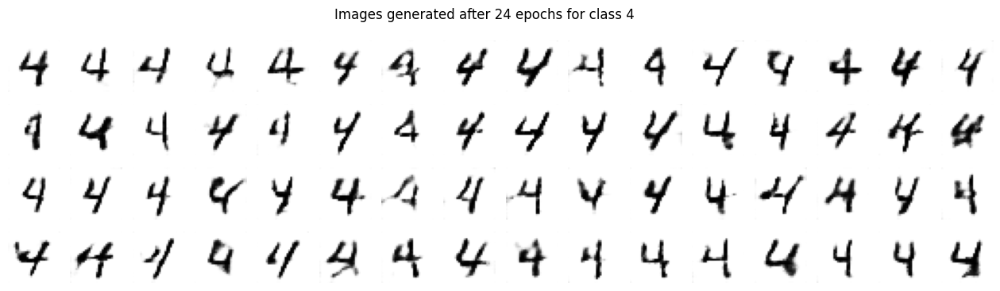

53/53 [==============================] - 11s 204ms/step - discriminator_loss: 0.6118 - generator_loss: 1.0275
Epoch 25/50
53/53 [==============================] - 10s 188ms/step - discriminator_loss: 0.6109 - generator_loss: 0.9759
Epoch 26/50
53/53 [==============================] - 10s 190ms/step - discriminator_loss: 0.6118 - generator_loss: 0.9725
Epoch 27/50
53/53 [==============================] - ETA: 0s - discriminator_loss: 0.6164 - generator_loss: 1.0033

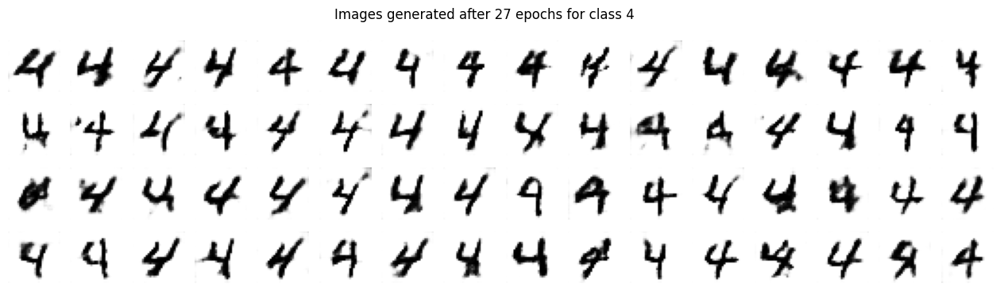

53/53 [==============================] - 11s 205ms/step - discriminator_loss: 0.6164 - generator_loss: 1.0033
Epoch 28/50
53/53 [==============================] - 10s 190ms/step - discriminator_loss: 0.6305 - generator_loss: 1.0078
Epoch 29/50
53/53 [==============================] - 10s 184ms/step - discriminator_loss: 0.6117 - generator_loss: 0.9971
Epoch 30/50
53/53 [==============================] - ETA: 0s - discriminator_loss: 0.6115 - generator_loss: 1.0347

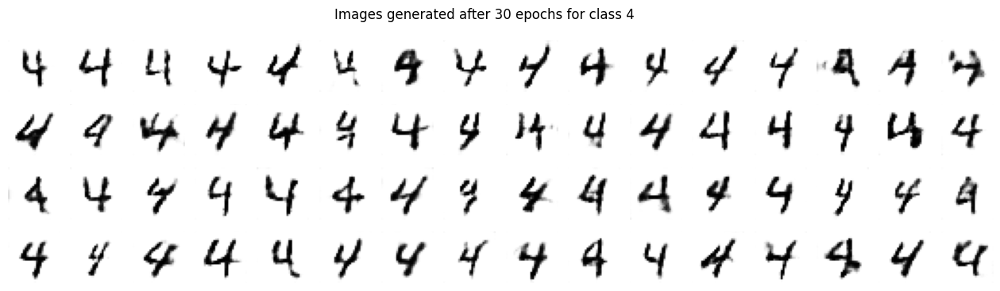

53/53 [==============================] - 11s 203ms/step - discriminator_loss: 0.6115 - generator_loss: 1.0347
Epoch 31/50
53/53 [==============================] - 10s 195ms/step - discriminator_loss: 0.6235 - generator_loss: 0.9938
Epoch 32/50
53/53 [==============================] - 10s 194ms/step - discriminator_loss: 0.6069 - generator_loss: 0.9668
Epoch 33/50
53/53 [==============================] - ETA: 0s - discriminator_loss: 0.6062 - generator_loss: 0.9825

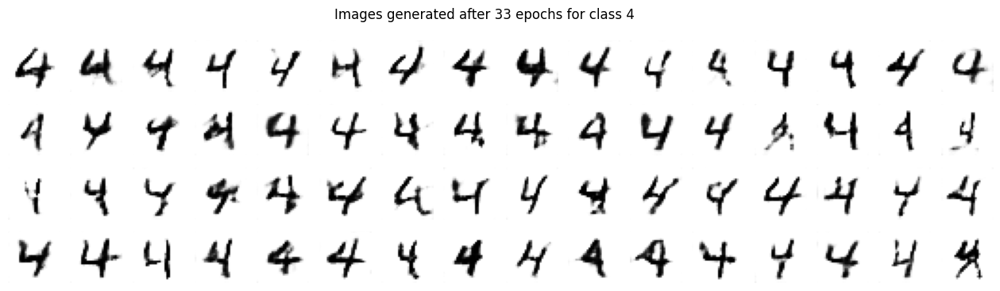

53/53 [==============================] - 11s 201ms/step - discriminator_loss: 0.6062 - generator_loss: 0.9825
Epoch 34/50
53/53 [==============================] - 10s 187ms/step - discriminator_loss: 0.6086 - generator_loss: 1.0016
Epoch 35/50
53/53 [==============================] - 10s 188ms/step - discriminator_loss: 0.6174 - generator_loss: 1.0052
Epoch 36/50
53/53 [==============================] - ETA: 0s - discriminator_loss: 0.6143 - generator_loss: 0.9953

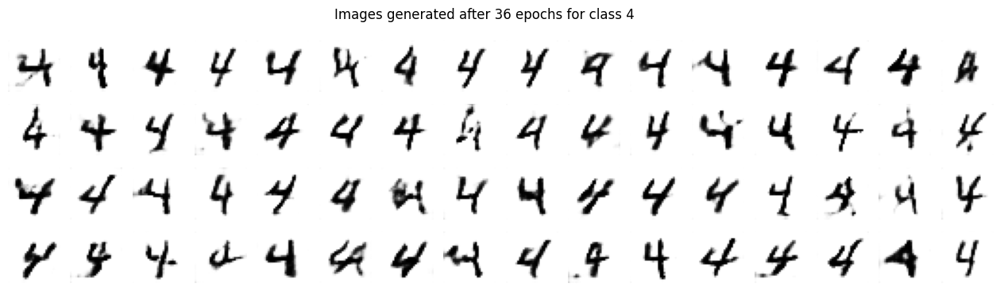

53/53 [==============================] - 11s 204ms/step - discriminator_loss: 0.6143 - generator_loss: 0.9953
Epoch 37/50
53/53 [==============================] - 10s 188ms/step - discriminator_loss: 0.6055 - generator_loss: 0.9924
Epoch 38/50
53/53 [==============================] - 10s 189ms/step - discriminator_loss: 0.6083 - generator_loss: 0.9692
Epoch 39/50
53/53 [==============================] - ETA: 0s - discriminator_loss: 0.6124 - generator_loss: 0.9724

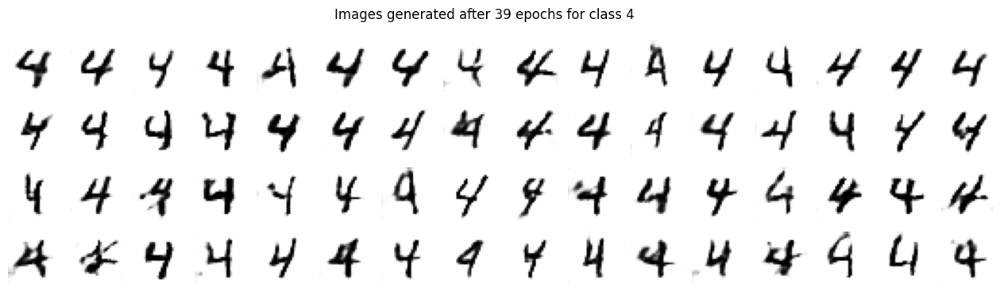

53/53 [==============================] - 11s 206ms/step - discriminator_loss: 0.6124 - generator_loss: 0.9724
Epoch 40/50
53/53 [==============================] - 10s 187ms/step - discriminator_loss: 0.6096 - generator_loss: 0.9909
Epoch 41/50
53/53 [==============================] - 10s 190ms/step - discriminator_loss: 0.6087 - generator_loss: 1.0100
Epoch 42/50
53/53 [==============================] - ETA: 0s - discriminator_loss: 0.6144 - generator_loss: 1.0058

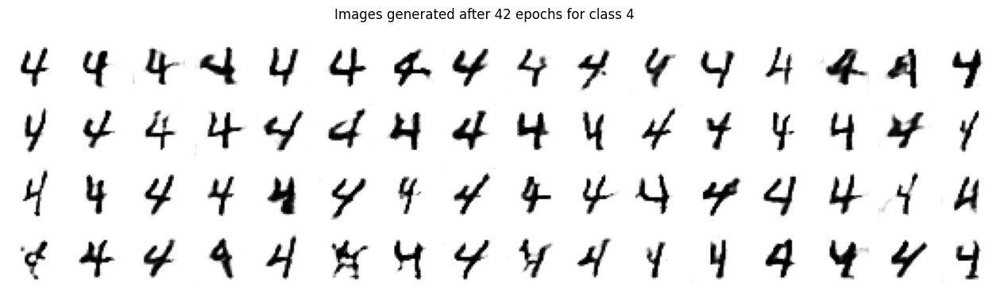

53/53 [==============================] - 11s 210ms/step - discriminator_loss: 0.6144 - generator_loss: 1.0058
Epoch 43/50
53/53 [==============================] - 10s 190ms/step - discriminator_loss: 0.6117 - generator_loss: 1.0055
Epoch 44/50
53/53 [==============================] - 10s 188ms/step - discriminator_loss: 0.6113 - generator_loss: 0.9689
Epoch 45/50
53/53 [==============================] - ETA: 0s - discriminator_loss: 0.6177 - generator_loss: 0.9725

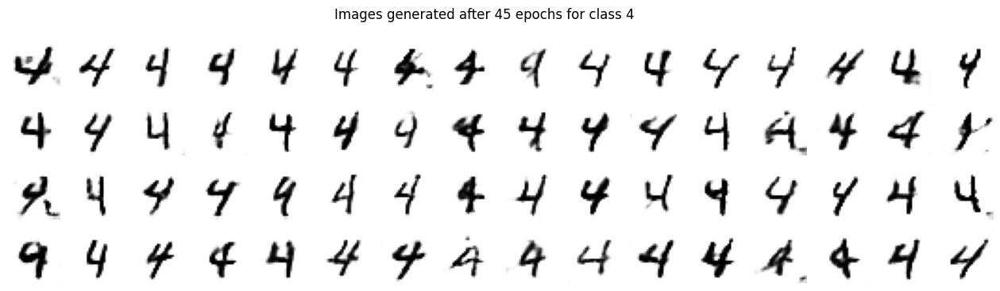

53/53 [==============================] - 11s 206ms/step - discriminator_loss: 0.6177 - generator_loss: 0.9725
Epoch 46/50
53/53 [==============================] - 10s 186ms/step - discriminator_loss: 0.6147 - generator_loss: 0.9763
Epoch 47/50
53/53 [==============================] - 10s 189ms/step - discriminator_loss: 0.6103 - generator_loss: 0.9449
Epoch 48/50
53/53 [==============================] - ETA: 0s - discriminator_loss: 0.6211 - generator_loss: 0.9489

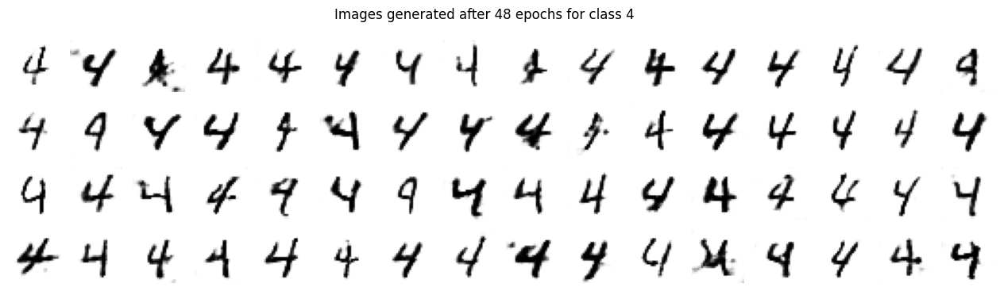

53/53 [==============================] - 11s 207ms/step - discriminator_loss: 0.6211 - generator_loss: 0.9489
Epoch 49/50
53/53 [==============================] - 10s 189ms/step - discriminator_loss: 0.6193 - generator_loss: 0.9803
Epoch 50/50
53/53 [==============================] - 10s 193ms/step - discriminator_loss: 0.6177 - generator_loss: 0.9683
Epoch 1/50
49/49 [==============================] - 10s 186ms/step - discriminator_loss: 0.3983 - generator_loss: 0.9065
Epoch 2/50
49/49 [==============================] - 9s 184ms/step - discriminator_loss: 0.2884 - generator_loss: 2.5046
Epoch 3/50
49/49 [==============================] - ETA: 0s - discriminator_loss: 0.3084 - generator_loss: 2.5060

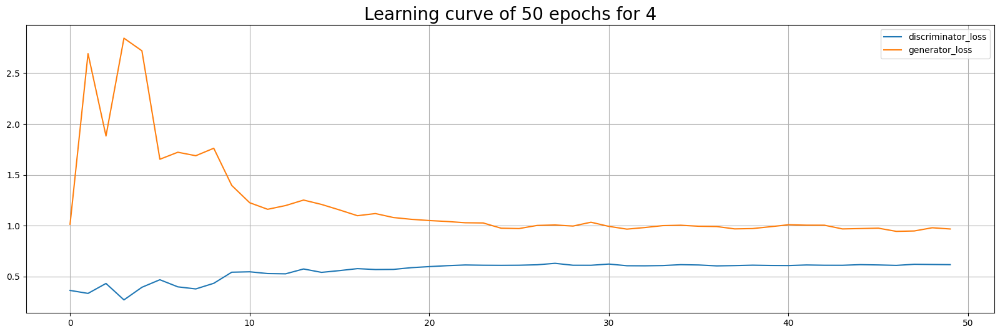

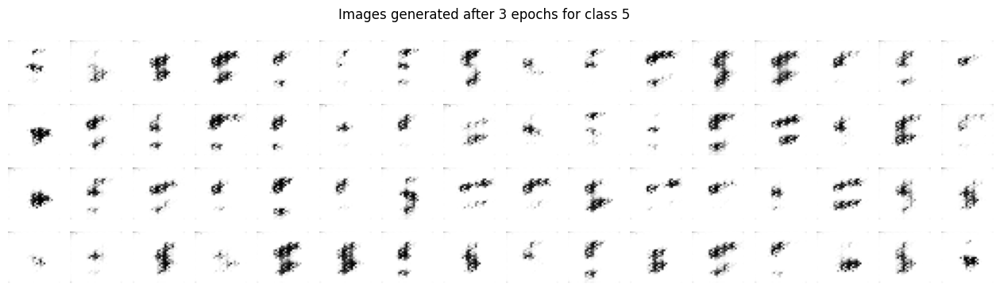

49/49 [==============================] - 10s 202ms/step - discriminator_loss: 0.3084 - generator_loss: 2.5060
Epoch 4/50
49/49 [==============================] - 9s 184ms/step - discriminator_loss: 0.4011 - generator_loss: 2.1963
Epoch 5/50
49/49 [==============================] - 9s 183ms/step - discriminator_loss: 0.3912 - generator_loss: 1.9043
Epoch 6/50
49/49 [==============================] - ETA: 0s - discriminator_loss: 0.3291 - generator_loss: 2.5333

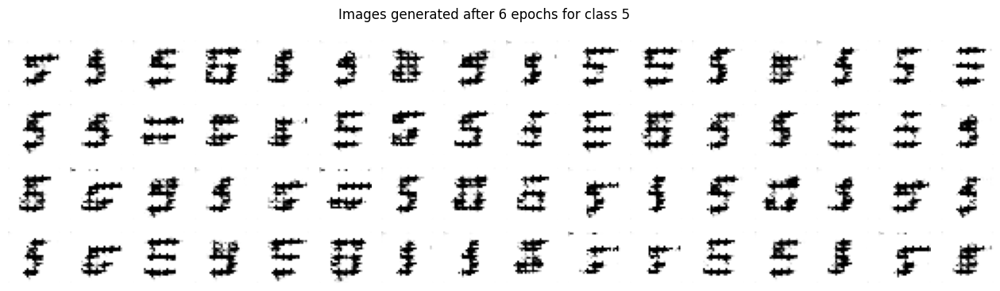

49/49 [==============================] - 10s 204ms/step - discriminator_loss: 0.3291 - generator_loss: 2.5333
Epoch 7/50
49/49 [==============================] - 9s 184ms/step - discriminator_loss: 0.2887 - generator_loss: 2.7932
Epoch 8/50
49/49 [==============================] - 9s 185ms/step - discriminator_loss: 0.3656 - generator_loss: 2.3440
Epoch 9/50
49/49 [==============================] - ETA: 0s - discriminator_loss: 0.4861 - generator_loss: 1.5137

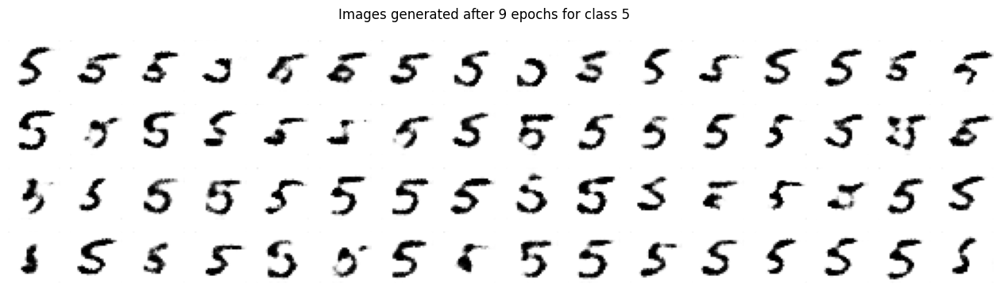

49/49 [==============================] - 10s 207ms/step - discriminator_loss: 0.4861 - generator_loss: 1.5137
Epoch 10/50
49/49 [==============================] - 9s 186ms/step - discriminator_loss: 0.5078 - generator_loss: 1.3020
Epoch 11/50
49/49 [==============================] - 9s 189ms/step - discriminator_loss: 0.4837 - generator_loss: 1.2837
Epoch 12/50
49/49 [==============================] - ETA: 0s - discriminator_loss: 0.5121 - generator_loss: 1.2396

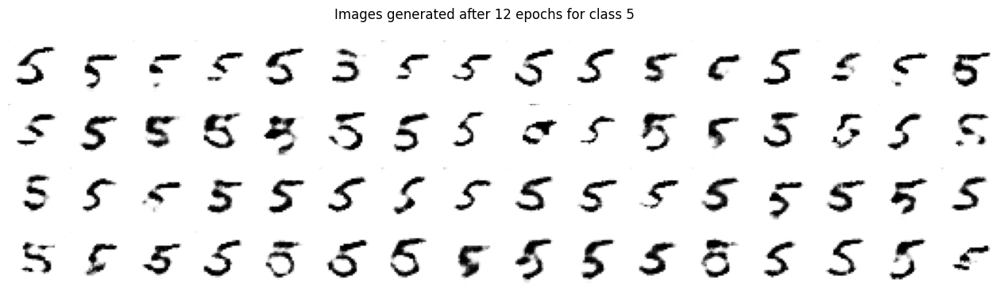

49/49 [==============================] - 10s 208ms/step - discriminator_loss: 0.5121 - generator_loss: 1.2396
Epoch 13/50
49/49 [==============================] - 9s 192ms/step - discriminator_loss: 0.5401 - generator_loss: 1.2019
Epoch 14/50
49/49 [==============================] - 9s 191ms/step - discriminator_loss: 0.5676 - generator_loss: 1.1391
Epoch 15/50
49/49 [==============================] - ETA: 0s - discriminator_loss: 0.5742 - generator_loss: 1.1037

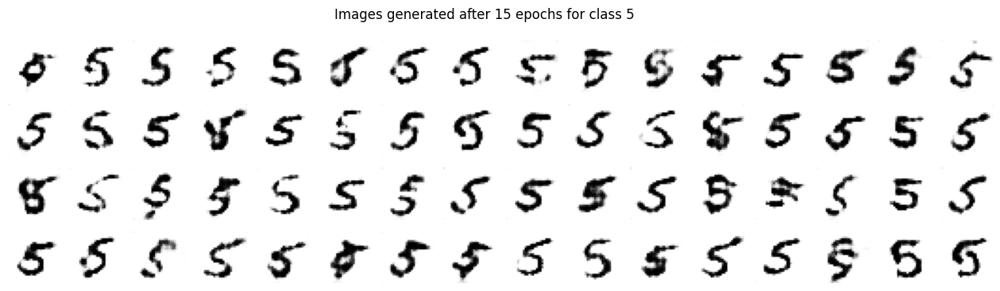

49/49 [==============================] - 10s 208ms/step - discriminator_loss: 0.5742 - generator_loss: 1.1037
Epoch 16/50
49/49 [==============================] - 9s 190ms/step - discriminator_loss: 0.5877 - generator_loss: 1.2095
Epoch 17/50
49/49 [==============================] - 9s 191ms/step - discriminator_loss: 0.5858 - generator_loss: 1.1896
Epoch 18/50
49/49 [==============================] - ETA: 0s - discriminator_loss: 0.5898 - generator_loss: 1.1191

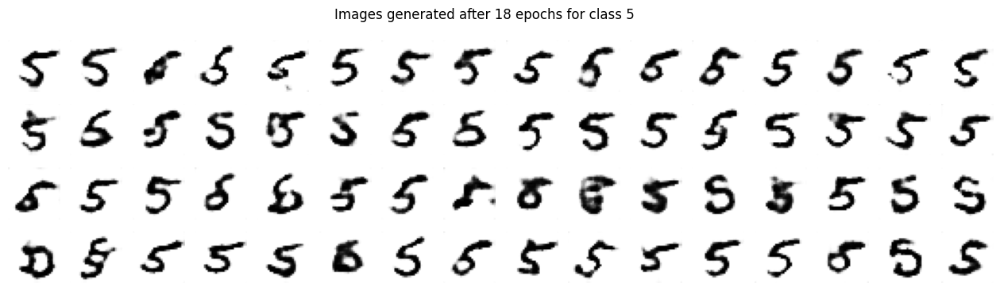

49/49 [==============================] - 10s 210ms/step - discriminator_loss: 0.5898 - generator_loss: 1.1191
Epoch 19/50
49/49 [==============================] - 9s 188ms/step - discriminator_loss: 0.5929 - generator_loss: 1.1291
Epoch 20/50
49/49 [==============================] - 9s 188ms/step - discriminator_loss: 0.5951 - generator_loss: 1.0612
Epoch 21/50
49/49 [==============================] - ETA: 0s - discriminator_loss: 0.5734 - generator_loss: 1.0392

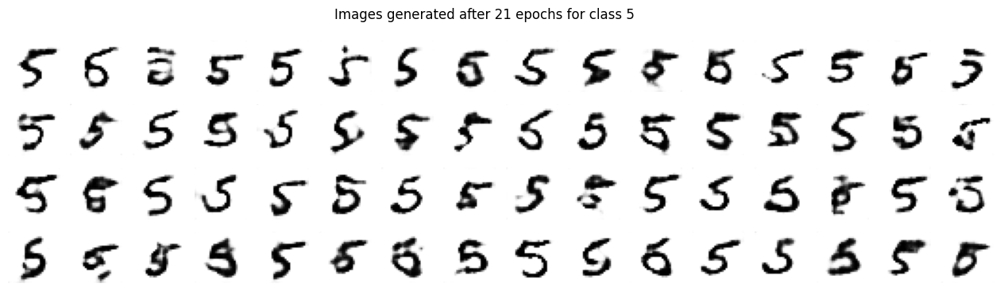

49/49 [==============================] - 10s 206ms/step - discriminator_loss: 0.5734 - generator_loss: 1.0392
Epoch 22/50
49/49 [==============================] - 9s 192ms/step - discriminator_loss: 0.6004 - generator_loss: 1.1539
Epoch 23/50
49/49 [==============================] - 10s 195ms/step - discriminator_loss: 0.5947 - generator_loss: 1.0690
Epoch 24/50
49/49 [==============================] - ETA: 0s - discriminator_loss: 0.5866 - generator_loss: 1.0308

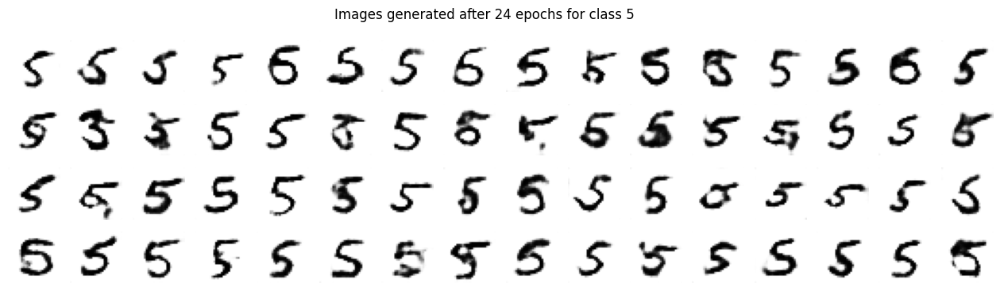

49/49 [==============================] - 10s 212ms/step - discriminator_loss: 0.5866 - generator_loss: 1.0308
Epoch 25/50
49/49 [==============================] - 9s 192ms/step - discriminator_loss: 0.5995 - generator_loss: 1.0529
Epoch 26/50
49/49 [==============================] - 9s 191ms/step - discriminator_loss: 0.6103 - generator_loss: 1.0676
Epoch 27/50
49/49 [==============================] - ETA: 0s - discriminator_loss: 0.6031 - generator_loss: 1.0035

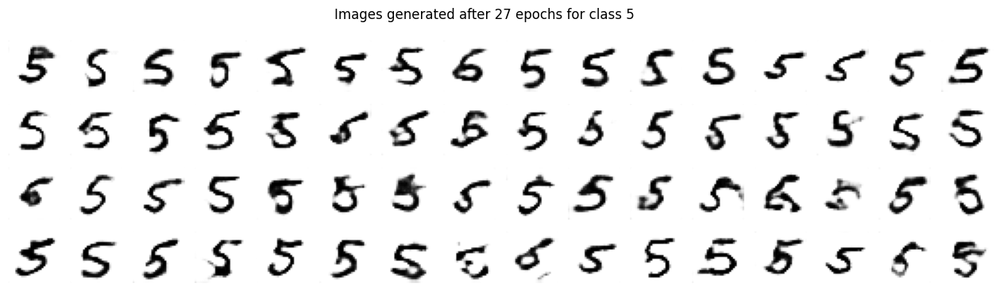

49/49 [==============================] - 10s 210ms/step - discriminator_loss: 0.6031 - generator_loss: 1.0035
Epoch 28/50
49/49 [==============================] - 9s 193ms/step - discriminator_loss: 0.6053 - generator_loss: 1.0214
Epoch 29/50
49/49 [==============================] - 10s 196ms/step - discriminator_loss: 0.6201 - generator_loss: 1.0027
Epoch 30/50
49/49 [==============================] - ETA: 0s - discriminator_loss: 0.6088 - generator_loss: 0.9622

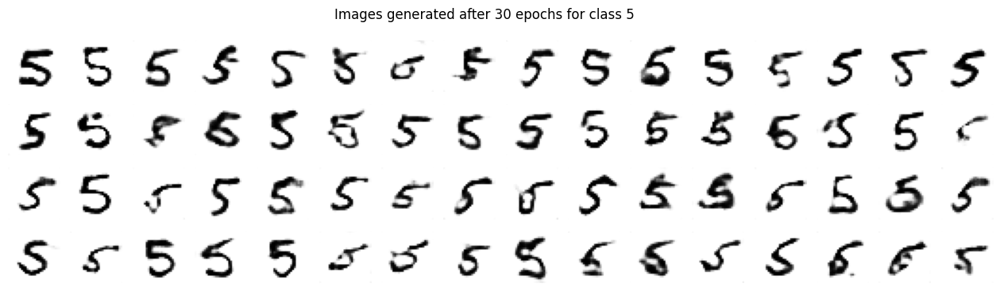

49/49 [==============================] - 11s 218ms/step - discriminator_loss: 0.6088 - generator_loss: 0.9622
Epoch 31/50
49/49 [==============================] - 10s 205ms/step - discriminator_loss: 0.6075 - generator_loss: 1.0179
Epoch 32/50
49/49 [==============================] - 9s 192ms/step - discriminator_loss: 0.6035 - generator_loss: 1.0573
Epoch 33/50
49/49 [==============================] - ETA: 0s - discriminator_loss: 0.6097 - generator_loss: 1.0179

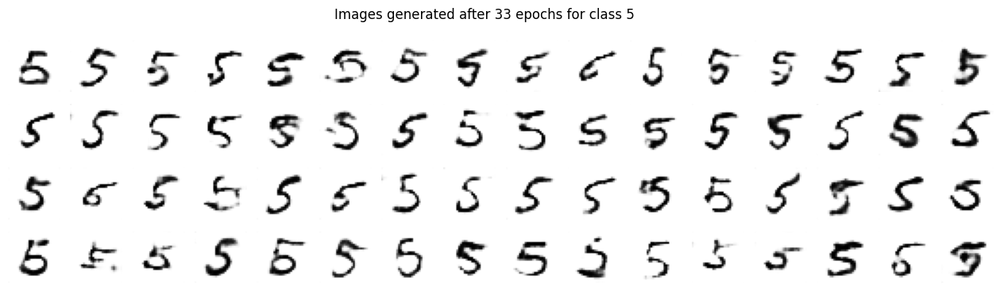

49/49 [==============================] - 10s 202ms/step - discriminator_loss: 0.6097 - generator_loss: 1.0179
Epoch 34/50
49/49 [==============================] - 9s 185ms/step - discriminator_loss: 0.5933 - generator_loss: 0.9937
Epoch 35/50
49/49 [==============================] - 9s 183ms/step - discriminator_loss: 0.5979 - generator_loss: 0.9939
Epoch 36/50
49/49 [==============================] - ETA: 0s - discriminator_loss: 0.5987 - generator_loss: 1.0127

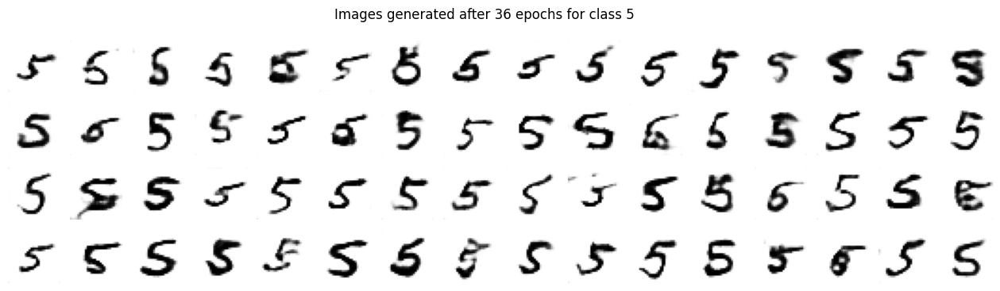

49/49 [==============================] - 10s 201ms/step - discriminator_loss: 0.5987 - generator_loss: 1.0127
Epoch 37/50
49/49 [==============================] - 9s 182ms/step - discriminator_loss: 0.6026 - generator_loss: 1.0086
Epoch 38/50
49/49 [==============================] - 9s 181ms/step - discriminator_loss: 0.5906 - generator_loss: 0.9987
Epoch 39/50
49/49 [==============================] - ETA: 0s - discriminator_loss: 0.5965 - generator_loss: 1.0218

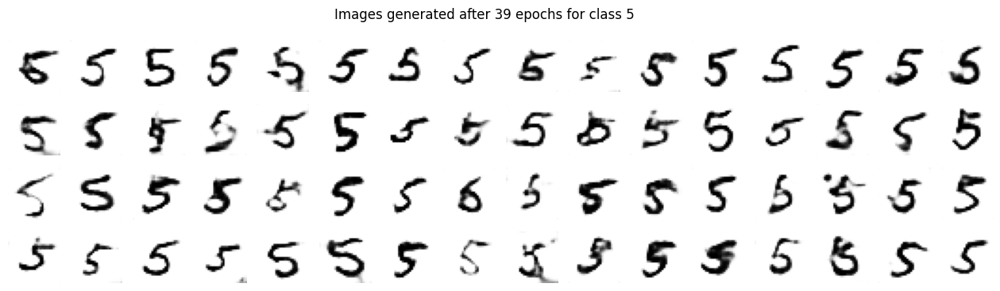

49/49 [==============================] - 10s 209ms/step - discriminator_loss: 0.5965 - generator_loss: 1.0218
Epoch 40/50
49/49 [==============================] - 9s 189ms/step - discriminator_loss: 0.5999 - generator_loss: 1.0423
Epoch 41/50
49/49 [==============================] - 9s 189ms/step - discriminator_loss: 0.5952 - generator_loss: 1.0317
Epoch 42/50
49/49 [==============================] - ETA: 0s - discriminator_loss: 0.5999 - generator_loss: 1.1292

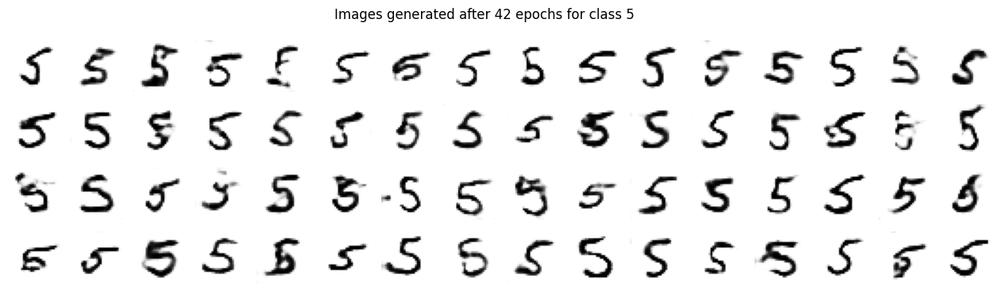

49/49 [==============================] - 10s 208ms/step - discriminator_loss: 0.5999 - generator_loss: 1.1292
Epoch 43/50
49/49 [==============================] - 9s 188ms/step - discriminator_loss: 0.6166 - generator_loss: 1.1189
Epoch 44/50
49/49 [==============================] - 9s 189ms/step - discriminator_loss: 0.5875 - generator_loss: 1.0618
Epoch 45/50
49/49 [==============================] - ETA: 0s - discriminator_loss: 0.5990 - generator_loss: 1.1136

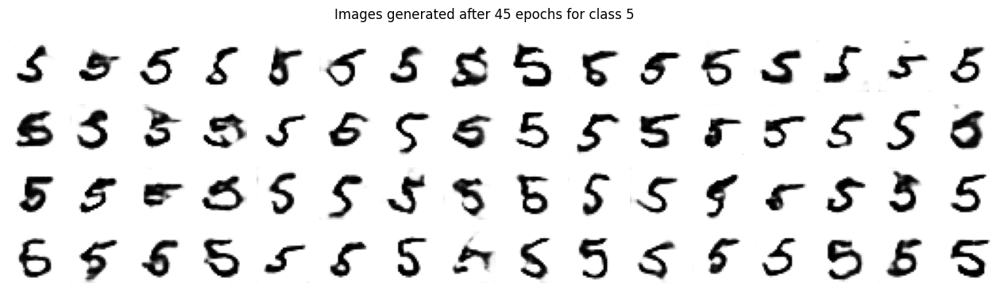

49/49 [==============================] - 10s 205ms/step - discriminator_loss: 0.5990 - generator_loss: 1.1136
Epoch 46/50
49/49 [==============================] - 9s 184ms/step - discriminator_loss: 0.5904 - generator_loss: 1.1317
Epoch 47/50
49/49 [==============================] - 9s 186ms/step - discriminator_loss: 0.5903 - generator_loss: 1.0519
Epoch 48/50
49/49 [==============================] - ETA: 0s - discriminator_loss: 0.5852 - generator_loss: 1.0515

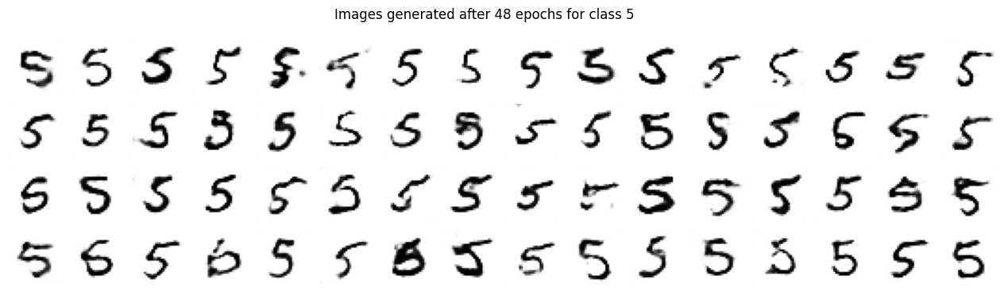

49/49 [==============================] - 10s 201ms/step - discriminator_loss: 0.5852 - generator_loss: 1.0515
Epoch 49/50
49/49 [==============================] - 9s 185ms/step - discriminator_loss: 0.5929 - generator_loss: 1.0336
Epoch 50/50
49/49 [==============================] - 9s 187ms/step - discriminator_loss: 0.5878 - generator_loss: 1.0385
Epoch 1/50
53/53 [==============================] - 10s 187ms/step - discriminator_loss: 0.3731 - generator_loss: 0.9967
Epoch 2/50
53/53 [==============================] - 10s 183ms/step - discriminator_loss: 0.4011 - generator_loss: 1.9160
Epoch 3/50
53/53 [==============================] - ETA: 0s - discriminator_loss: 0.3672 - generator_loss: 2.2237

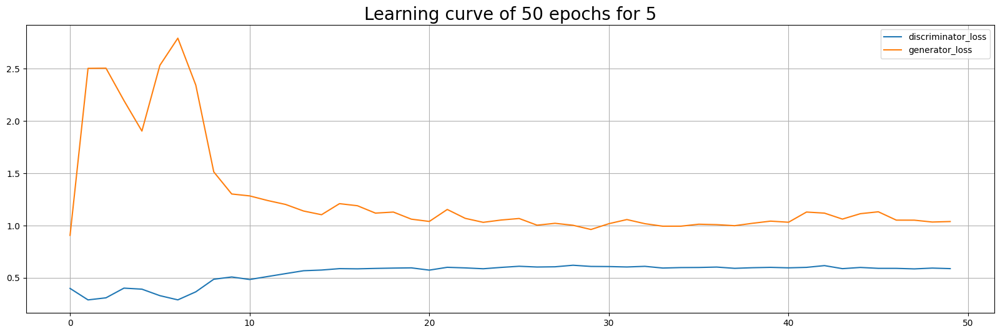

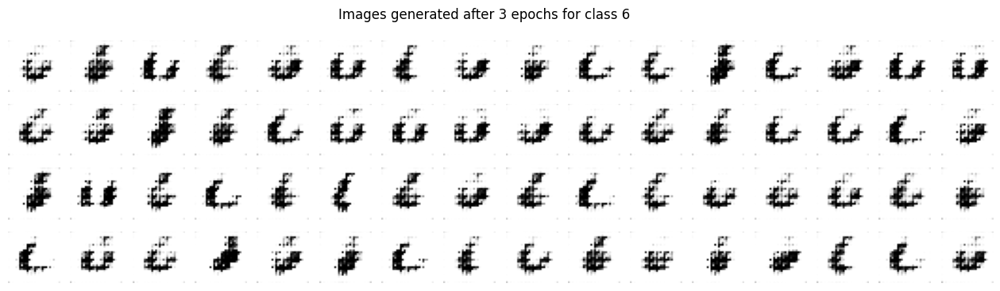

53/53 [==============================] - 11s 204ms/step - discriminator_loss: 0.3672 - generator_loss: 2.2237
Epoch 4/50
53/53 [==============================] - 10s 183ms/step - discriminator_loss: 0.4224 - generator_loss: 1.7119
Epoch 5/50
53/53 [==============================] - 10s 184ms/step - discriminator_loss: 0.4748 - generator_loss: 1.5455
Epoch 6/50
53/53 [==============================] - ETA: 0s - discriminator_loss: 0.5723 - generator_loss: 1.2555

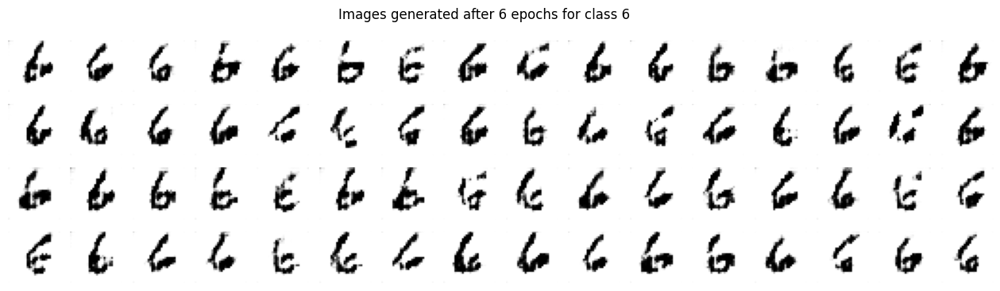

53/53 [==============================] - 11s 200ms/step - discriminator_loss: 0.5723 - generator_loss: 1.2555
Epoch 7/50
53/53 [==============================] - 10s 187ms/step - discriminator_loss: 0.5632 - generator_loss: 1.1543
Epoch 8/50
53/53 [==============================] - 10s 191ms/step - discriminator_loss: 0.5513 - generator_loss: 1.1429
Epoch 9/50
53/53 [==============================] - ETA: 0s - discriminator_loss: 0.4938 - generator_loss: 1.3352

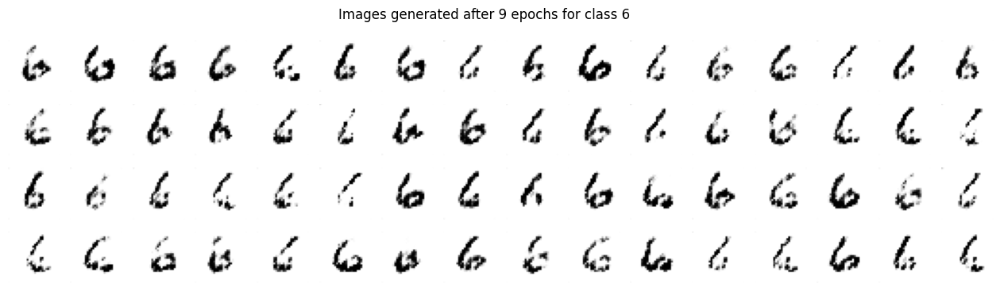

53/53 [==============================] - 11s 204ms/step - discriminator_loss: 0.4938 - generator_loss: 1.3352
Epoch 10/50
53/53 [==============================] - 10s 191ms/step - discriminator_loss: 0.5443 - generator_loss: 1.4000
Epoch 11/50
53/53 [==============================] - 10s 191ms/step - discriminator_loss: 0.5755 - generator_loss: 1.2251
Epoch 12/50
53/53 [==============================] - ETA: 0s - discriminator_loss: 0.5677 - generator_loss: 1.1441

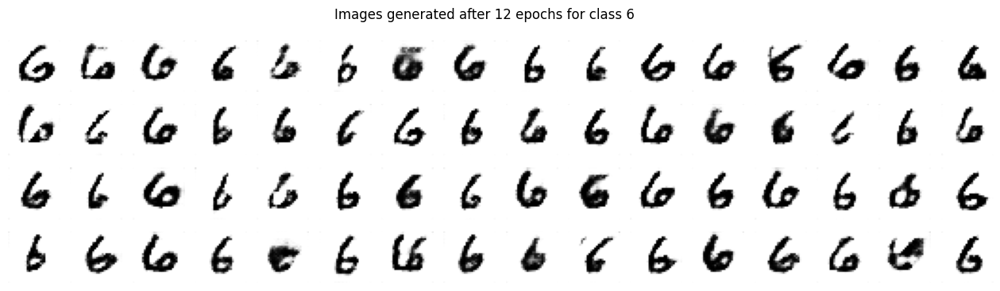

53/53 [==============================] - 11s 201ms/step - discriminator_loss: 0.5677 - generator_loss: 1.1441
Epoch 13/50
53/53 [==============================] - 10s 194ms/step - discriminator_loss: 0.5557 - generator_loss: 1.1007
Epoch 14/50
53/53 [==============================] - 10s 187ms/step - discriminator_loss: 0.5622 - generator_loss: 1.0628
Epoch 15/50
53/53 [==============================] - ETA: 0s - discriminator_loss: 0.5630 - generator_loss: 1.0788

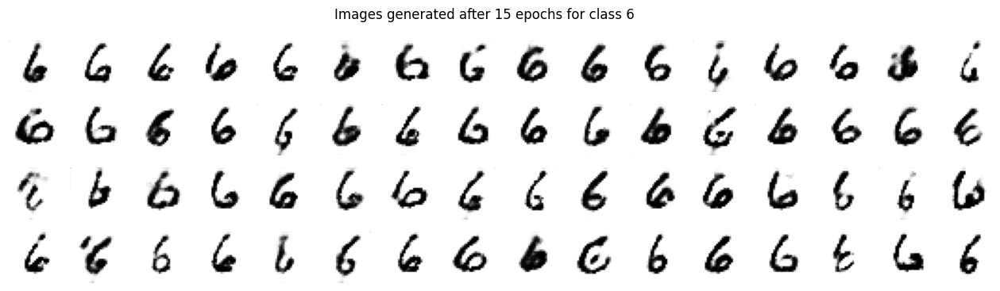

53/53 [==============================] - 11s 199ms/step - discriminator_loss: 0.5630 - generator_loss: 1.0788
Epoch 16/50
53/53 [==============================] - 10s 187ms/step - discriminator_loss: 0.5868 - generator_loss: 1.0548
Epoch 17/50
53/53 [==============================] - 10s 182ms/step - discriminator_loss: 0.6019 - generator_loss: 1.1387
Epoch 18/50
53/53 [==============================] - ETA: 0s - discriminator_loss: 0.5914 - generator_loss: 1.0462

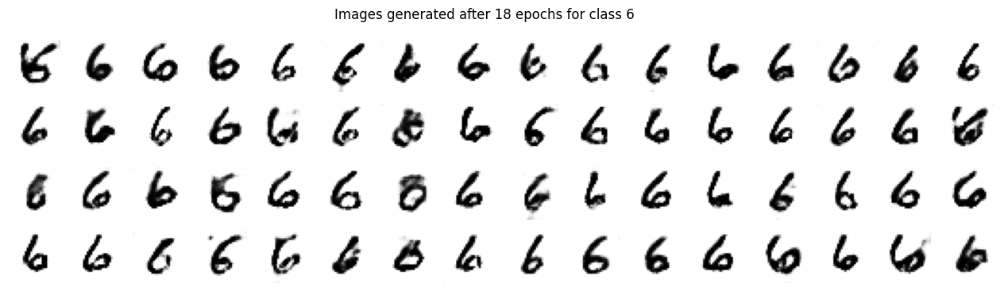

53/53 [==============================] - 11s 199ms/step - discriminator_loss: 0.5914 - generator_loss: 1.0462
Epoch 19/50
53/53 [==============================] - 10s 187ms/step - discriminator_loss: 0.5926 - generator_loss: 1.0428
Epoch 20/50
53/53 [==============================] - 10s 186ms/step - discriminator_loss: 0.6125 - generator_loss: 1.0312
Epoch 21/50
53/53 [==============================] - ETA: 0s - discriminator_loss: 0.6097 - generator_loss: 1.0036

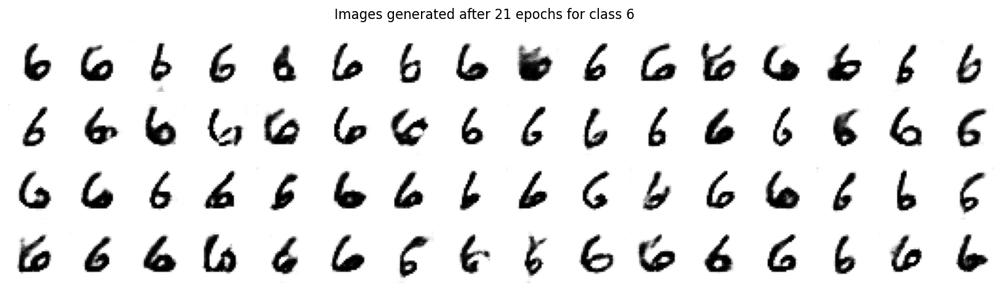

53/53 [==============================] - 11s 200ms/step - discriminator_loss: 0.6097 - generator_loss: 1.0036
Epoch 22/50
53/53 [==============================] - 10s 182ms/step - discriminator_loss: 0.6042 - generator_loss: 0.9902
Epoch 23/50
53/53 [==============================] - 10s 186ms/step - discriminator_loss: 0.6221 - generator_loss: 0.9915
Epoch 24/50
53/53 [==============================] - ETA: 0s - discriminator_loss: 0.6239 - generator_loss: 0.9927

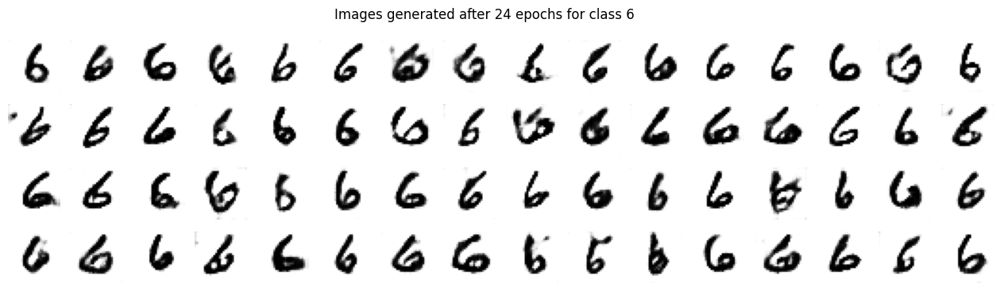

53/53 [==============================] - 11s 203ms/step - discriminator_loss: 0.6239 - generator_loss: 0.9927
Epoch 25/50
53/53 [==============================] - 10s 186ms/step - discriminator_loss: 0.6142 - generator_loss: 0.9960
Epoch 26/50
53/53 [==============================] - 10s 186ms/step - discriminator_loss: 0.6215 - generator_loss: 0.9868
Epoch 27/50
53/53 [==============================] - ETA: 0s - discriminator_loss: 0.6219 - generator_loss: 0.9658

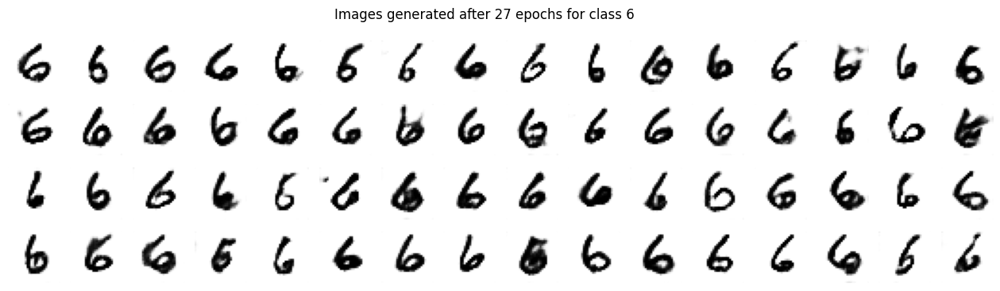

53/53 [==============================] - 11s 207ms/step - discriminator_loss: 0.6219 - generator_loss: 0.9658
Epoch 28/50
53/53 [==============================] - 10s 187ms/step - discriminator_loss: 0.6299 - generator_loss: 0.9516
Epoch 29/50
53/53 [==============================] - 10s 187ms/step - discriminator_loss: 0.6355 - generator_loss: 0.9546
Epoch 30/50
53/53 [==============================] - ETA: 0s - discriminator_loss: 0.6281 - generator_loss: 0.9572

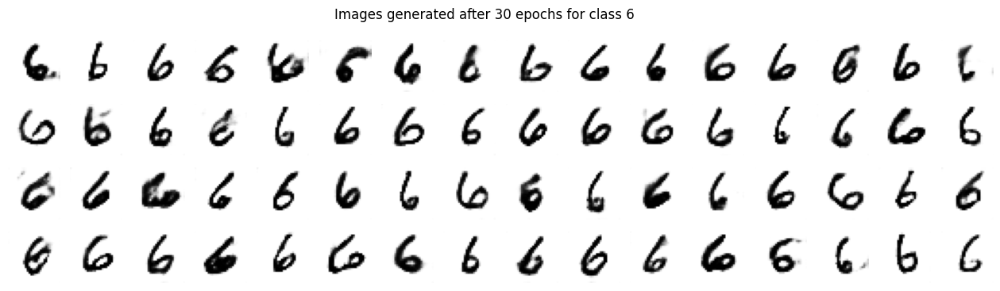

53/53 [==============================] - 11s 204ms/step - discriminator_loss: 0.6281 - generator_loss: 0.9572
Epoch 31/50
53/53 [==============================] - 10s 185ms/step - discriminator_loss: 0.6302 - generator_loss: 0.9431
Epoch 32/50
53/53 [==============================] - 10s 186ms/step - discriminator_loss: 0.6319 - generator_loss: 0.9508
Epoch 33/50
53/53 [==============================] - ETA: 0s - discriminator_loss: 0.6298 - generator_loss: 0.9263

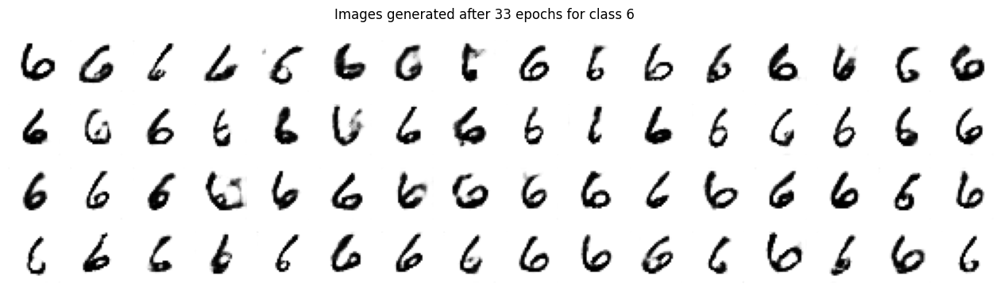

53/53 [==============================] - 11s 202ms/step - discriminator_loss: 0.6298 - generator_loss: 0.9263
Epoch 34/50
53/53 [==============================] - 10s 184ms/step - discriminator_loss: 0.6367 - generator_loss: 0.9500
Epoch 35/50
53/53 [==============================] - 10s 180ms/step - discriminator_loss: 0.6313 - generator_loss: 0.9125
Epoch 36/50
53/53 [==============================] - ETA: 0s - discriminator_loss: 0.6257 - generator_loss: 0.9251

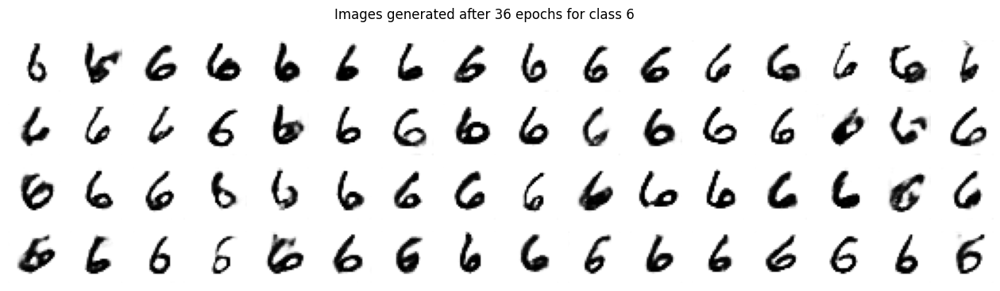

53/53 [==============================] - 10s 196ms/step - discriminator_loss: 0.6257 - generator_loss: 0.9251
Epoch 37/50
53/53 [==============================] - 10s 181ms/step - discriminator_loss: 0.6324 - generator_loss: 0.9459
Epoch 38/50
53/53 [==============================] - 10s 179ms/step - discriminator_loss: 0.6294 - generator_loss: 0.9441
Epoch 39/50
53/53 [==============================] - ETA: 0s - discriminator_loss: 0.6333 - generator_loss: 0.9421

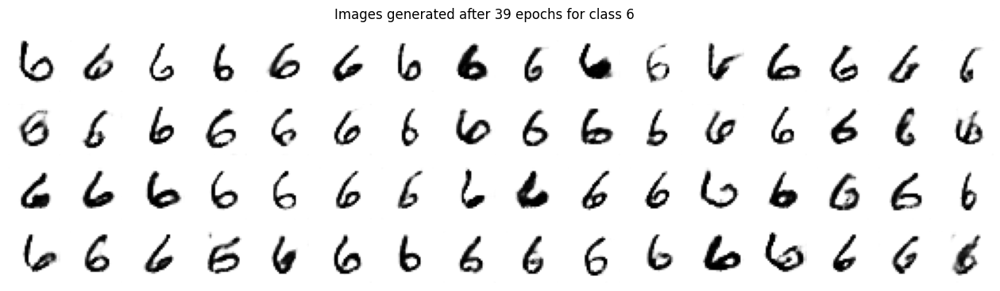

53/53 [==============================] - 11s 200ms/step - discriminator_loss: 0.6333 - generator_loss: 0.9421
Epoch 40/50
53/53 [==============================] - 10s 182ms/step - discriminator_loss: 0.6336 - generator_loss: 0.9386
Epoch 41/50
53/53 [==============================] - 10s 185ms/step - discriminator_loss: 0.6423 - generator_loss: 0.9828
Epoch 42/50
53/53 [==============================] - ETA: 0s - discriminator_loss: 0.6312 - generator_loss: 0.9580

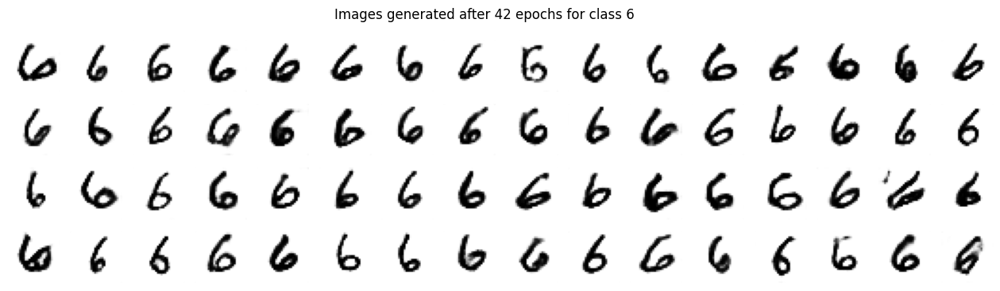

53/53 [==============================] - 11s 200ms/step - discriminator_loss: 0.6312 - generator_loss: 0.9580
Epoch 43/50
53/53 [==============================] - 10s 183ms/step - discriminator_loss: 0.6364 - generator_loss: 0.9263
Epoch 44/50
53/53 [==============================] - 10s 186ms/step - discriminator_loss: 0.6320 - generator_loss: 0.9128
Epoch 45/50
53/53 [==============================] - ETA: 0s - discriminator_loss: 0.6334 - generator_loss: 0.9299

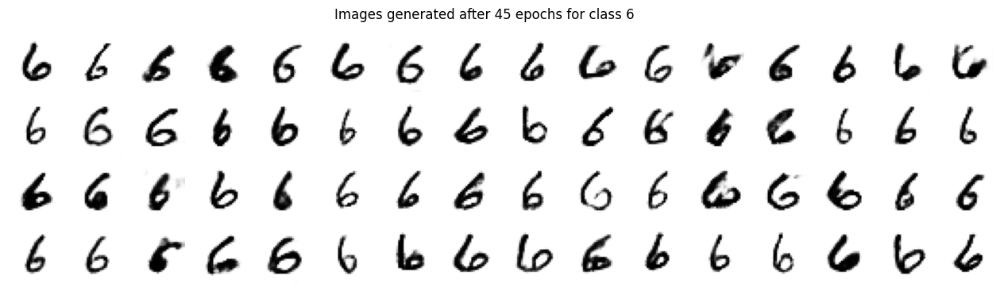

53/53 [==============================] - 11s 202ms/step - discriminator_loss: 0.6334 - generator_loss: 0.9299
Epoch 46/50
53/53 [==============================] - 10s 187ms/step - discriminator_loss: 0.6380 - generator_loss: 0.9335
Epoch 47/50
53/53 [==============================] - 10s 186ms/step - discriminator_loss: 0.6330 - generator_loss: 0.9525
Epoch 48/50
53/53 [==============================] - ETA: 0s - discriminator_loss: 0.6368 - generator_loss: 0.9349

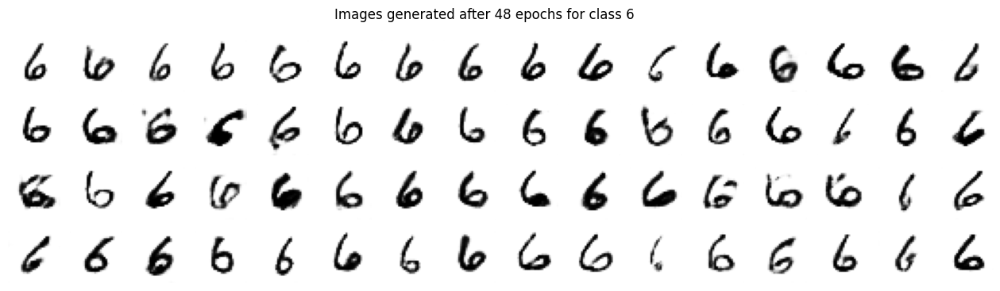

53/53 [==============================] - 11s 201ms/step - discriminator_loss: 0.6368 - generator_loss: 0.9349
Epoch 49/50
53/53 [==============================] - 10s 184ms/step - discriminator_loss: 0.6405 - generator_loss: 0.9390
Epoch 50/50
53/53 [==============================] - 10s 186ms/step - discriminator_loss: 0.6407 - generator_loss: 0.9400
Epoch 1/50
56/56 [==============================] - 11s 186ms/step - discriminator_loss: 0.3548 - generator_loss: 1.0765
Epoch 2/50
56/56 [==============================] - 10s 187ms/step - discriminator_loss: 0.4352 - generator_loss: 1.8346
Epoch 3/50
56/56 [==============================] - ETA: 0s - discriminator_loss: 0.5197 - generator_loss: 1.4679

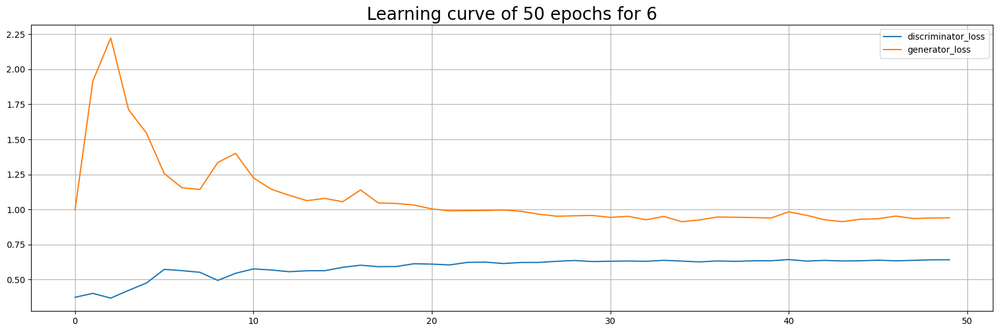

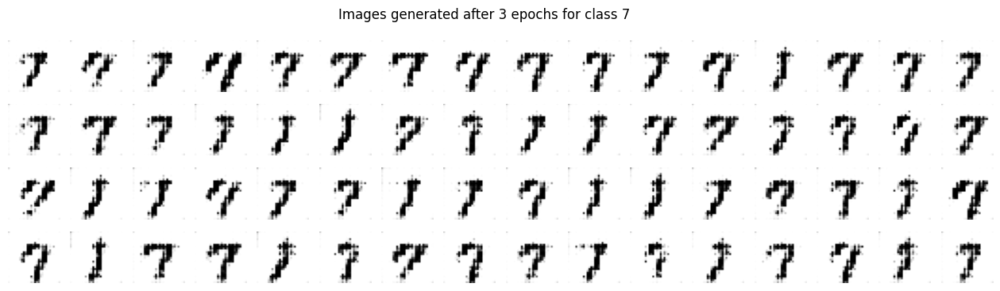

56/56 [==============================] - 11s 205ms/step - discriminator_loss: 0.5197 - generator_loss: 1.4679
Epoch 4/50
56/56 [==============================] - 11s 188ms/step - discriminator_loss: 0.6081 - generator_loss: 1.2128
Epoch 5/50
56/56 [==============================] - 11s 190ms/step - discriminator_loss: 0.5612 - generator_loss: 1.1652
Epoch 6/50
56/56 [==============================] - ETA: 0s - discriminator_loss: 0.6400 - generator_loss: 1.0037

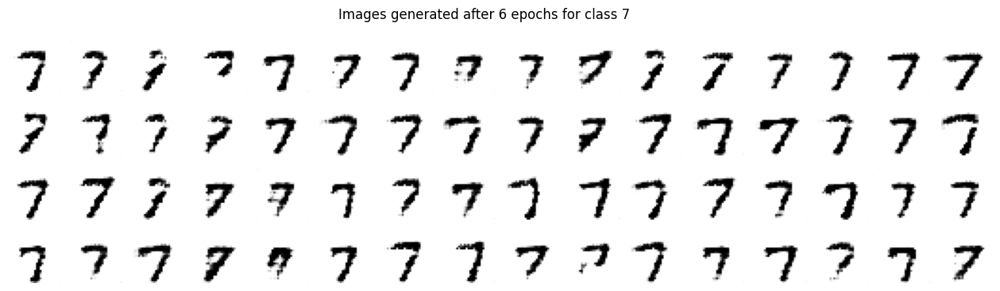

56/56 [==============================] - 11s 200ms/step - discriminator_loss: 0.6400 - generator_loss: 1.0037
Epoch 7/50
56/56 [==============================] - 10s 186ms/step - discriminator_loss: 0.5762 - generator_loss: 1.0315
Epoch 8/50
56/56 [==============================] - 10s 187ms/step - discriminator_loss: 0.6226 - generator_loss: 1.0385
Epoch 9/50
56/56 [==============================] - ETA: 0s - discriminator_loss: 0.6036 - generator_loss: 1.0572

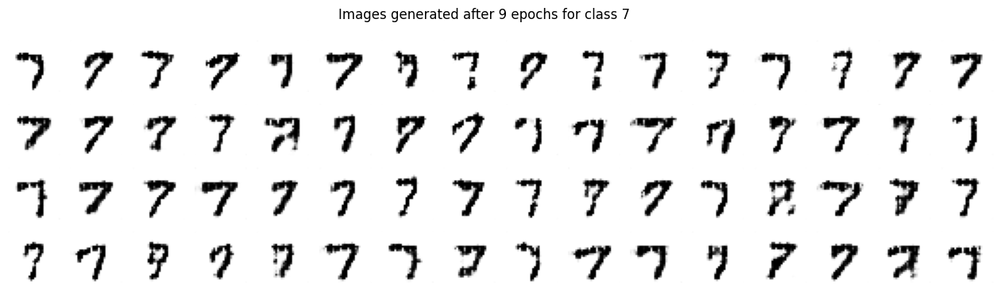

56/56 [==============================] - 11s 200ms/step - discriminator_loss: 0.6036 - generator_loss: 1.0572
Epoch 10/50
56/56 [==============================] - 10s 182ms/step - discriminator_loss: 0.6410 - generator_loss: 0.9456
Epoch 11/50
56/56 [==============================] - 10s 181ms/step - discriminator_loss: 0.6485 - generator_loss: 0.9245
Epoch 12/50
56/56 [==============================] - ETA: 0s - discriminator_loss: 0.6271 - generator_loss: 0.8985

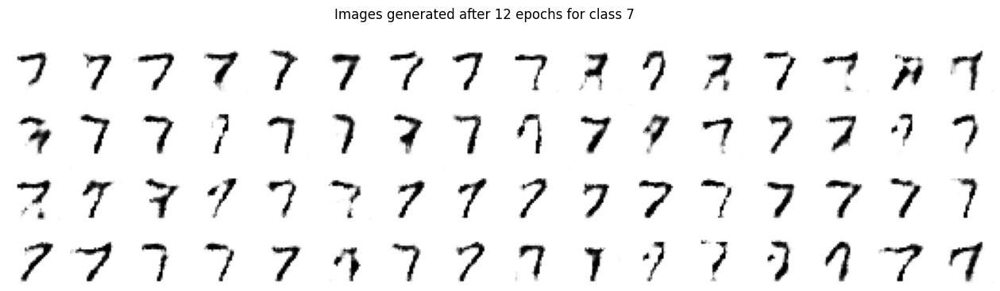

56/56 [==============================] - 11s 199ms/step - discriminator_loss: 0.6271 - generator_loss: 0.8985
Epoch 13/50
56/56 [==============================] - 10s 184ms/step - discriminator_loss: 0.6421 - generator_loss: 0.9168
Epoch 14/50
56/56 [==============================] - 10s 182ms/step - discriminator_loss: 0.6503 - generator_loss: 0.9404
Epoch 15/50
56/56 [==============================] - ETA: 0s - discriminator_loss: 0.6499 - generator_loss: 0.9123

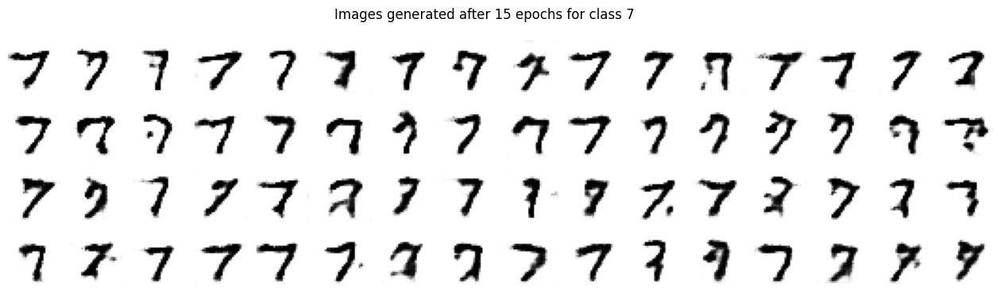

56/56 [==============================] - 11s 201ms/step - discriminator_loss: 0.6499 - generator_loss: 0.9123
Epoch 16/50
56/56 [==============================] - 11s 189ms/step - discriminator_loss: 0.6450 - generator_loss: 0.9095
Epoch 17/50
56/56 [==============================] - 10s 185ms/step - discriminator_loss: 0.6515 - generator_loss: 0.8789
Epoch 18/50
56/56 [==============================] - ETA: 0s - discriminator_loss: 0.6595 - generator_loss: 0.8788

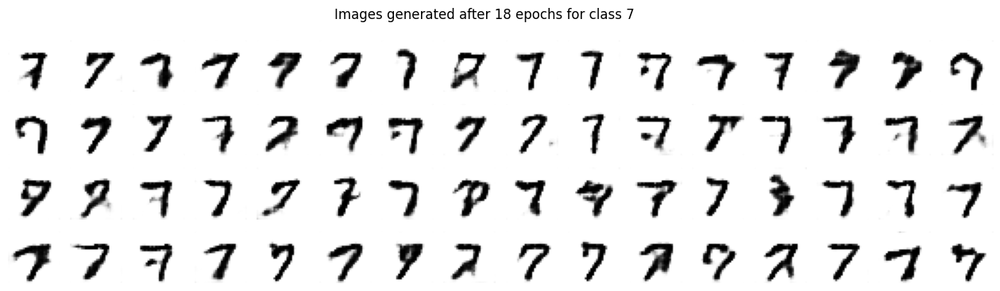

56/56 [==============================] - 11s 202ms/step - discriminator_loss: 0.6595 - generator_loss: 0.8788
Epoch 19/50
56/56 [==============================] - 11s 191ms/step - discriminator_loss: 0.6498 - generator_loss: 0.8729
Epoch 20/50
56/56 [==============================] - 11s 191ms/step - discriminator_loss: 0.6501 - generator_loss: 0.8599
Epoch 21/50
56/56 [==============================] - ETA: 0s - discriminator_loss: 0.6508 - generator_loss: 0.8670

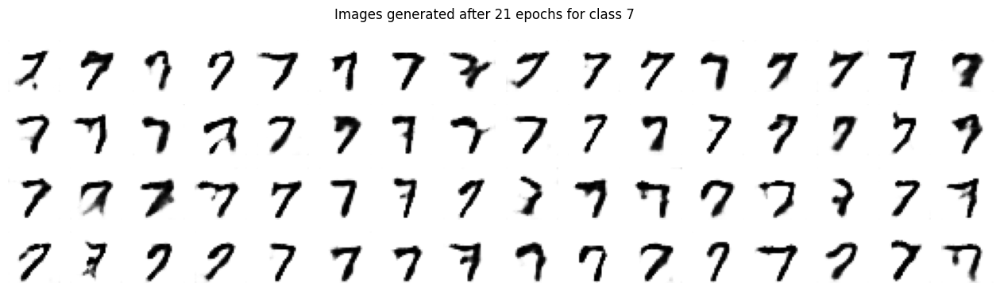

56/56 [==============================] - 11s 202ms/step - discriminator_loss: 0.6508 - generator_loss: 0.8670
Epoch 22/50
56/56 [==============================] - 11s 189ms/step - discriminator_loss: 0.6555 - generator_loss: 0.8716
Epoch 23/50
56/56 [==============================] - 11s 189ms/step - discriminator_loss: 0.6520 - generator_loss: 0.8566
Epoch 24/50
56/56 [==============================] - ETA: 0s - discriminator_loss: 0.6475 - generator_loss: 0.8759

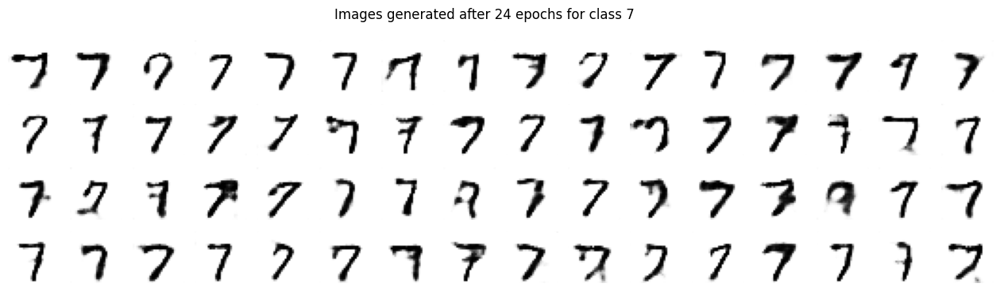

56/56 [==============================] - 11s 204ms/step - discriminator_loss: 0.6475 - generator_loss: 0.8759
Epoch 25/50
56/56 [==============================] - 11s 190ms/step - discriminator_loss: 0.6565 - generator_loss: 0.8813
Epoch 26/50
56/56 [==============================] - 11s 189ms/step - discriminator_loss: 0.6454 - generator_loss: 0.8713
Epoch 27/50
56/56 [==============================] - ETA: 0s - discriminator_loss: 0.6389 - generator_loss: 0.8742

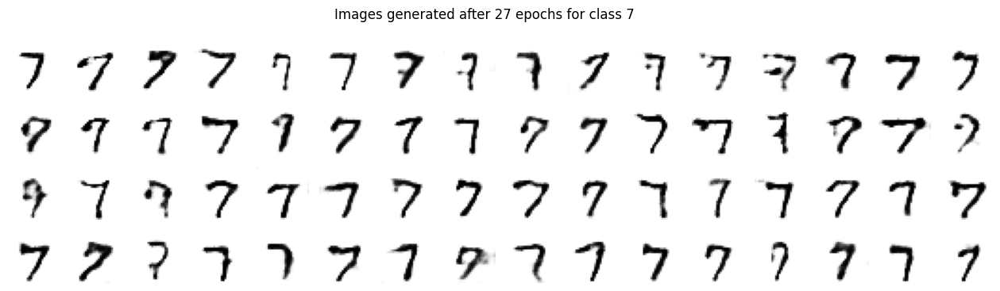

56/56 [==============================] - 11s 204ms/step - discriminator_loss: 0.6389 - generator_loss: 0.8742
Epoch 28/50
56/56 [==============================] - 11s 190ms/step - discriminator_loss: 0.6536 - generator_loss: 0.9069
Epoch 29/50
56/56 [==============================] - 10s 186ms/step - discriminator_loss: 0.6469 - generator_loss: 0.9149
Epoch 30/50
56/56 [==============================] - ETA: 0s - discriminator_loss: 0.6505 - generator_loss: 0.9011

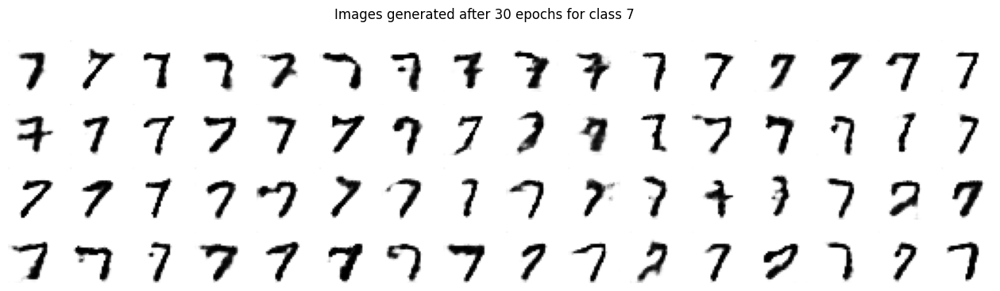

56/56 [==============================] - 11s 204ms/step - discriminator_loss: 0.6505 - generator_loss: 0.9011
Epoch 31/50
56/56 [==============================] - 11s 192ms/step - discriminator_loss: 0.6386 - generator_loss: 0.8951
Epoch 32/50
56/56 [==============================] - 10s 187ms/step - discriminator_loss: 0.6473 - generator_loss: 0.8923
Epoch 33/50
56/56 [==============================] - ETA: 0s - discriminator_loss: 0.6423 - generator_loss: 0.8918

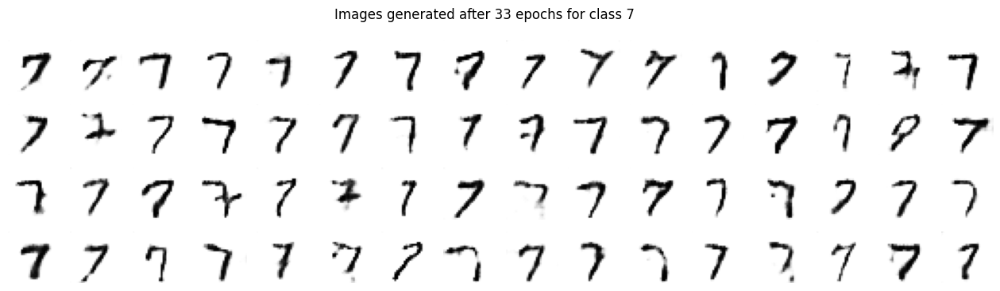

56/56 [==============================] - 12s 206ms/step - discriminator_loss: 0.6423 - generator_loss: 0.8918
Epoch 34/50
56/56 [==============================] - 10s 187ms/step - discriminator_loss: 0.6437 - generator_loss: 0.9090
Epoch 35/50
56/56 [==============================] - 11s 188ms/step - discriminator_loss: 0.6498 - generator_loss: 0.9283
Epoch 36/50
56/56 [==============================] - ETA: 0s - discriminator_loss: 0.6437 - generator_loss: 0.9160

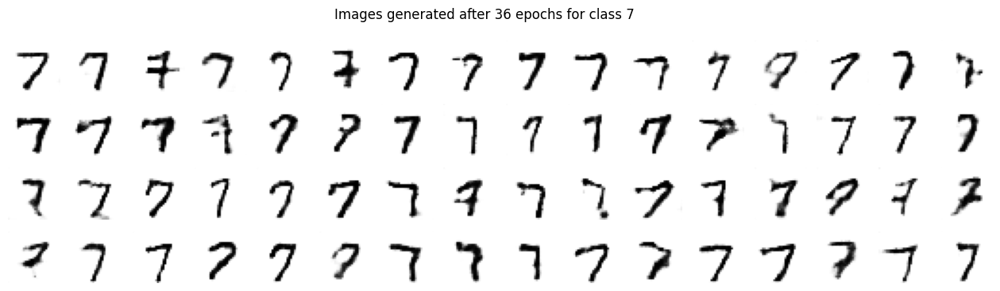

56/56 [==============================] - 12s 213ms/step - discriminator_loss: 0.6437 - generator_loss: 0.9160
Epoch 37/50
56/56 [==============================] - 11s 188ms/step - discriminator_loss: 0.6456 - generator_loss: 0.9250
Epoch 38/50
56/56 [==============================] - 10s 185ms/step - discriminator_loss: 0.6447 - generator_loss: 0.9044
Epoch 39/50
56/56 [==============================] - ETA: 0s - discriminator_loss: 0.6471 - generator_loss: 0.8869

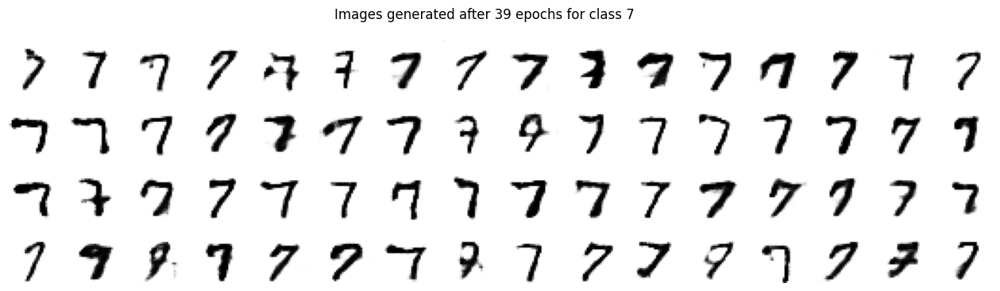

56/56 [==============================] - 11s 204ms/step - discriminator_loss: 0.6471 - generator_loss: 0.8869
Epoch 40/50
56/56 [==============================] - 11s 192ms/step - discriminator_loss: 0.6457 - generator_loss: 0.8967
Epoch 41/50
56/56 [==============================] - 11s 198ms/step - discriminator_loss: 0.6490 - generator_loss: 0.9153
Epoch 42/50
56/56 [==============================] - ETA: 0s - discriminator_loss: 0.6485 - generator_loss: 0.9239

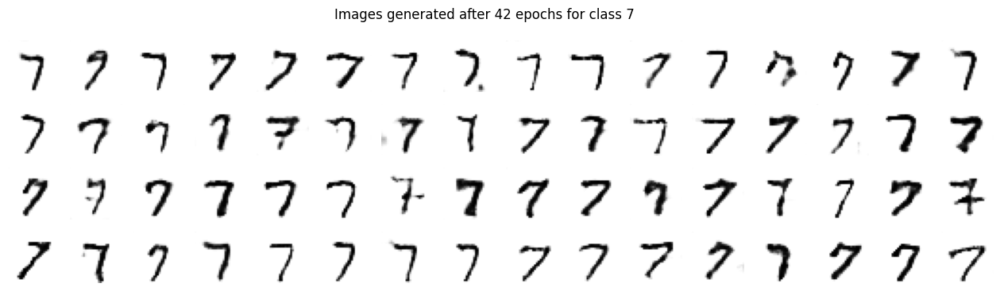

56/56 [==============================] - 11s 204ms/step - discriminator_loss: 0.6485 - generator_loss: 0.9239
Epoch 43/50
56/56 [==============================] - 11s 192ms/step - discriminator_loss: 0.6440 - generator_loss: 0.9189
Epoch 44/50
56/56 [==============================] - 11s 193ms/step - discriminator_loss: 0.6479 - generator_loss: 0.8980
Epoch 45/50
56/56 [==============================] - ETA: 0s - discriminator_loss: 0.6485 - generator_loss: 0.9101

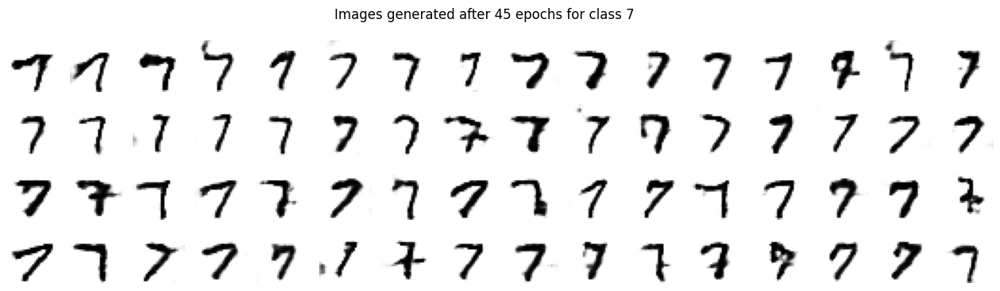

56/56 [==============================] - 11s 203ms/step - discriminator_loss: 0.6485 - generator_loss: 0.9101
Epoch 46/50
56/56 [==============================] - 10s 184ms/step - discriminator_loss: 0.6466 - generator_loss: 0.9101
Epoch 47/50
56/56 [==============================] - 10s 185ms/step - discriminator_loss: 0.6519 - generator_loss: 0.9152
Epoch 48/50
56/56 [==============================] - ETA: 0s - discriminator_loss: 0.6474 - generator_loss: 0.9087

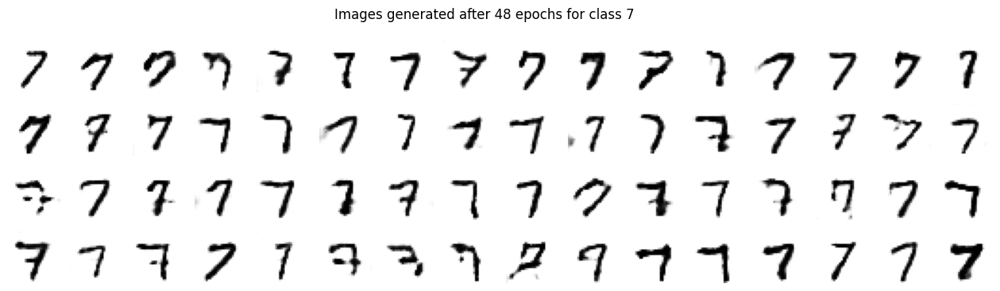

56/56 [==============================] - 11s 204ms/step - discriminator_loss: 0.6474 - generator_loss: 0.9087
Epoch 49/50
56/56 [==============================] - 10s 185ms/step - discriminator_loss: 0.6485 - generator_loss: 0.8995
Epoch 50/50
56/56 [==============================] - 10s 183ms/step - discriminator_loss: 0.6462 - generator_loss: 0.8877
Epoch 1/50
53/53 [==============================] - 10s 182ms/step - discriminator_loss: 0.3799 - generator_loss: 0.9197
Epoch 2/50
53/53 [==============================] - 10s 183ms/step - discriminator_loss: 0.2612 - generator_loss: 2.8661
Epoch 3/50
53/53 [==============================] - ETA: 0s - discriminator_loss: 0.2870 - generator_loss: 2.5031

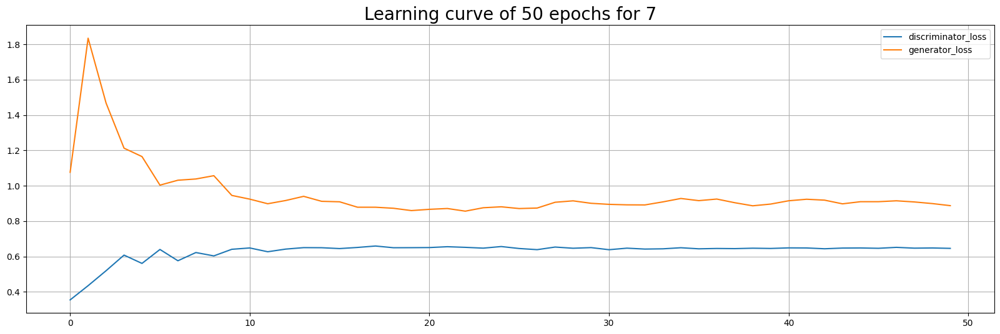

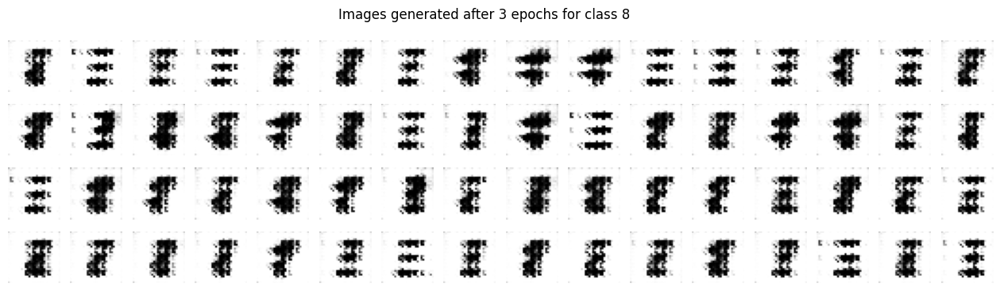

53/53 [==============================] - 11s 202ms/step - discriminator_loss: 0.2870 - generator_loss: 2.5031
Epoch 4/50
53/53 [==============================] - 10s 183ms/step - discriminator_loss: 0.3866 - generator_loss: 2.6777
Epoch 5/50
53/53 [==============================] - 10s 183ms/step - discriminator_loss: 0.3322 - generator_loss: 2.5254
Epoch 6/50
53/53 [==============================] - ETA: 0s - discriminator_loss: 0.2968 - generator_loss: 2.2273

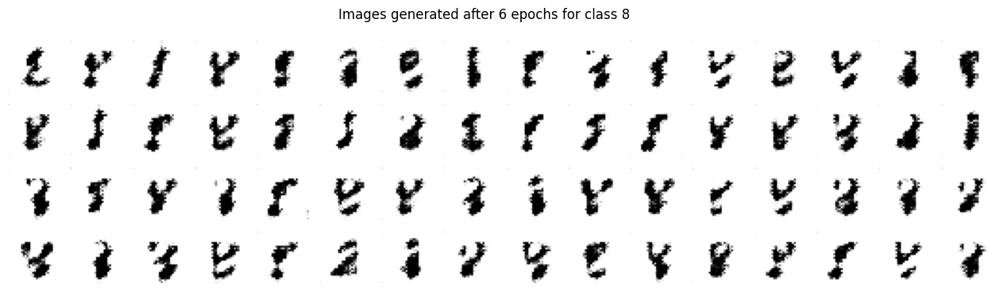

53/53 [==============================] - 11s 201ms/step - discriminator_loss: 0.2968 - generator_loss: 2.2273
Epoch 7/50
53/53 [==============================] - 10s 183ms/step - discriminator_loss: 0.3296 - generator_loss: 2.1935
Epoch 8/50
53/53 [==============================] - 10s 183ms/step - discriminator_loss: 0.3062 - generator_loss: 2.3986
Epoch 9/50
53/53 [==============================] - ETA: 0s - discriminator_loss: 0.3669 - generator_loss: 2.4500

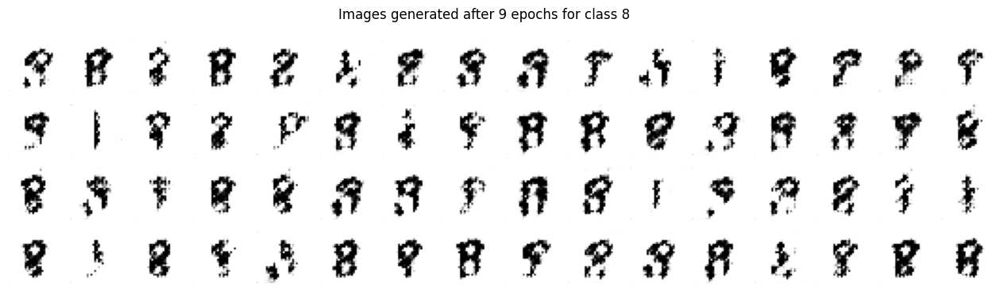

53/53 [==============================] - 11s 201ms/step - discriminator_loss: 0.3669 - generator_loss: 2.4500
Epoch 10/50
53/53 [==============================] - 10s 183ms/step - discriminator_loss: 0.3478 - generator_loss: 2.1827
Epoch 11/50
53/53 [==============================] - 10s 183ms/step - discriminator_loss: 0.3380 - generator_loss: 2.1797
Epoch 12/50
53/53 [==============================] - ETA: 0s - discriminator_loss: 0.4148 - generator_loss: 1.8430

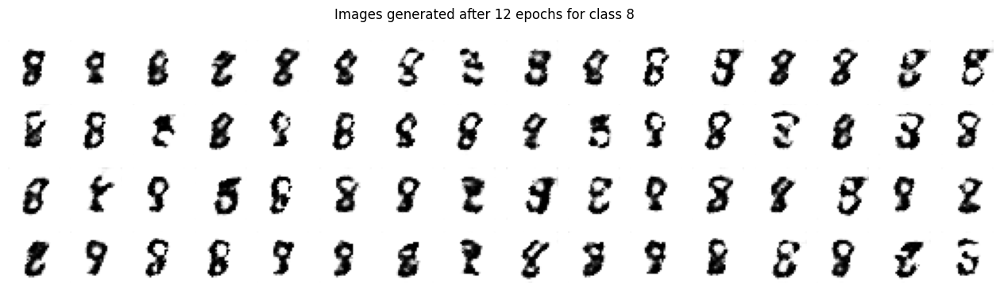

53/53 [==============================] - 11s 199ms/step - discriminator_loss: 0.4148 - generator_loss: 1.8430
Epoch 13/50
53/53 [==============================] - 10s 183ms/step - discriminator_loss: 0.4506 - generator_loss: 1.6428
Epoch 14/50
53/53 [==============================] - 10s 184ms/step - discriminator_loss: 0.4147 - generator_loss: 1.6175
Epoch 15/50
53/53 [==============================] - ETA: 0s - discriminator_loss: 0.4473 - generator_loss: 1.6106

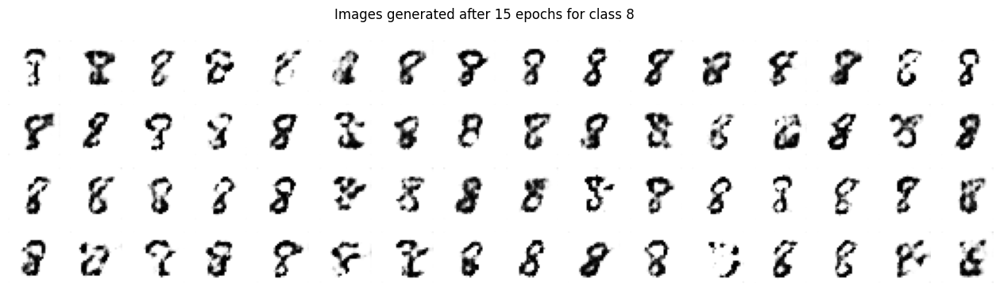

53/53 [==============================] - 11s 199ms/step - discriminator_loss: 0.4473 - generator_loss: 1.6106
Epoch 16/50
53/53 [==============================] - 10s 183ms/step - discriminator_loss: 0.4636 - generator_loss: 1.5058
Epoch 17/50
53/53 [==============================] - 10s 183ms/step - discriminator_loss: 0.4913 - generator_loss: 1.3298
Epoch 18/50
53/53 [==============================] - ETA: 0s - discriminator_loss: 0.5111 - generator_loss: 1.2660

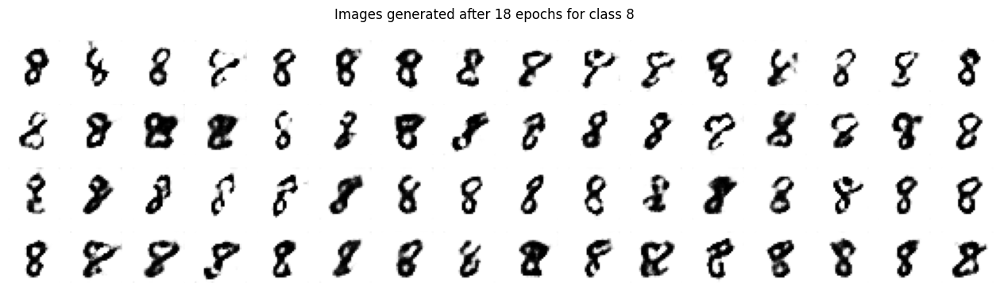

53/53 [==============================] - 11s 201ms/step - discriminator_loss: 0.5111 - generator_loss: 1.2660
Epoch 19/50
53/53 [==============================] - 10s 183ms/step - discriminator_loss: 0.5470 - generator_loss: 1.2001
Epoch 20/50
53/53 [==============================] - 10s 183ms/step - discriminator_loss: 0.5430 - generator_loss: 1.1750
Epoch 21/50
53/53 [==============================] - ETA: 0s - discriminator_loss: 0.5160 - generator_loss: 1.2061

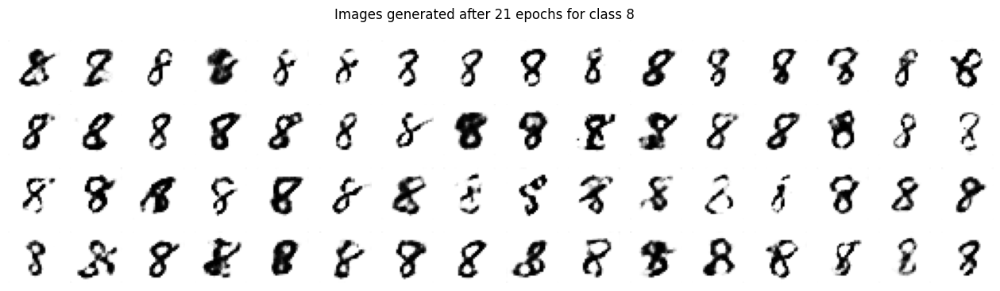

53/53 [==============================] - 11s 199ms/step - discriminator_loss: 0.5160 - generator_loss: 1.2061
Epoch 22/50
53/53 [==============================] - 10s 183ms/step - discriminator_loss: 0.5413 - generator_loss: 1.1677
Epoch 23/50
53/53 [==============================] - 10s 183ms/step - discriminator_loss: 0.5641 - generator_loss: 1.2384
Epoch 24/50
53/53 [==============================] - ETA: 0s - discriminator_loss: 0.5872 - generator_loss: 1.3686

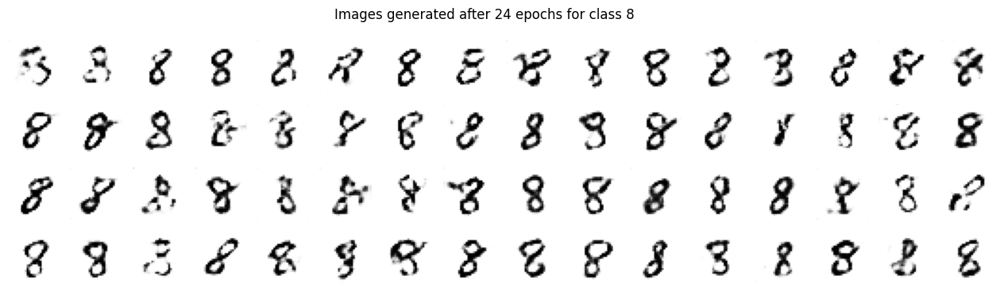

53/53 [==============================] - 11s 199ms/step - discriminator_loss: 0.5872 - generator_loss: 1.3686
Epoch 25/50
53/53 [==============================] - 10s 183ms/step - discriminator_loss: 0.5455 - generator_loss: 1.2031
Epoch 26/50
53/53 [==============================] - 10s 183ms/step - discriminator_loss: 0.5565 - generator_loss: 1.1514
Epoch 27/50
53/53 [==============================] - ETA: 0s - discriminator_loss: 0.5698 - generator_loss: 1.1406

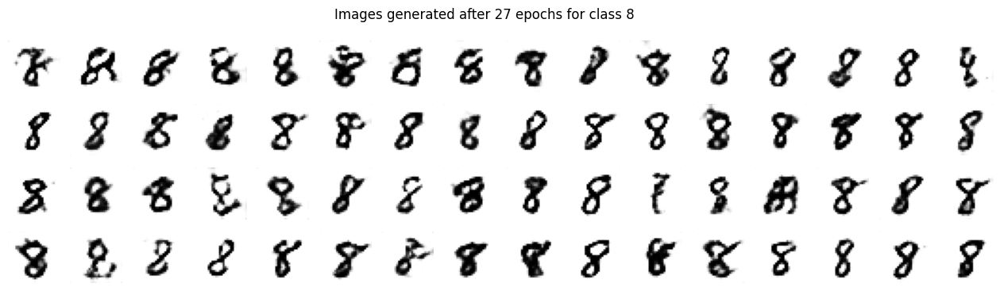

53/53 [==============================] - 11s 200ms/step - discriminator_loss: 0.5698 - generator_loss: 1.1406
Epoch 28/50
53/53 [==============================] - 10s 183ms/step - discriminator_loss: 0.5629 - generator_loss: 1.1116
Epoch 29/50
53/53 [==============================] - 10s 183ms/step - discriminator_loss: 0.5761 - generator_loss: 1.0761
Epoch 30/50
53/53 [==============================] - ETA: 0s - discriminator_loss: 0.5904 - generator_loss: 1.0781

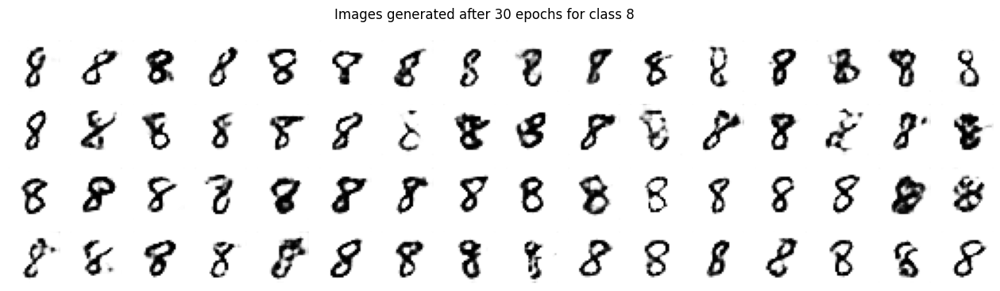

53/53 [==============================] - 11s 200ms/step - discriminator_loss: 0.5904 - generator_loss: 1.0781
Epoch 31/50
53/53 [==============================] - 10s 183ms/step - discriminator_loss: 0.5832 - generator_loss: 1.0433
Epoch 32/50
53/53 [==============================] - 10s 183ms/step - discriminator_loss: 0.5807 - generator_loss: 1.0430
Epoch 33/50
53/53 [==============================] - ETA: 0s - discriminator_loss: 0.5915 - generator_loss: 1.0325

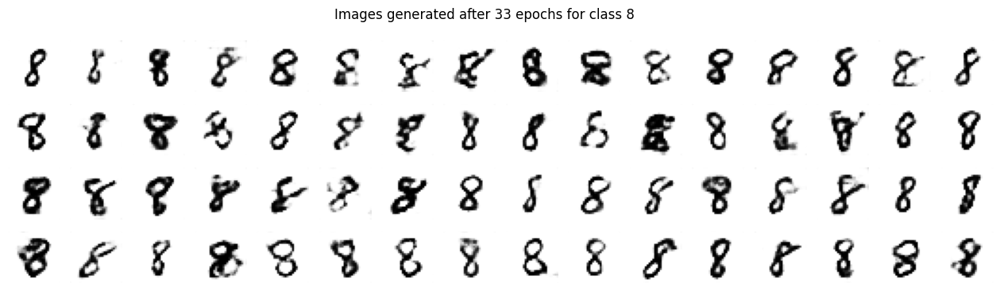

53/53 [==============================] - 11s 201ms/step - discriminator_loss: 0.5915 - generator_loss: 1.0325
Epoch 34/50
53/53 [==============================] - 10s 182ms/step - discriminator_loss: 0.5963 - generator_loss: 1.0469
Epoch 35/50
53/53 [==============================] - 10s 183ms/step - discriminator_loss: 0.5965 - generator_loss: 1.0746
Epoch 36/50
53/53 [==============================] - ETA: 0s - discriminator_loss: 0.5960 - generator_loss: 1.0069

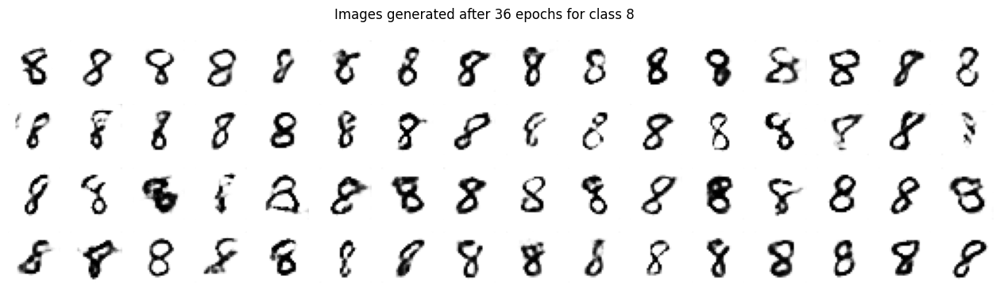

53/53 [==============================] - 11s 199ms/step - discriminator_loss: 0.5960 - generator_loss: 1.0069
Epoch 37/50
53/53 [==============================] - 10s 183ms/step - discriminator_loss: 0.6088 - generator_loss: 1.0197
Epoch 38/50
53/53 [==============================] - 10s 183ms/step - discriminator_loss: 0.6005 - generator_loss: 0.9988
Epoch 39/50
53/53 [==============================] - ETA: 0s - discriminator_loss: 0.5986 - generator_loss: 1.0108

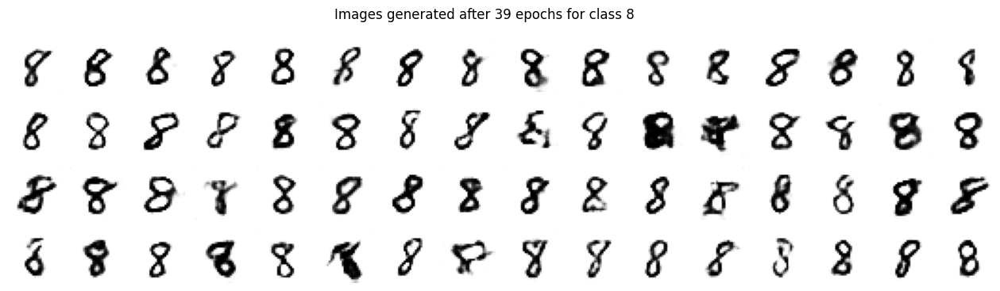

53/53 [==============================] - 11s 200ms/step - discriminator_loss: 0.5986 - generator_loss: 1.0108
Epoch 40/50
53/53 [==============================] - 10s 183ms/step - discriminator_loss: 0.6131 - generator_loss: 1.0175
Epoch 41/50
53/53 [==============================] - 10s 183ms/step - discriminator_loss: 0.6114 - generator_loss: 1.0243
Epoch 42/50
53/53 [==============================] - ETA: 0s - discriminator_loss: 0.6101 - generator_loss: 1.0489

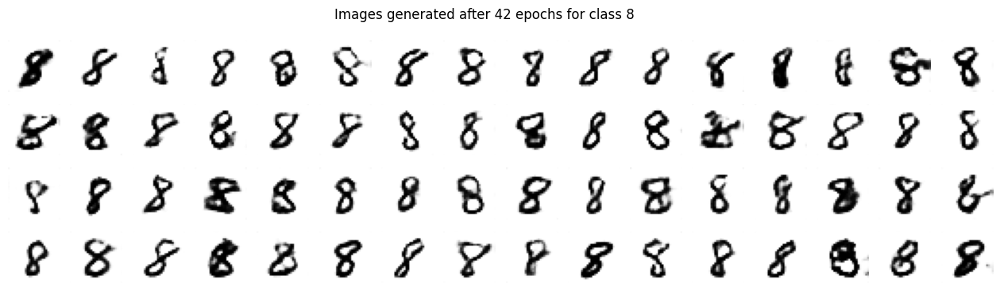

53/53 [==============================] - 11s 204ms/step - discriminator_loss: 0.6101 - generator_loss: 1.0489
Epoch 43/50
53/53 [==============================] - 10s 185ms/step - discriminator_loss: 0.6075 - generator_loss: 1.0468
Epoch 44/50
53/53 [==============================] - 10s 185ms/step - discriminator_loss: 0.6123 - generator_loss: 1.0336
Epoch 45/50
53/53 [==============================] - ETA: 0s - discriminator_loss: 0.5951 - generator_loss: 1.0303

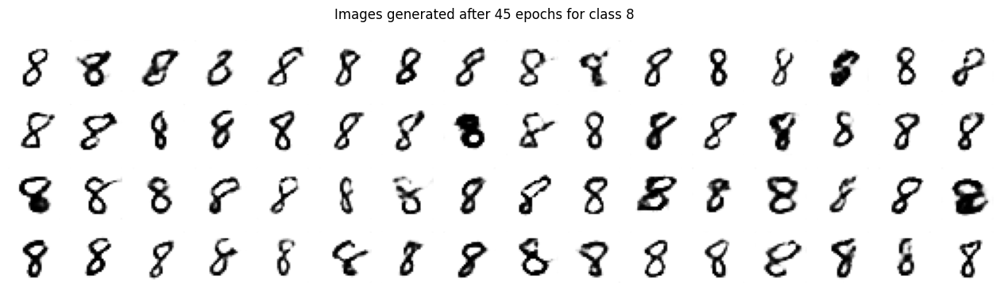

53/53 [==============================] - 11s 201ms/step - discriminator_loss: 0.5951 - generator_loss: 1.0303
Epoch 46/50
53/53 [==============================] - 10s 185ms/step - discriminator_loss: 0.6076 - generator_loss: 1.0528
Epoch 47/50
53/53 [==============================] - 10s 185ms/step - discriminator_loss: 0.6013 - generator_loss: 1.0492
Epoch 48/50
53/53 [==============================] - ETA: 0s - discriminator_loss: 0.6020 - generator_loss: 1.0375

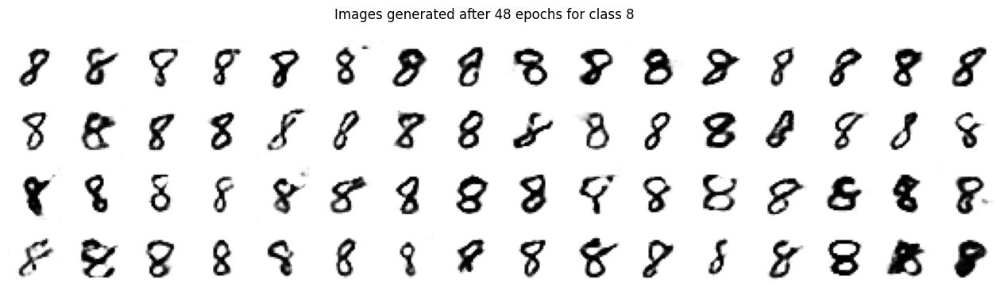

53/53 [==============================] - 11s 203ms/step - discriminator_loss: 0.6020 - generator_loss: 1.0375
Epoch 49/50
53/53 [==============================] - 10s 183ms/step - discriminator_loss: 0.6056 - generator_loss: 1.0770
Epoch 50/50
53/53 [==============================] - 10s 183ms/step - discriminator_loss: 0.5999 - generator_loss: 1.0362
Epoch 1/50
54/54 [==============================] - 10s 182ms/step - discriminator_loss: 0.3686 - generator_loss: 1.0705
Epoch 2/50
54/54 [==============================] - 10s 183ms/step - discriminator_loss: 0.3437 - generator_loss: 2.0838
Epoch 3/50
54/54 [==============================] - ETA: 0s - discriminator_loss: 0.4546 - generator_loss: 2.0645

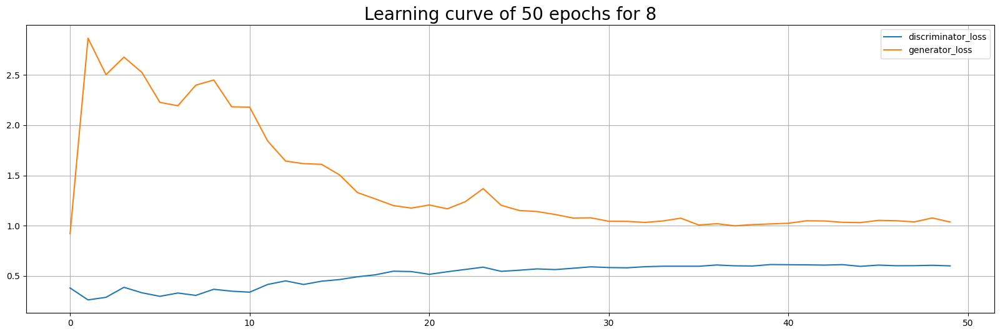

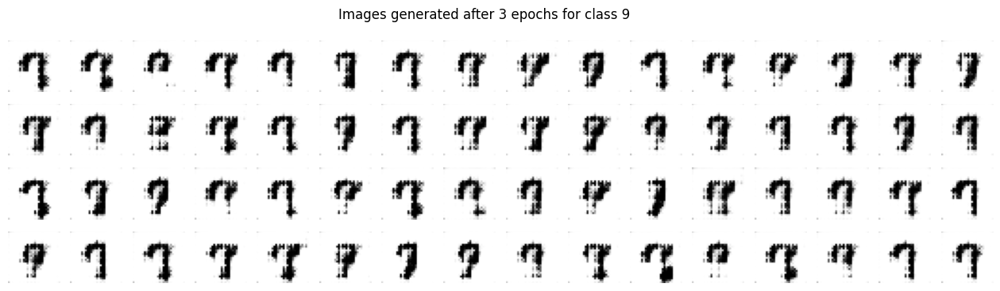

54/54 [==============================] - 11s 204ms/step - discriminator_loss: 0.4546 - generator_loss: 2.0645
Epoch 4/50
54/54 [==============================] - 10s 185ms/step - discriminator_loss: 0.4715 - generator_loss: 1.5361
Epoch 5/50
54/54 [==============================] - 10s 184ms/step - discriminator_loss: 0.4406 - generator_loss: 1.7909
Epoch 6/50
54/54 [==============================] - ETA: 0s - discriminator_loss: 0.4639 - generator_loss: 1.4607

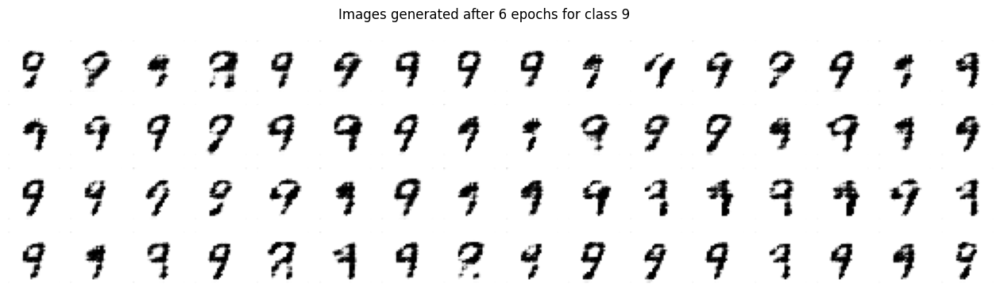

54/54 [==============================] - 11s 204ms/step - discriminator_loss: 0.4639 - generator_loss: 1.4607
Epoch 7/50
54/54 [==============================] - 10s 188ms/step - discriminator_loss: 0.5489 - generator_loss: 1.2791
Epoch 8/50
54/54 [==============================] - 10s 188ms/step - discriminator_loss: 0.5519 - generator_loss: 1.1597
Epoch 9/50
54/54 [==============================] - ETA: 0s - discriminator_loss: 0.5467 - generator_loss: 1.1545

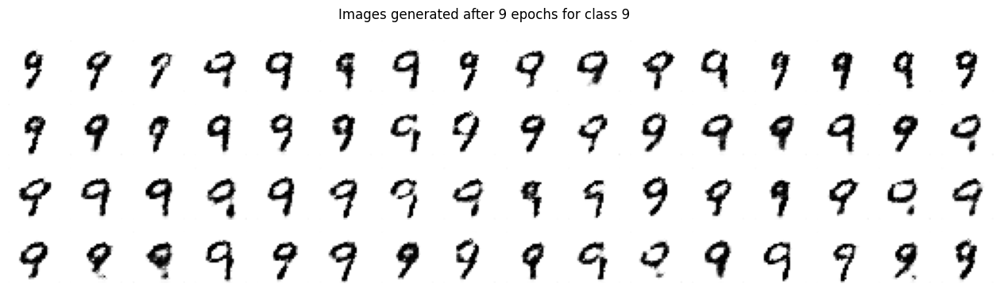

54/54 [==============================] - 11s 205ms/step - discriminator_loss: 0.5467 - generator_loss: 1.1545
Epoch 10/50
54/54 [==============================] - 10s 188ms/step - discriminator_loss: 0.5647 - generator_loss: 1.1247
Epoch 11/50
54/54 [==============================] - 10s 188ms/step - discriminator_loss: 0.5960 - generator_loss: 1.0830
Epoch 12/50
54/54 [==============================] - ETA: 0s - discriminator_loss: 0.6010 - generator_loss: 1.0313

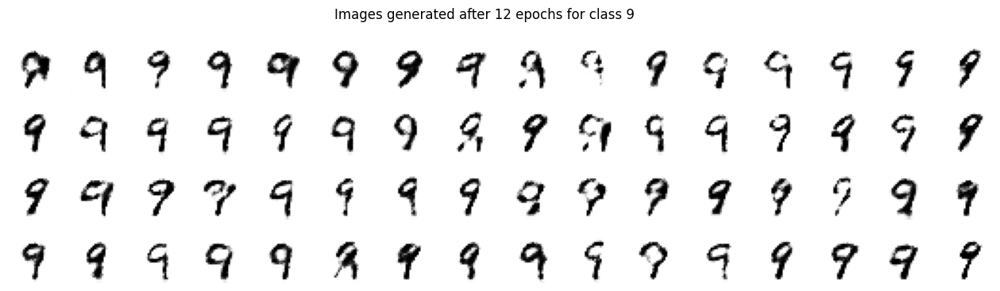

54/54 [==============================] - 11s 207ms/step - discriminator_loss: 0.6010 - generator_loss: 1.0313
Epoch 13/50
54/54 [==============================] - 10s 188ms/step - discriminator_loss: 0.6176 - generator_loss: 1.0027
Epoch 14/50
54/54 [==============================] - 10s 188ms/step - discriminator_loss: 0.6089 - generator_loss: 1.0356
Epoch 15/50
54/54 [==============================] - ETA: 0s - discriminator_loss: 0.5994 - generator_loss: 0.9953

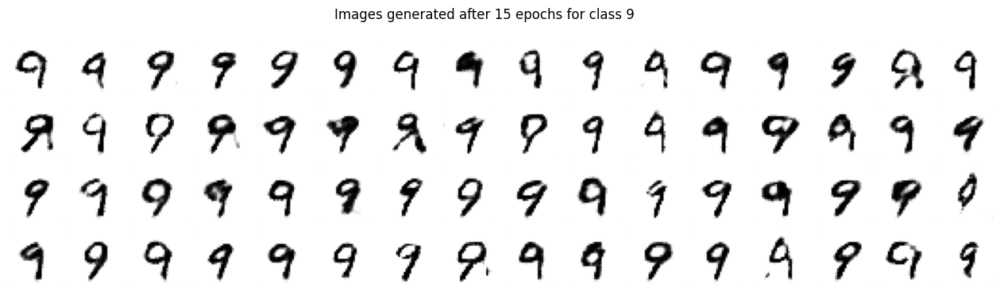

54/54 [==============================] - 11s 206ms/step - discriminator_loss: 0.5994 - generator_loss: 0.9953
Epoch 16/50
54/54 [==============================] - 10s 188ms/step - discriminator_loss: 0.6138 - generator_loss: 0.9520
Epoch 17/50
54/54 [==============================] - 10s 187ms/step - discriminator_loss: 0.6056 - generator_loss: 0.9877
Epoch 18/50
54/54 [==============================] - ETA: 0s - discriminator_loss: 0.6315 - generator_loss: 0.9752

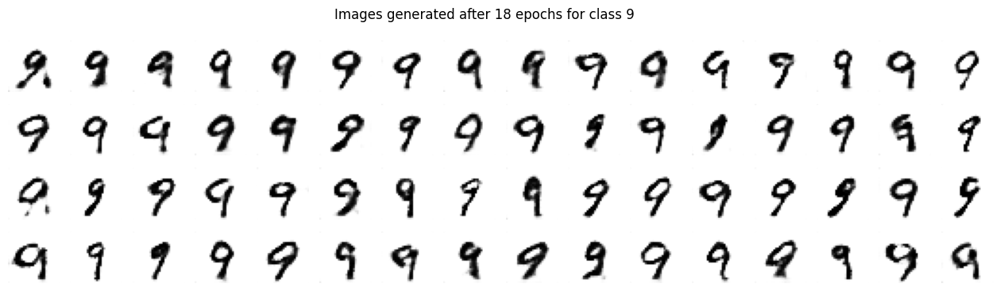

54/54 [==============================] - 11s 204ms/step - discriminator_loss: 0.6315 - generator_loss: 0.9752
Epoch 19/50
54/54 [==============================] - 10s 188ms/step - discriminator_loss: 0.6297 - generator_loss: 0.9266
Epoch 20/50
54/54 [==============================] - 10s 188ms/step - discriminator_loss: 0.6256 - generator_loss: 0.9150
Epoch 21/50
54/54 [==============================] - ETA: 0s - discriminator_loss: 0.6433 - generator_loss: 0.9329

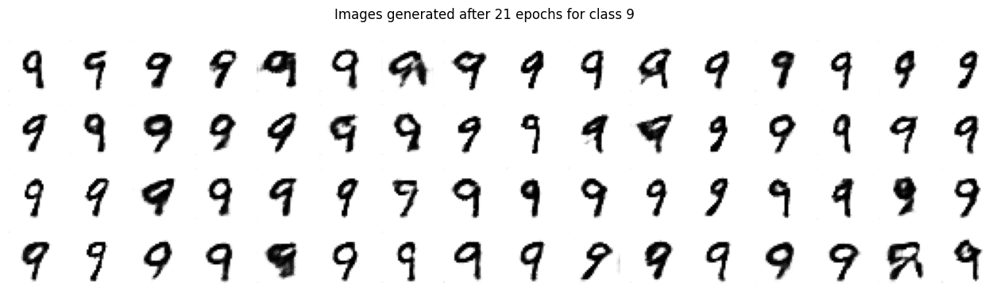

54/54 [==============================] - 11s 207ms/step - discriminator_loss: 0.6433 - generator_loss: 0.9329
Epoch 22/50
54/54 [==============================] - 10s 187ms/step - discriminator_loss: 0.6330 - generator_loss: 0.9396
Epoch 23/50
54/54 [==============================] - 10s 188ms/step - discriminator_loss: 0.6344 - generator_loss: 0.9195
Epoch 24/50
54/54 [==============================] - ETA: 0s - discriminator_loss: 0.6275 - generator_loss: 0.9383

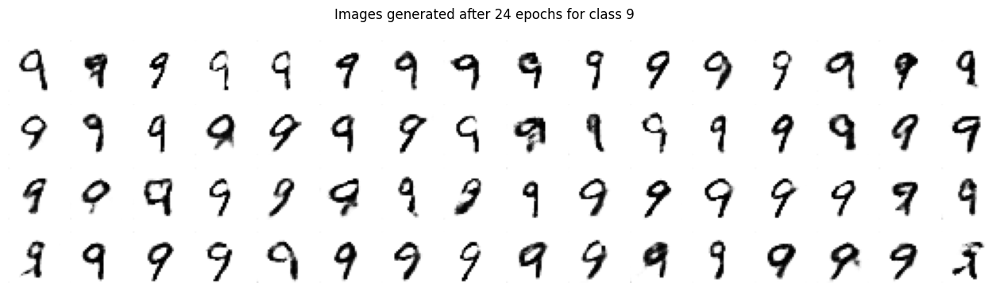

54/54 [==============================] - 11s 204ms/step - discriminator_loss: 0.6275 - generator_loss: 0.9383
Epoch 25/50
54/54 [==============================] - 10s 190ms/step - discriminator_loss: 0.6329 - generator_loss: 0.9332
Epoch 26/50
54/54 [==============================] - 10s 188ms/step - discriminator_loss: 0.6286 - generator_loss: 0.9368
Epoch 27/50
54/54 [==============================] - ETA: 0s - discriminator_loss: 0.6364 - generator_loss: 0.9403

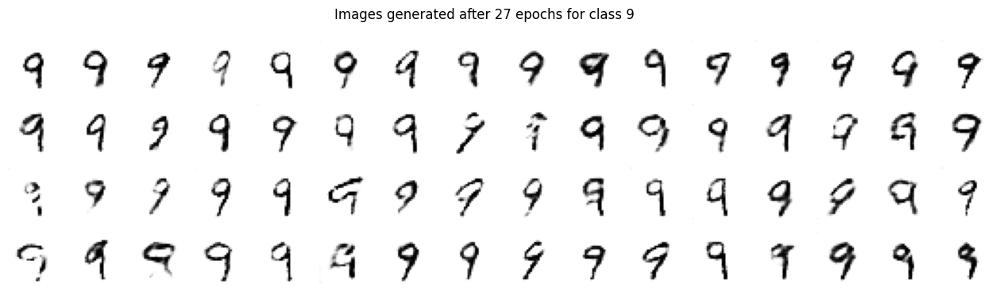

54/54 [==============================] - 11s 207ms/step - discriminator_loss: 0.6364 - generator_loss: 0.9403
Epoch 28/50
54/54 [==============================] - 10s 188ms/step - discriminator_loss: 0.6361 - generator_loss: 0.9539
Epoch 29/50
54/54 [==============================] - 10s 187ms/step - discriminator_loss: 0.6308 - generator_loss: 0.9274
Epoch 30/50
54/54 [==============================] - ETA: 0s - discriminator_loss: 0.6322 - generator_loss: 0.9678

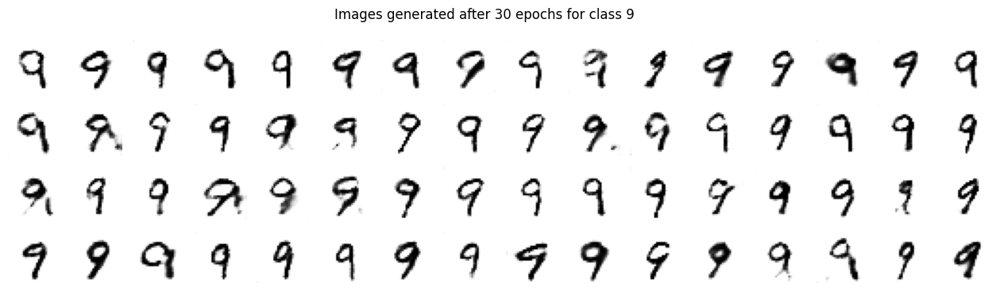

54/54 [==============================] - 11s 204ms/step - discriminator_loss: 0.6322 - generator_loss: 0.9678
Epoch 31/50
54/54 [==============================] - 10s 188ms/step - discriminator_loss: 0.6319 - generator_loss: 0.9174
Epoch 32/50
54/54 [==============================] - 10s 188ms/step - discriminator_loss: 0.6332 - generator_loss: 0.9284
Epoch 33/50
54/54 [==============================] - ETA: 0s - discriminator_loss: 0.6377 - generator_loss: 0.9409

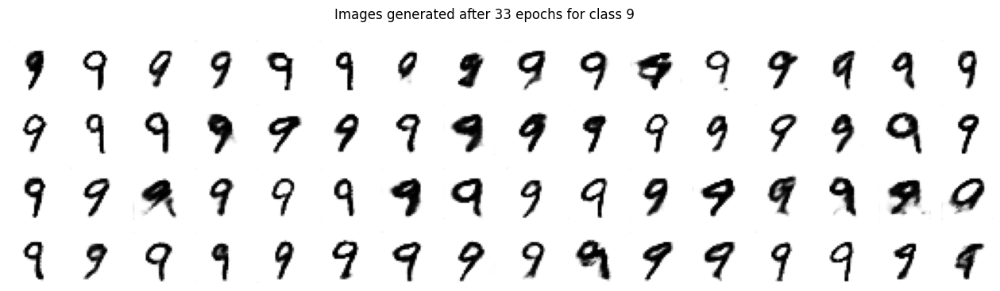

54/54 [==============================] - 11s 204ms/step - discriminator_loss: 0.6377 - generator_loss: 0.9409
Epoch 34/50
54/54 [==============================] - 10s 187ms/step - discriminator_loss: 0.6350 - generator_loss: 0.9371
Epoch 35/50
54/54 [==============================] - 10s 188ms/step - discriminator_loss: 0.6327 - generator_loss: 0.9641
Epoch 36/50
54/54 [==============================] - ETA: 0s - discriminator_loss: 0.6409 - generator_loss: 0.9570

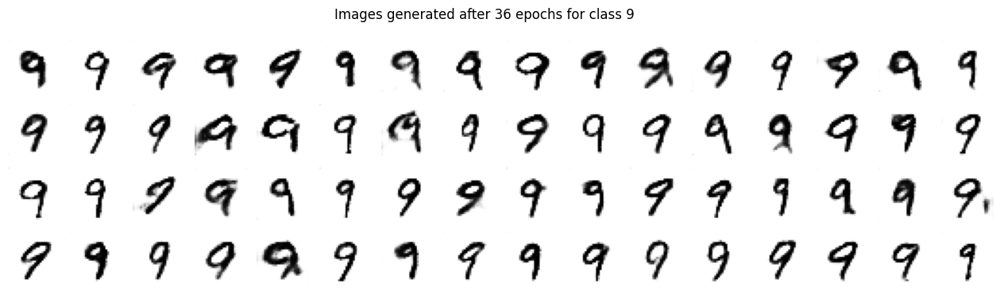

54/54 [==============================] - 11s 205ms/step - discriminator_loss: 0.6409 - generator_loss: 0.9570
Epoch 37/50
54/54 [==============================] - 10s 188ms/step - discriminator_loss: 0.6334 - generator_loss: 0.9517
Epoch 38/50
54/54 [==============================] - 10s 189ms/step - discriminator_loss: 0.6406 - generator_loss: 0.9620
Epoch 39/50
54/54 [==============================] - ETA: 0s - discriminator_loss: 0.6335 - generator_loss: 0.9485

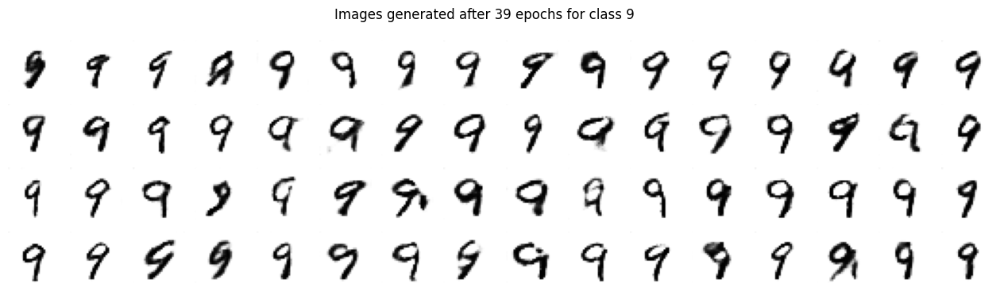

54/54 [==============================] - 11s 204ms/step - discriminator_loss: 0.6335 - generator_loss: 0.9485
Epoch 40/50
54/54 [==============================] - 10s 187ms/step - discriminator_loss: 0.6360 - generator_loss: 0.9429
Epoch 41/50
54/54 [==============================] - 10s 188ms/step - discriminator_loss: 0.6368 - generator_loss: 0.9542
Epoch 42/50
54/54 [==============================] - ETA: 0s - discriminator_loss: 0.6343 - generator_loss: 0.9513

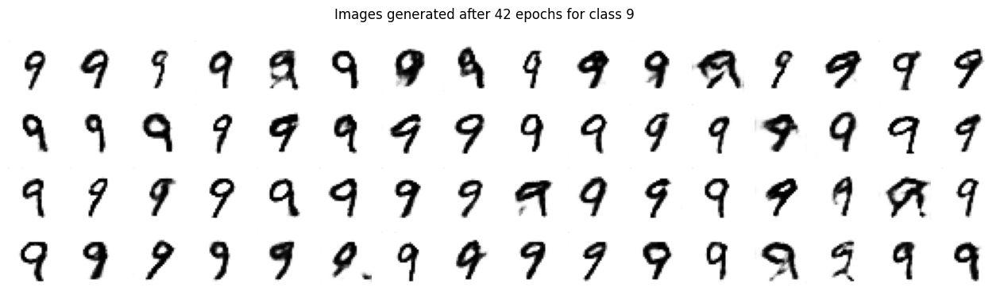

54/54 [==============================] - 11s 204ms/step - discriminator_loss: 0.6343 - generator_loss: 0.9513
Epoch 43/50
54/54 [==============================] - 10s 187ms/step - discriminator_loss: 0.6348 - generator_loss: 0.9595
Epoch 44/50
54/54 [==============================] - 10s 188ms/step - discriminator_loss: 0.6278 - generator_loss: 0.9572
Epoch 45/50
54/54 [==============================] - ETA: 0s - discriminator_loss: 0.6269 - generator_loss: 0.9514

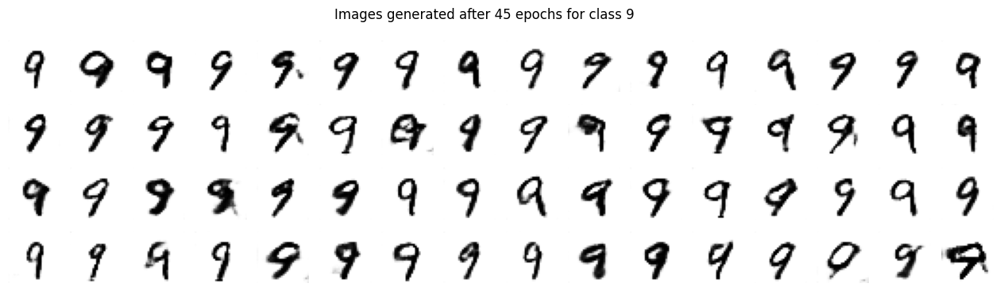

54/54 [==============================] - 11s 204ms/step - discriminator_loss: 0.6269 - generator_loss: 0.9514
Epoch 46/50
54/54 [==============================] - 10s 188ms/step - discriminator_loss: 0.6330 - generator_loss: 0.9747
Epoch 47/50
54/54 [==============================] - 10s 187ms/step - discriminator_loss: 0.6263 - generator_loss: 0.9397
Epoch 48/50
54/54 [==============================] - ETA: 0s - discriminator_loss: 0.6285 - generator_loss: 0.9376

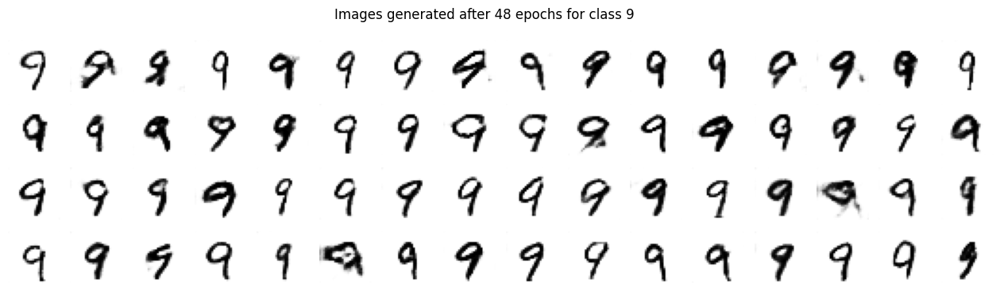

54/54 [==============================] - 11s 203ms/step - discriminator_loss: 0.6285 - generator_loss: 0.9376
Epoch 49/50
54/54 [==============================] - 10s 187ms/step - discriminator_loss: 0.6306 - generator_loss: 0.9540
Epoch 50/50
54/54 [==============================] - 10s 189ms/step - discriminator_loss: 0.6368 - generator_loss: 0.9929


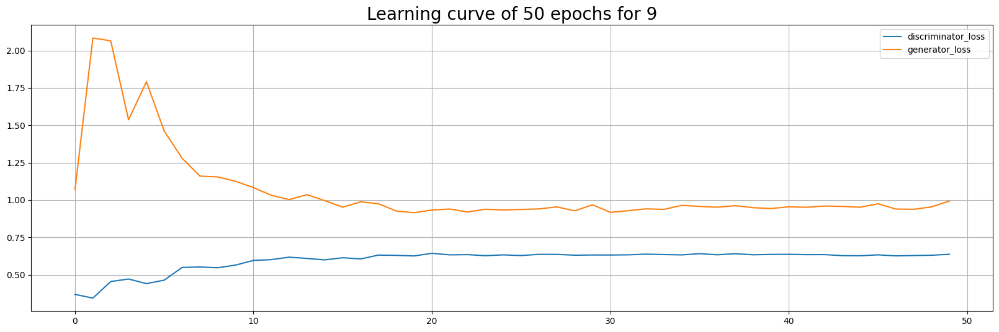

In [12]:
for i in range(10):
    dataset = prepare_mnist_batch(x_train, y_train, i, BATCH_SIZE)
    
    generator = build_generator() 
    discriminator = build_discriminator()
    
    gan = DCGAN(
        discriminator = discriminator, generator=generator, 
        latent_dim = NOISE_SIZE
    )
    
    gan.compile(
        discriminator_optimizer = Adam(0.0002, 0.5),
        generator_optimizer = Adam(0.0002, 0.5),
        loss_fn = keras.losses.BinaryCrossentropy(),
    )
    
    history = gan.fit(dataset, epochs = EPOCHS, verbose=1, callbacks = [save_imgs()])
    
    fig, ax = plt.subplots(figsize = (20, 6))
    ax.set_title('Learning curve of {} epochs for {}'.format(EPOCHS, i), fontsize = 20)
    pd.DataFrame(history.history).plot(ax = ax)
    ax.grid()
       
    generator.save('mnist_dcgan_{}_{}.h5'.format(EPOCHS, i))

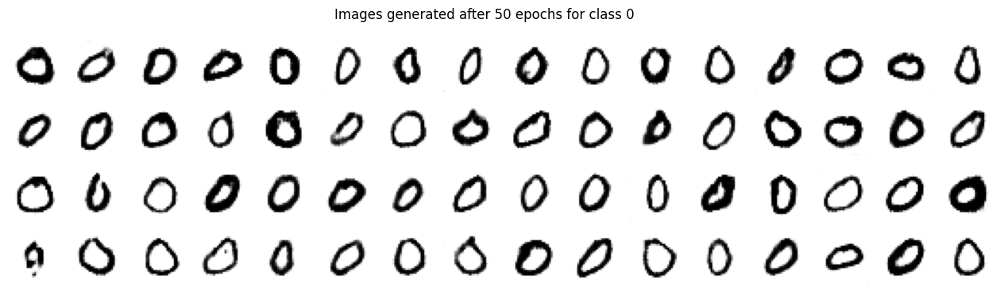

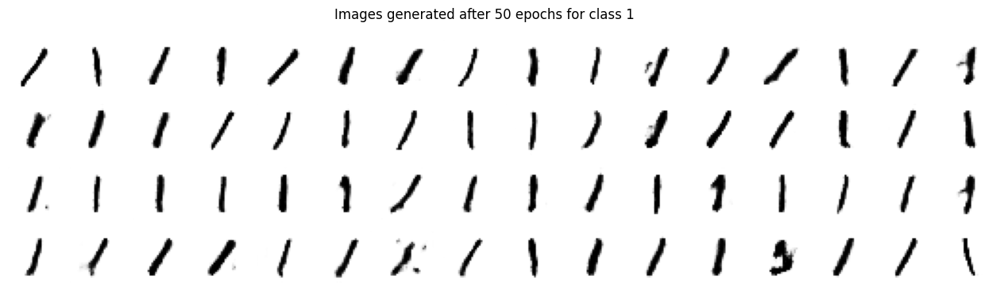

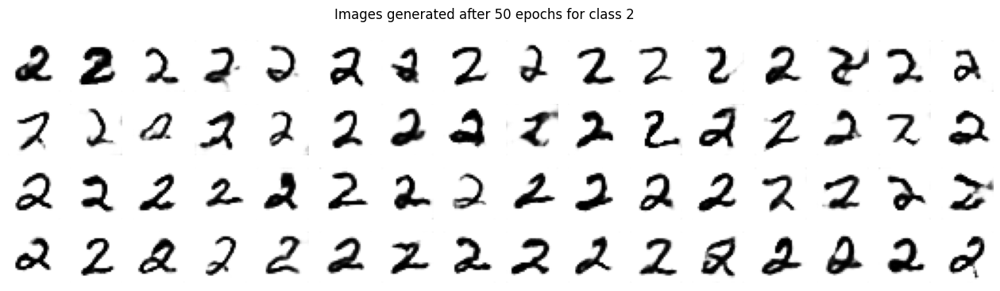

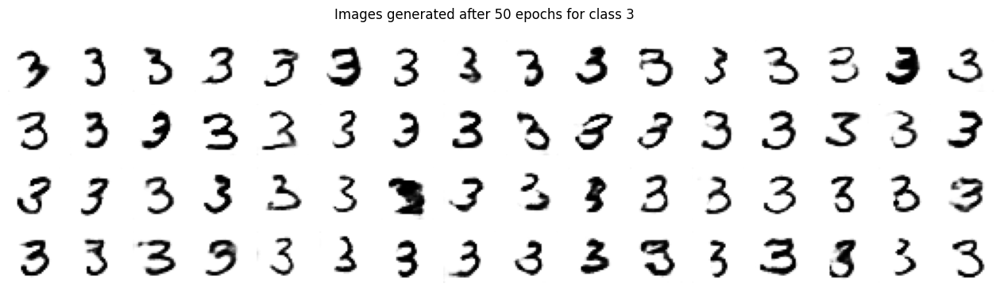

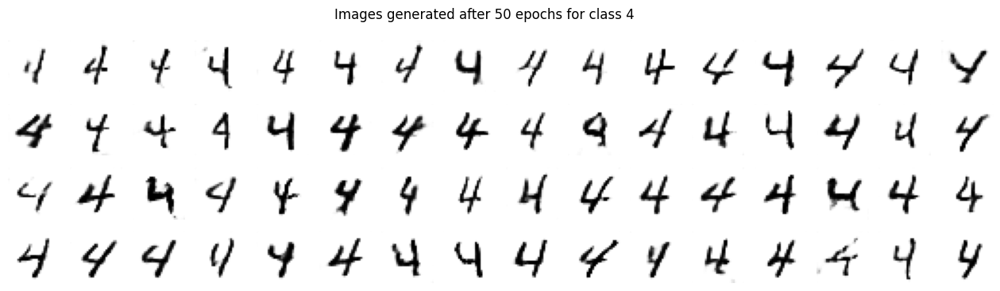

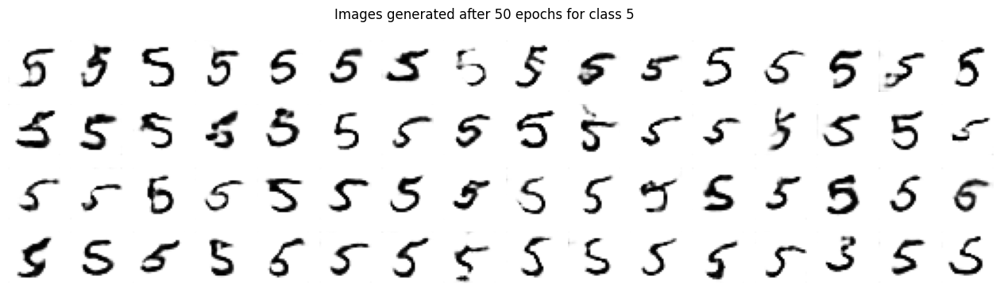

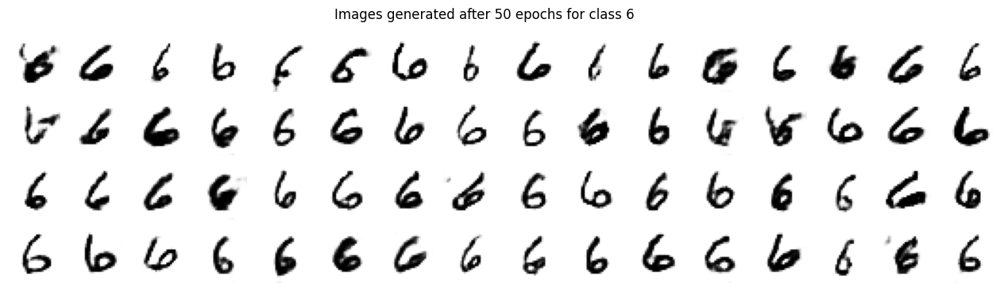

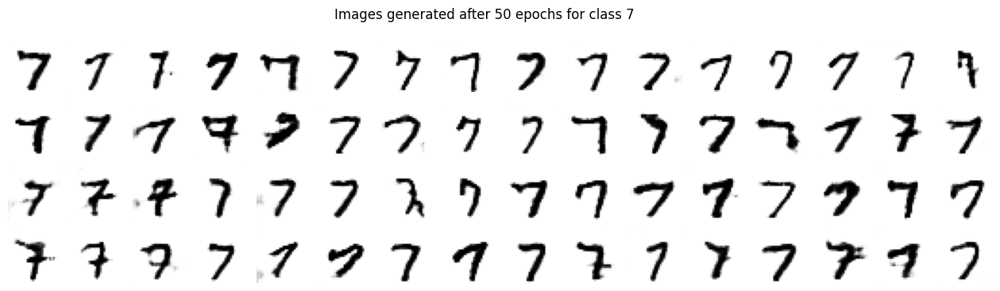

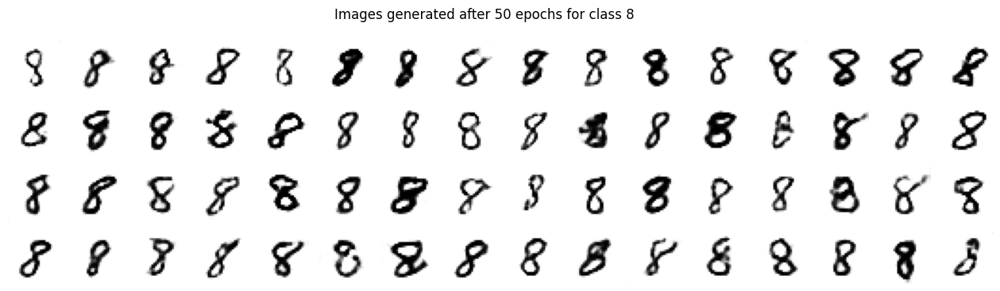

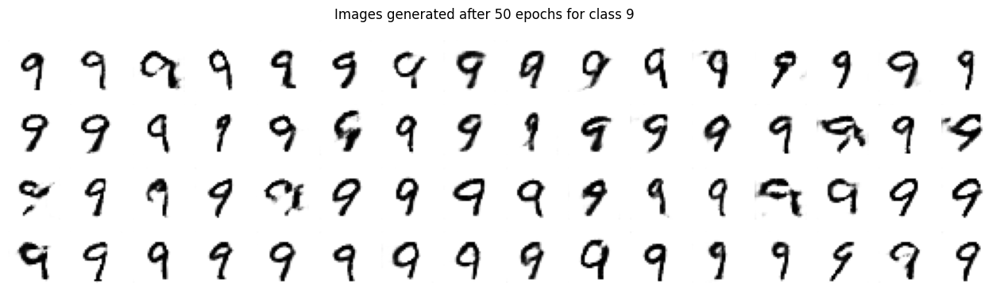

In [13]:
for i in range(10):
    generator = load_model('mnist_dcgan_{}_{}.h5'.format(EPOCHS, i), compile = False)
    fake_images = generator(tf.random.normal([64, NOISE_SIZE]))
    show_images(fake_images, 16, 'Images generated after {} epochs for class {}'.format(EPOCHS, i), "res_gen_imgs_{}_{}".format(i, EPOCHS))
    plt.show()